In [2]:
# ------------------------------------------#
#        Expt 5: Perform a battery of negative inference tests from a single script and plot results, save metadata    
# ------------------------------------------#

Threads.nthreads()
begin
    using LinearAlgebra 
    using Plots
    using FFTW
    using FileIO
    using JLD2
    using DiffEqFlux
    using OrdinaryDiffEq
    using BlockArrays
    using LaTeXStrings
    using SparseArrays
    using BSON
    using Distances
    using DifferentialEquations
    using Optimization
    using OptimizationPolyalgorithms
    using Zygote
    using OptimizationOptimJL
    using OptimizationOptimisers
    using DiffEqSensitivity
    using DelimitedFiles
    using HDF5
    using InvertedIndices
    using Random
    using Statistics
    using DiffEqCallbacks
    using Test
    using ChainRulesCore
    using LineSearches
    using CSV
    using DataFrames
    using Smoothers
end 

In [3]:
filename = "/home/tschala/research/LANL/case1_1_1D_waveforms_results.h5"
file = h5open(filename, "r")
# Read the dataset
data1d = read(file["data"])

# Close the file
close(file)

In [4]:
println("Size of 1D data matrix:",size(data1d))
println("Shape: [timesteps,spatial locations,waveforms,variables]")

# note that some elements in space a duplicate
# the real spatial size is 100

Size of 1D data matrix:(300, 110, 47, 4)
Shape: [timesteps,spatial locations,waveforms,variables]


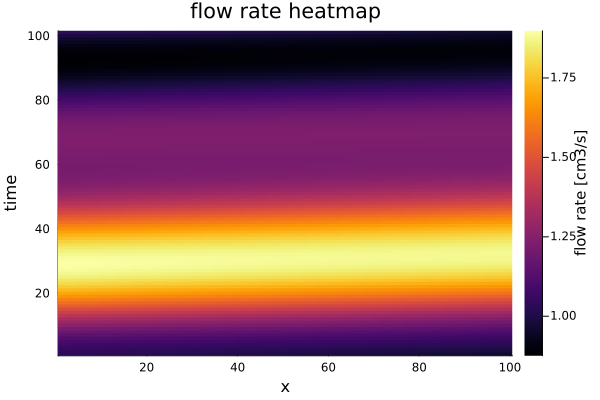

In [5]:
# remove duplicate data (both ends of a segment are saved)
data1d_fix = data1d[200:end,Not(11:11:end),:,:];
# remove the unphysical peaks, just replace with linear interpolation
data1d_fix[:,41,:,1] = (data1d_fix[:,40,:,1] + data1d_fix[:,42,:,1])/2;
data1d_fix[:,61,:,1] = (data1d_fix[:,60,:,1] + data1d_fix[:,62,:,1])/2;
heatmap(data1d_fix[:,:,20,1], title="flow rate heatmap", cbar_title = "flow rate [cm3/s]")
xlabel!("x")
ylabel!("time")


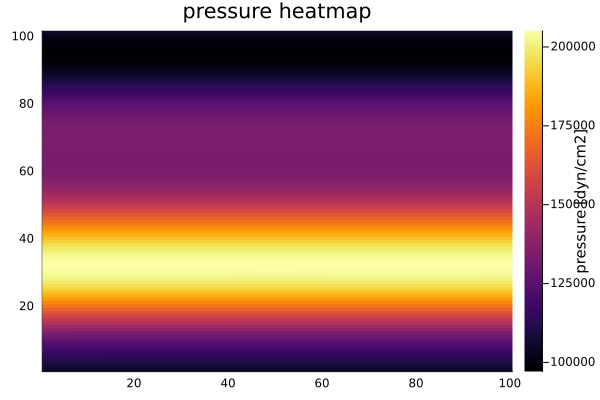

In [6]:
heatmap(data1d_fix[1:end,:,20,2], title="pressure heatmap", cbar_title = "pressure [dyn/cm2]")

In [7]:
begin
    global dt = 0.001                   # time step, has to be smaller or equal to saveat
    global T = 1.0                   # total time
    global saveat = 0.01                #ground truth data time resolution
    global tsteps = 0.0:dt:T             # discretized time dimension
    global tspan = (0,T)                 # end points of time integration for ODEProbem
    global L = 4.0                       # total length of 1d sim
    global train_maxiters = 5         # number of iterations of learning
    global learning_rate  = 0.01         # learning rate , currently using PolyOpt default (0.1)


end

0.01

In [8]:
#waveforms to use
waveforms = 30


# Set the seed for reproducibility
Random.seed!(123)

# # # Shuffle the indices of the vector
# shuffled_indices = randperm(size(data1d_fix)[3])

# # # Divide the shuffled indices into training and test sets
# train_indices = shuffled_indices[1:waveforms];
# test_indices = shuffled_indices[waveforms+1:end];

# Shuffle the indices of the vector
shuffled_indices = 1:47

# Divide the shuffled indices into training and test sets
train_indices = [shuffled_indices[7:24];shuffled_indices[31:41]];
test_indices = shuffled_indices[25:30];
test_indices_ex = [shuffled_indices[1:6];shuffled_indices[42:end]];

# select field variable ID
# 1 - flow rate, 2 - pressure, 3 - area, 4 - Wall Shear Stress
pID = 1

1

In [9]:
#define IC's
u0 = data1d_fix[1,1:end,train_indices,pID];
u01 = data1d_fix[1,1:end,1,pID];

u0_test = data1d_fix[1,1:end,test_indices,pID];
u0_ex = data1d_fix[1,1:end,test_indices_ex,pID];

#ground truth data
ytrain2 = data1d_fix[:,1:end,train_indices,pID];
ytrain21 = data1d_fix[:,1:end,1,pID];

ytest2 = data1d_fix[:,1:end,test_indices,pID];
yex2 = data1d_fix[:,1:end,test_indices_ex,pID];

#boundary conditions
bc_flow = data1d_fix[:,1,train_indices,pID];
bc_flow1 = bc_flow[:,1];

bc_flow_test = data1d_fix[:,1,test_indices,pID];
bc_flow_ex  = data1d_fix[:,1,test_indices_ex,pID];

aID = 3
#ground truth data for area
Atrain = data1d_fix[:,1:end,train_indices,aID];
Atrain1 = data1d_fix[:,1:end,1,aID];

Atest = data1d_fix[:,1:end,test_indices,aID];
Aex = data1d_fix[:,1:end,test_indices_ex,aID];

presID = 2
#ground truth data for pressure
ptrain = data1d_fix[:,1:end,train_indices,presID];
ptrain1 = data1d_fix[:,1:end,1,presID];

ptest = data1d_fix[:,1:end,test_indices,presID];
pex = data1d_fix[:,1:end,test_indices_ex,presID];

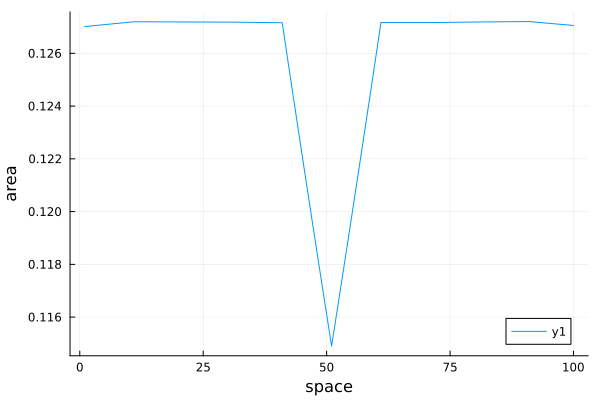

In [10]:
plot(Atrain1[1,:])
xlabel!("space")
ylabel!("area")

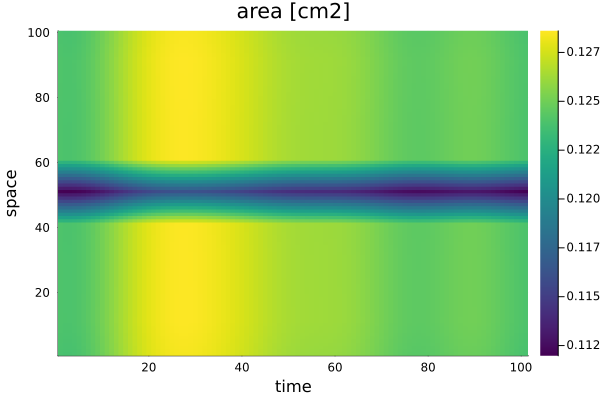

In [26]:
heatmap(Atrain[:,:,10]',color=:viridis)
xlabel!("time")
ylabel!("space")
title!("area [cm2]")
# savefig("example_result_heatmap_area.svg")

In [28]:
minimum(Atrain[:,:,10])

0.111976633486

In [25]:
minimum(ytrain2[:,:,10]')

1.01638152947

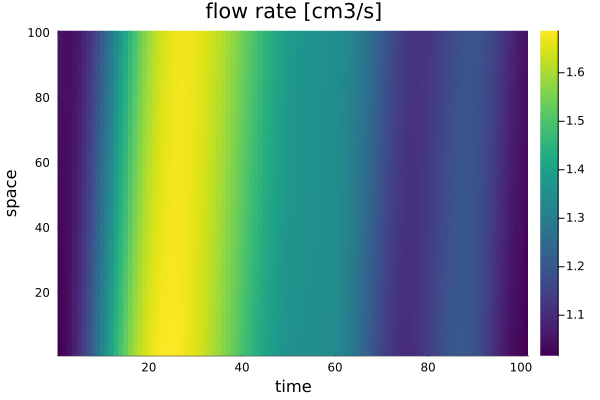

In [18]:
heatmap(ytrain2[:,:,10]',color=:viridis)
xlabel!("time")
ylabel!("space")
title!("flow rate [cm3/s]")

In [19]:
savefig("example_result_heatmap.svg")

"/home/tschala/research/LANL/example_result_heatmap.svg"

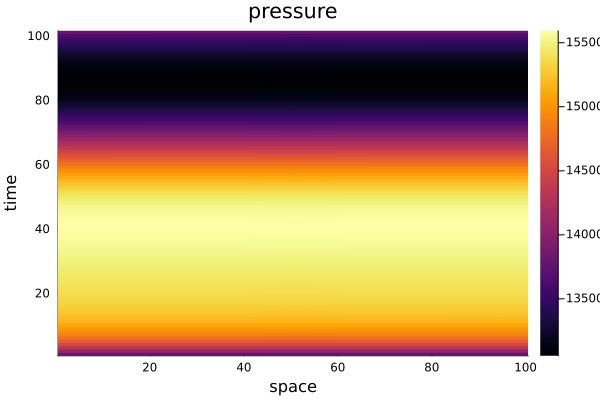

In [11]:
heatmap(ptrain[:,:,1])
xlabel!("space")
ylabel!("time")
title!("pressure")

In [12]:
path_to_working_directory="/home/tschala/research/LANL/juliaDiffProgExample/"

include("$path_to_working_directory/src/numerical_derivatives.jl");
include("$path_to_working_directory/src/train_utils.jl");

In [13]:
N = size(u01,1)
dx = L/N                      # spatial step
x = 0.0 : dx : (L-dx)         # discretized spatial dimension 
# finite-difference schemes

#first order derivatives
∂x1_center = f1_secondOrder_central(N,dx);
∂x1_forward = f1_secondOrder_forward(N,dx);
∂x1_backward = f1_secondOrder_backward(N,dx);

# use central difference for the majority
∂x1 = ∂x1_center
# use forward and backward difference near the boundaries
∂x1[1,:]=∂x1_forward[1,:]
∂x1[end,:] = ∂x1_backward[end,:]

#second order derivatives
∂x2_center = f2_secondOrder_central(N,dx);
∂x2_forward = f2_secondOrder_forward(N,dx);
∂x2_backward = f2_secondOrder_backward(N,dx);

# use central difference for the majority
∂x2 = ∂x2_center;
# use forward and backward difference near the boundaries
∂x2[1,:]=∂x2_forward[1,:];
∂x2[end,:] = ∂x2_backward[end,:];

In [14]:

# NN embedded in PDE for Differential programming
# Define the network architecture with initialization
hidden_dim = 10

ann = Chain(
    Dense(N, hidden_dim, tanh, init = Flux.glorot_uniform),
    Dense(hidden_dim, hidden_dim, tanh, init = Flux.glorot_uniform),
    Dense(hidden_dim, hidden_dim, tanh, init = Flux.glorot_uniform),
    Dense(hidden_dim, N, init = Flux.glorot_uniform)
)

Chain(
  Dense(100 => 10, tanh),               # 1_010 parameters
  Dense(10 => 10, tanh),                # 110 parameters
  Dense(10 => 10, tanh),                # 110 parameters
  Dense(10 => 100),                     # 1_100 parameters
)                   # Total: 8 arrays, 2_330 parameters, 9.602 KiB.

In [15]:
# flatten parameters in NN for learning.                
p, re = Flux.destructure(ann);
ps = deepcopy(p)
p_size = size(p,1);
println("Number of parameters in neural network: $p_size"); 

Number of parameters in neural network: 2330


In [16]:
δ = 1/3;  #profile parameters
ν = 0.04; # viscosity in CGS
ρ = 1.06; #density in CGS
Nprof = -8*π*ν;  #profile parameters

In [17]:
# # Define time-dependent variables
function interpolate_variables(t, vector)
    # t - dependent variable, could be time or space (z) too
    #      if t is time then use dt, if it's space use dz, same with T <--> L
    # vector - data vector with values at distinct t locations
    #
    # This function interpolates values such that we can access the values from vector
    # not just at the original data points but anywhere in between
    

    # Find the two closest points in vector
    #caculate the time index that's closest to time t

    t_index = Int(floor(t / saveat)) + 1

    # calculate local time fraction between the grid points
    t_frac = (t - (t_index - 1) * saveat) / saveat

    # Perform linear interpolation between data points in vector
    # if we are at the last timesteps just copy the value cause t_index+1 will not exist
    
    if t == T
        vector_interp = vector[:,:,t_index]
        
    else
        vector_interp = (1 - t_frac) * vector[:,:,t_index] + t_frac * vector[:,:,t_index + 1]
    end
    
    # return the interpolated value of vector at time(space) = t
    return vector_interp
end


# define interpolate function
interp_func(t) = interpolate_variables(t, atrain)

interp_func (generic function with 1 method)

In [43]:
global alpha = 0.0

function learn_1DBlood(u, p, t, S, p_interp_func)
    Φ = re(p)  # restructure flattened parameter vector into NN architecture.
    
    # u - variable we are solving for
    # p - parameters
    # t - time
    # S - area
    #p_interp_func - interpolates pressure to current t
    
    # omit the pressure term for now:  - interp_func(t) ./ ρ .* (∂x1 * p_interp_func(t)) 
    #- (1+δ) .* (∂x1* ((u .^ 2) ./ interp_func(t))) + Nprof .* u ./ interp_func(t) + ν .* (∂x2*u)
    
    
    # write out each term for debugging
#     if isapprox(t%0.1,0.0, atol = 1e-3)
#         println("time t: ", t)
#         println("advection term d/dz(Q^2/S): ", sum((1+δ) .* (∂x1* ((u .^ 2) ./ interp_func(t)))))
#         println("viscous resistance N*Q/S: ", sum(Nprof .* u ./ interp_func(t)))
#         println("Diffusion: nu*d^2Q/dz^2: ", sum(ν .* (∂x2*u)))
#         println("Mean area S: ", mean(interp_func(t)))
#         println("Mean Previous flow rate Q:", mean(u), ", std Q:", std(u))
#         println("Mean Q^2/S:", mean((u .* u) ./ interp_func(t)))
#         println("dp/dz term: ", sum(- interp_func(t) ./ ρ .* (∂x1 * p_interp_func(t))))
#         println("%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%")
#         flush(stdout)
#     end
    
#     plotQ = plot(u)
#     display(plot(plotQ))
#     sleep(1)
    
    #construct ODE    
    return Φ(u) - alpha .* (1+δ) .* (∂x1* ((u .^ 2) ./ S))
end

learn_1DBlood (generic function with 1 method)

In [35]:
# if RK4 - then uses the self-implemented RK4
# if Tsit5 - uses callback
# at the moment both crash :(
ode_solver = "RK4"
output_dir = "/home/tschala/research/LANL/some_physics_testNODE"
working_dir = output_dir

"/home/tschala/research/LANL/some_physics_testNODE"

In [36]:
#define convolutional layer for moving averages
weight = ones(3, 1, 1)./3;

bias = zeros(1);

pad_value = 100
pad = (pad_value, pad_value)

# Create the convolutional layer with padding
layer = Conv(weight, bias, identity, pad = 1)



Conv((3,), 1 => 1, pad=1)  # 4 parameters

In [37]:
# Runge-Kutta solver
function rk4_solve_1step(prob, θ, dt,tf,u0, S)
    # set initial condition
    u = u0
    # set problem right-hands side function
    f = prob.f
    
    # set initial time, one step before the final time
    ti = tf-dt
    
#     println("ti: ",ti)
    
#     println("size S:", size(S))
#     println("Size u:", size(u))
    
    #calculate Runge-Kutta step
    k1 = f(u, θ, ti, S)
    k2 = f(u .+ dt/2 .* k1, θ, ti + dt/2, S)
    k3 = f(u .+ dt/2 .* k2, θ, ti + dt/2, S)
    k4 = f(u .+ dt .* k3, θ, ti + dt, S)

    u_new = u .+ dt/6 .* (k1 .+ 2*k2 .+ 2*k3 .+ k4)
    
    return u_new
end


rk4_solve_1step (generic function with 1 method)

In [50]:
function loss(θ, ytrain21, prob,bc_left, atrain1)
    # solve system and calculate loss
    
    # θ - NN parameters
    # ytrain21 - ground truth data - shape: [space, batch, time]
    # prob - ODE problem formulation
    # bc_left - time-dependent BC
    # atrain1 - ground truth area data - shape [space, batch, time]
    
    # list for saving results
    pred = []
#     pred_S = []
    
    # initialize loss
    loss = 0.0
    
    # get the time span from the problem setup
    t0, tf = prob.tspan
    
    # get initial conditions
    global u0 = prob.u0

    S0 = atrain1[:,:,1]
    
    
    # save IC to list
    # MUST ignore gradients, otherwise mutation will occur
    # push creates mutation if derivatives are not ignored
    @ignore_derivatives push!(pred, u0)
    @ignore_derivatives push!(pred, S0)
    
    # calculate number of timesteps required
    num_steps = Int(round((tf - t0) / dt))
    
    # timestep loop
    for i in 1:num_steps
        # integrate one timestep at a time to avoid mutating arrays
        
        # set final time to 1 timestep ahead
        tf = dt*i
        
        # solve for Q
        # solve 1 time-step
        u_new = rk4_solve_1step(prob, θ, dt,tf,u0, S0)
        

        
        # apply inlet boundary condition
        bc_zeros = zeros(1,size(u0)[2])
        # create matrix which is 1 everywhere but 0 at the BC
        multiply = Float32.(vcat(bc_zeros,ones(size(u0)[1]-1,size(u0)[2])))
        
        # interpolate BC to current time step
        t_index = Int(floor(tf / saveat)) + 1

        # calculate local time fraction between the grid points
        t_frac = (tf - (t_index - 1) * saveat) / saveat

        # Perform linear interpolation between data points in vector
        # if we are at the last timesteps just copy the value cause t_index+1 will not exist
        if tf == T
            bc_interp = bc_left[t_index,:]
        else
            bc_interp = (1 - t_frac) * bc_left[t_index,:] + t_frac * bc_left[t_index + 1, :]
        end
        
        # create matrix that is zero everywhere except the BC, where it is the BC
        add = Float32.(vcat(reshape(bc_interp,1,size(bc_left)[2]),zeros(size(u0)[1]-1,size(u0)[2])))
        
        # set the new initial condition
        # use copy to avoid mutating arrays
        # apply BC by multiplying and adding, this is just a way to overcome mutation
        
        
        #apply moving average smoothing with convolutional kernel
        smoothing_flag = true
        
        if smoothing_flag
            ushaped = reshape(u_new[:,:],size(u_new)[1],1,size(u_new)[2])
            uavg = reshape(layer(ushaped),size(ushaped)[1],size(ushaped)[3])
            
            # apply inlet boundary condition
            # for the outlet don't use the smoothed value, but the one from u_new
            # the conv kernel has zero padding, so it would create problems at the outlet
            # the inlet is overwritten by the BC anyway, so it doesn't matter
            bc_zeros = zeros(1,size(u0)[2])
            # create matrix which is 1 everywhere but 0 at the BCs
            multiply = Float32.(vcat(bc_zeros,ones(size(u0)[1]-2,size(u0)[2]),bc_zeros))

            # interpolate BC to current time step
            t_index = Int(floor(tf / saveat)) + 1

            # calculate local time fraction between the grid points
            t_frac = (tf - (t_index - 1) * saveat) / saveat

            # Perform linear interpolation between data points in vector
            # if we are at the last timesteps just copy the value cause t_index+1 will not exist
            if tf == T
                bc_interp = bc_left[t_index,:]
            else
                bc_interp = (1 - t_frac) * bc_left[t_index,:] + t_frac * bc_left[t_index + 1, :]
            end

            # create matrix that is zero everywhere except the BC, where it is the BC
            add = Float32.(vcat(reshape(bc_interp,1,size(bc_left)[2]),zeros(size(u0)[1]-2,size(u0)[2]),reshape(u_new[end,:],1,size(bc_left)[2])))
            
            
            u0 = copy(uavg).*multiply.+add
        else
            #if no smoothing, just apply boundary conditions
            
            # apply inlet boundary condition
            bc_zeros = zeros(1,size(u0)[2])
            # create matrix which is 1 everywhere but 0 at the BC
            multiply = Float32.(vcat(bc_zeros,ones(size(u0)[1]-1,size(u0)[2])))

            # interpolate BC to current time step
            t_index = Int(floor(tf / saveat)) + 1

            # calculate local time fraction between the grid points
            t_frac = (tf - (t_index - 1) * saveat) / saveat

            # Perform linear interpolation between data points in vector
            # if we are at the last timesteps just copy the value cause t_index+1 will not exist
            if tf == T
                bc_interp = bc_left[t_index,:]
            else
                bc_interp = (1 - t_frac) * bc_left[t_index,:] + t_frac * bc_left[t_index + 1, :]
            end

            # create matrix that is zero everywhere except the BC, where it is the BC
            add = Float32.(vcat(reshape(bc_interp,1,size(bc_left)[2]),zeros(size(u0)[1]-1,size(u0)[2])))

            
            u0 = copy(u_new).*multiply.+add

        end
        
        #@ignore_derivatives display(plot([u0[:,1],u_new[:,1]]))
        #sleep(1)
        
        # solve for S
        #tspan and pp are just dummy variables here, rk4_solve_1step doesnt use them     
        pp = 1.0
        # doesn't actually use S and pp, 
        prob_S = ODEProblem((s,pp,t,S) -> - ∂x1 * u0 , S0, tspan, pp);
        
        #just pass 1 as parameters and S
        s_new = rk4_solve_1step(prob_S, 1.0, dt,tf, S0, 1.0)
    

    
        S0 = copy(s_new)
        
        # calculate the loss when time is the same as the ground truth
        # saveat is the time resolution of the ground truth data
        t_ratio = saveat/dt
        if isapprox(i % t_ratio, 0.0, atol=1e-6)
            # calculate index corresponding to time in the ground truth data
            index = Int(round(i /t_ratio))
            # cumulate the loss
            # sum(abs2, S0 - atrain1[:,:,index]) + sum(abs2, ∂x1 * u0 - ∂x1 * ytrain21[:, :, index])
            # sum(abs2, u0 - ytrain21[:, :, index]) + sum(abs2, ∂x1 * u0 - ∂x1 * ytrain21[:, :, index])
            dqdz = ∂x1 * u0
            l = sum(abs2, u0 - ytrain21[:, :, index]) + sum(abs2, ∂x1 * u0 - ∂x1 * ytrain21[:, :, index])# + 1e-5*sum(abs2, θ)# + 1e-1*sum(abs,∂x1 * u0)
            loss += l
        end
        
        
        # save result to list, ignore gradients to avoid mutation
        if isapprox(i % t_ratio, 0.0, atol=1e-6)
            @ignore_derivatives push!(pred, u_new)
            @ignore_derivatives push!(pred, s_new)
        end
        
    end
    
    #return the total loss at the end
    return loss, pred
end


# training optimizer definition
adtype = Optimization.AutoZygote() ;

In [51]:
path_checkpoint=nothing
optimizer_choice1 = "ADAM"
optimizer_choice2 = "BFGS"

"BFGS"

In [52]:
# process user choices

if !isdir(working_dir)
    mkdir(working_dir)
end
output_dir = working_dir*"/output/"
cd(working_dir) #switch to working directory
if !isdir(output_dir)
    mkdir(output_dir)
end
println("optimizer 1 is $optimizer_choice1")
if !isnothing(optimizer_choice2)
    println("optimizer 2 is $optimizer_choice2 optimizer")
end

println("ODE Time integrator selected:", ode_solver)


optimizer 1 is ADAM
optimizer 2 is BFGS optimizer
ODE Time integrator selected:RK4


In [53]:
# restart training from previaous checkpoint if it exists, else start 
# fresh training.
transfer_learning = true
global uinit
if transfer_learning
    #load learnt parameters from file
    #p_learn = load("/home/tschala/research/LANL/trained_models/dQdt_1/ptrained_BFGS.jld2")
#     p_learn = load("/home/tschala/research/LANL/trained_models/dQdt_dSdt_TL/ptrained_BFGS.jld2")
    p_learn = load("/home/tschala/research/LANL/trained_models/dQdt_5/ptrained_BFGS.jld2")
    
    uinit = p_learn["p"];
    println("Transfer learning - loaded weights from file")
else
    uinit = deepcopy(ps)
    println("Fresh training initialized")
end

Transfer learning - loaded weights from file


Batch size:10
Start training epoch 1
waveform batch: 1/3
Using ADAM optimizer
Sum of params:86.091644
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 15333.67843098157
Iteration: 2 || Loss: 15037.524939750552
Iteration: 3 || Loss: 14747.487038453124
Iteration: 4 || Loss: 14463.604102100062
Iteration: 5 || Loss: 14185.997176698527
Iteration: 6 || Loss: 14185.997176698527
saving ADAM checkpoint...
Sum of params:86.167305
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 14185.997176698527
Iteration: 2 || Loss: 7656.039062496964
Iteration: 3 || Loss: 6270.287576571456
Iteration: 4 || Loss: 4478.986286692577
Iteration: 5 || Loss: 4158.94132866997
Iteration: 6 || Loss: 3216.7661794602873
Iteration: 7 || Loss: 2749.467075336901
Iteration: 8 || Loss: 2600.8672384813576
Iteration: 9 || Loss: 1995.6431931519135
Iteration: 10 || Loss: 1886.4674449187753
Iteration: 11 || Loss: 1875.7623726068343
saving BFGS checkpoint...
saved trained params to ptr

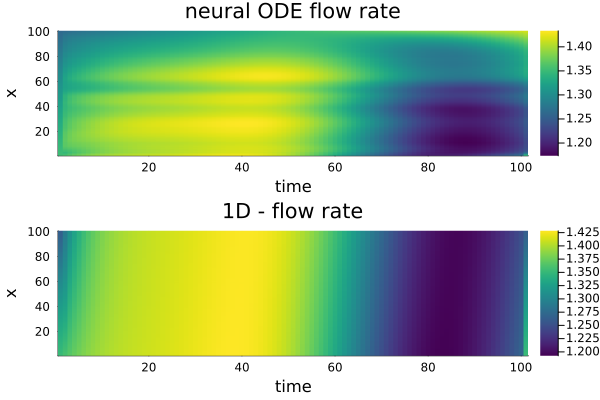

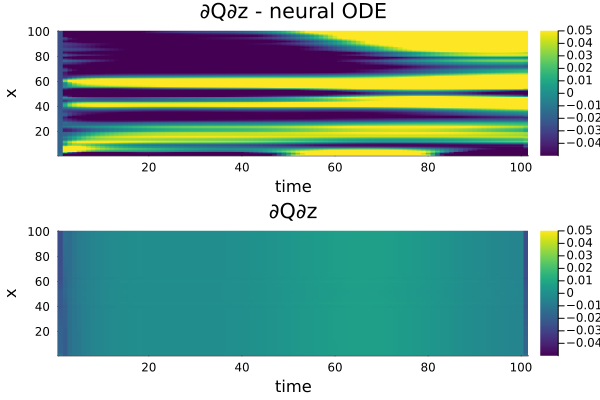

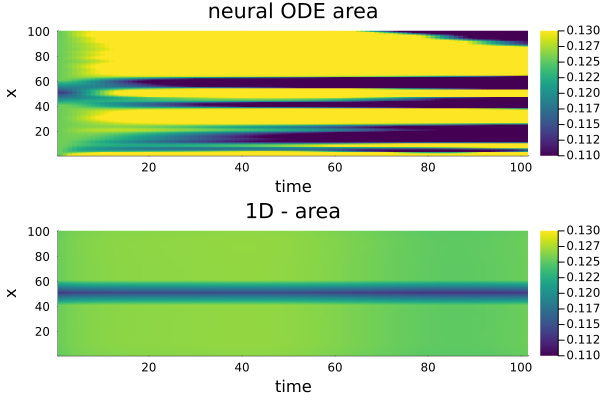

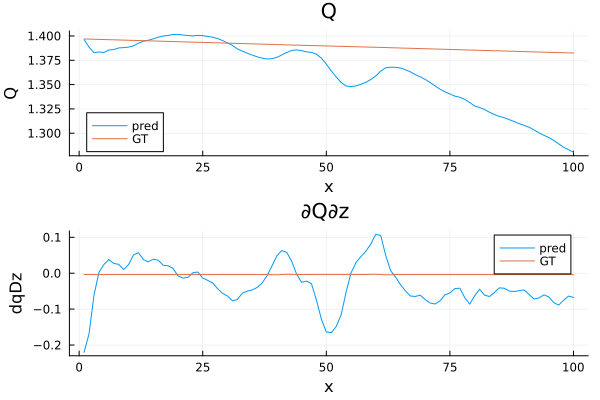

waveform batch: 2/3
Using ADAM optimizer
Sum of params:88.17217
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 8124.247650713138
Iteration: 2 || Loss: 8106.373393965261
Iteration: 3 || Loss: 8089.9716736609835
Iteration: 4 || Loss: 8075.036664852926
Iteration: 5 || Loss: 8061.5358457881675
Iteration: 6 || Loss: 8061.5358457881675
saving ADAM checkpoint...
Sum of params:88.12566
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 8061.5358457881675
Iteration: 2 || Loss: 7880.728949146657
Iteration: 3 || Loss: 7721.649603424875
Iteration: 4 || Loss: 6310.6426057690605
Iteration: 5 || Loss: 5732.585141128581
Iteration: 6 || Loss: 5411.214954806094
Iteration: 7 || Loss: 5127.56596556972
Iteration: 8 || Loss: 3929.7584515009034
Iteration: 9 || Loss: 3727.962136390673
Iteration: 10 || Loss: 3696.7314343495445
Iteration: 11 || Loss: 3674.0173282790324
saving BFGS checkpoint...
saved trained params to ptrained_BFGS.jld2
Sum of params:89.15107
Epo

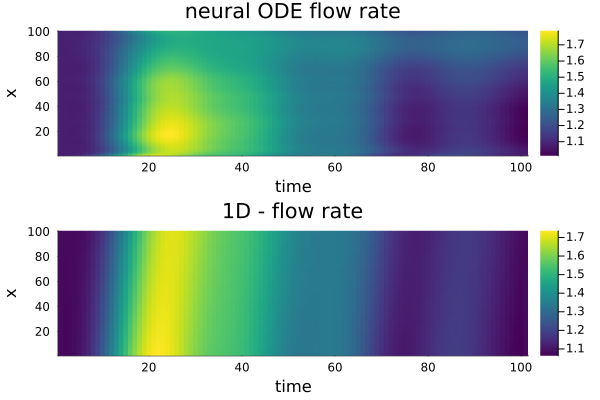

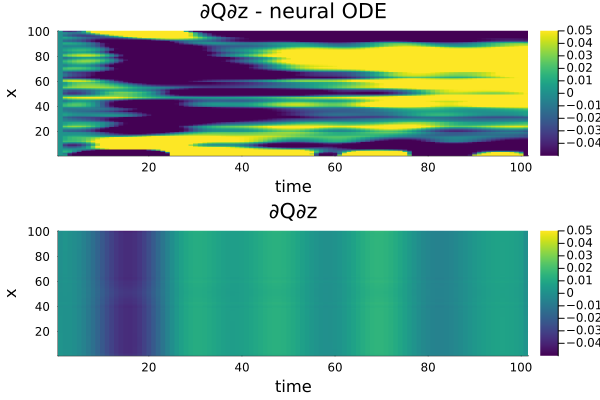

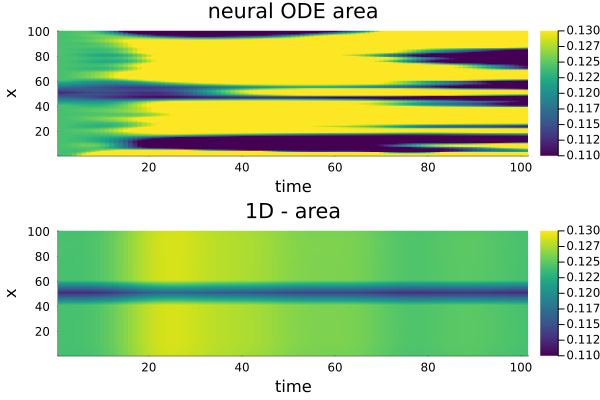

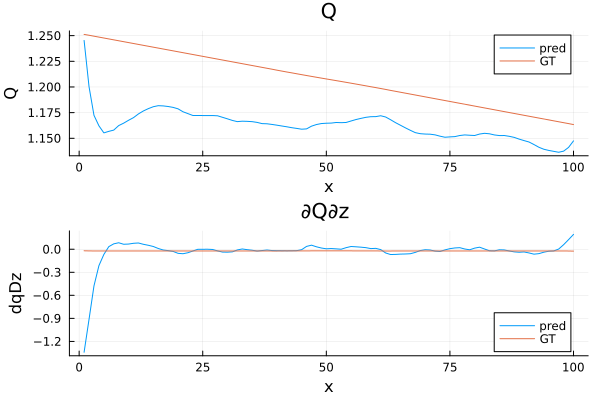

waveform batch: 3/3
Using ADAM optimizer
Sum of params:89.15107
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 11516.006788995475
Iteration: 2 || Loss: 11502.583650120276
Iteration: 3 || Loss: 11489.859414292565
Iteration: 4 || Loss: 11477.534688439659
Iteration: 5 || Loss: 11465.428718018751
Iteration: 6 || Loss: 11465.428718018751
saving ADAM checkpoint...
Sum of params:89.106834
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 11465.428718018751
Iteration: 2 || Loss: 11173.107067803065
Iteration: 3 || Loss: 11123.145091294891
Iteration: 4 || Loss: 10885.485391589888
Iteration: 5 || Loss: 10217.882467394189
Iteration: 6 || Loss: 10023.791386887093
Iteration: 7 || Loss: 9899.110392233215
Iteration: 8 || Loss: 7956.155241431192
Iteration: 9 || Loss: 6501.199883081674
Iteration: 10 || Loss: 6179.166462543299
Iteration: 11 || Loss: 6001.93153938733
saving BFGS checkpoint...
saved trained params to ptrained_BFGS.jld2
Sum of params:93.8524

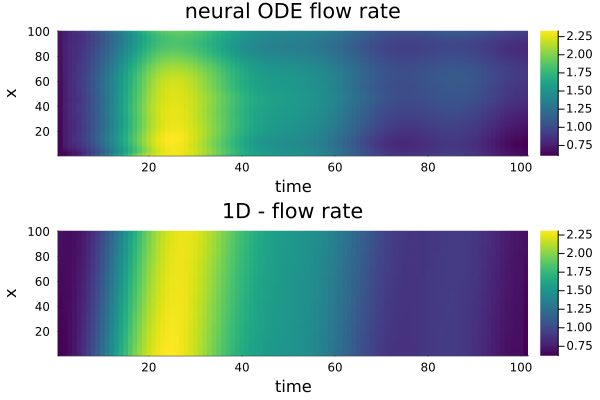

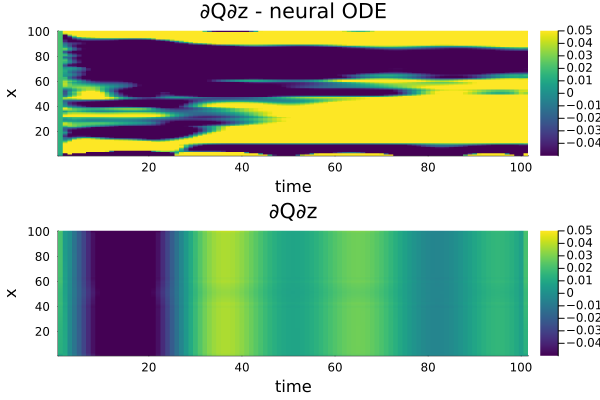

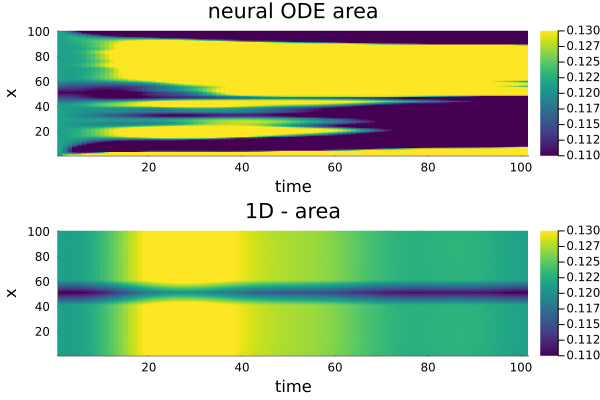

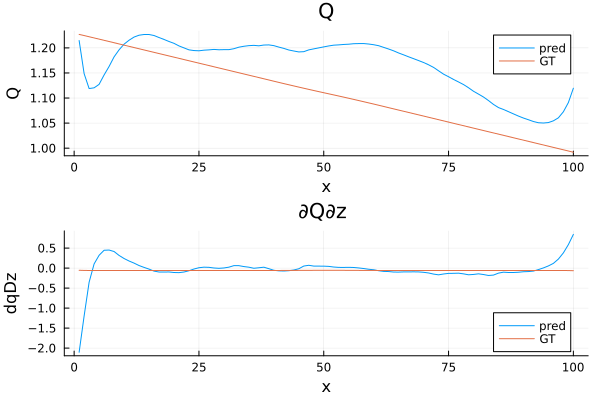

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Testing -interpolation:
waveform batch: 1/1
Test loss - interpolation:2514.346284811478


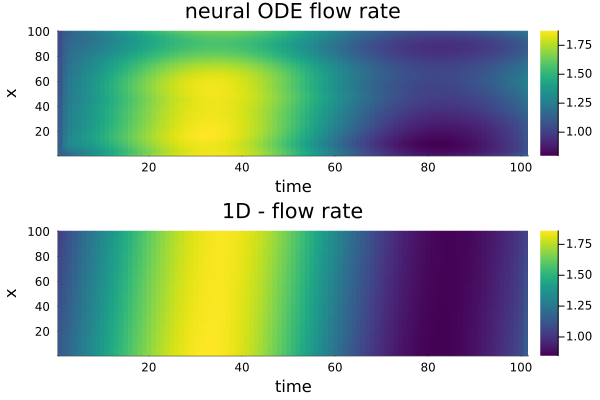

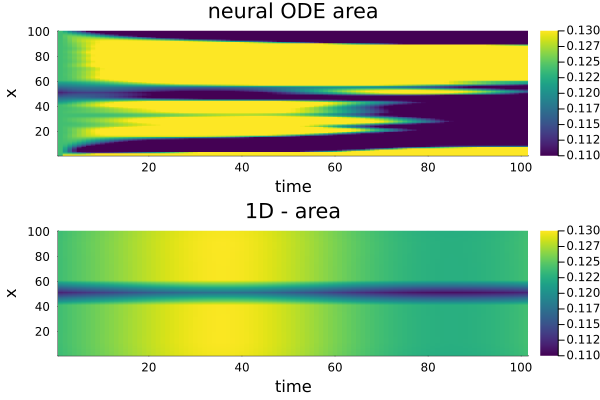

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Testing - extrapolation:
waveform batch: 1/2
Test loss - extrapolation:5787.974662699774


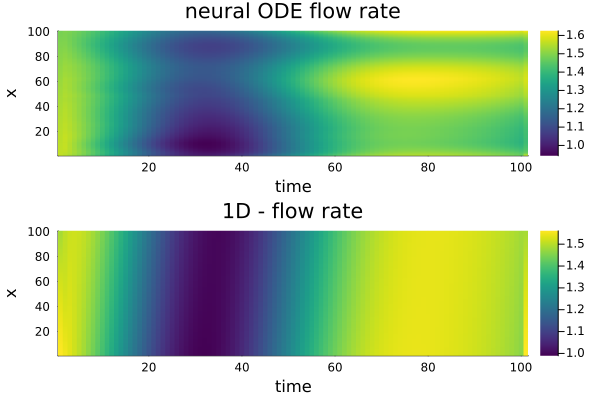

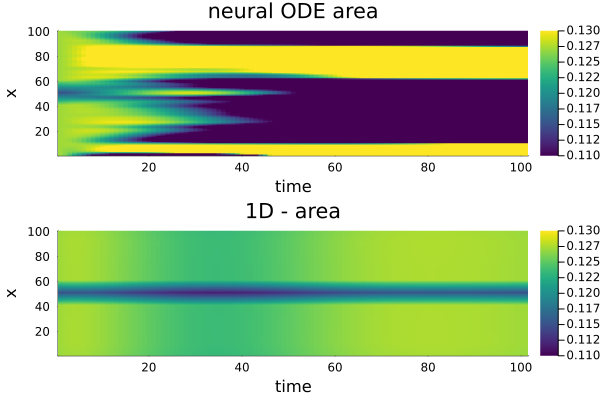

waveform batch: 2/2
Test loss - extrapolation:2464.4252253011155


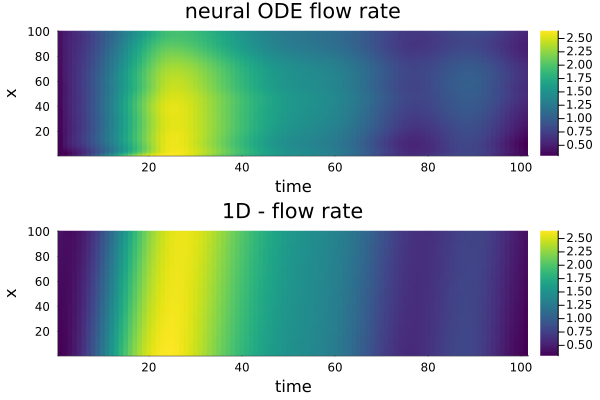

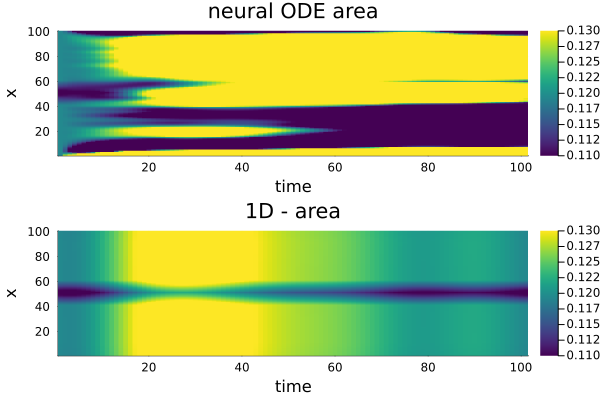

Epoch 1 mean train loss:398.3348703542482
Epoch 1 mean test loss - interpolation:419.0577141352464
Epoch 1 mean test loss - extrapolation:687.6999906667407
Start training epoch 2
waveform batch: 1/3
Using ADAM optimizer
Sum of params:93.85243
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 2411.9083912766546
Iteration: 2 || Loss: 2389.310518859506
Iteration: 3 || Loss: 2367.572260462364
Iteration: 4 || Loss: 2346.691848944826
Iteration: 5 || Loss: 2326.672781581455
Iteration: 6 || Loss: 2326.672781581455
saving ADAM checkpoint...
Sum of params:93.8317
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 2326.672781581455
Iteration: 2 || Loss: 2006.1081545419604
Iteration: 3 || Loss: 1806.8537092357965
Iteration: 4 || Loss: 1511.518122083189
Iteration: 5 || Loss: 942.0175494022556
Iteration: 6 || Loss: 784.230699959728
Iteration: 7 || Loss: 713.2310890034843
Iteration: 8 || Loss: 500.6491732668406
Iteration: 9 || Loss: 455.5842410561223
Iter

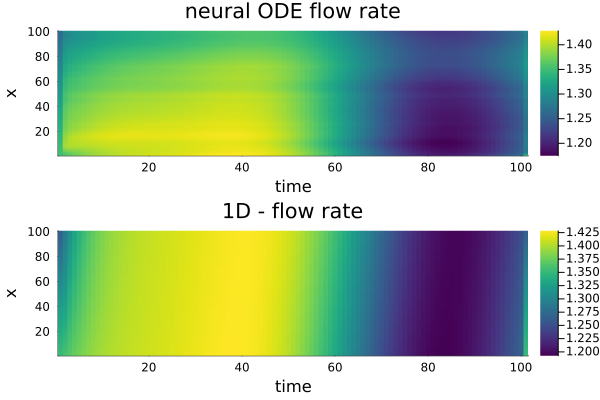

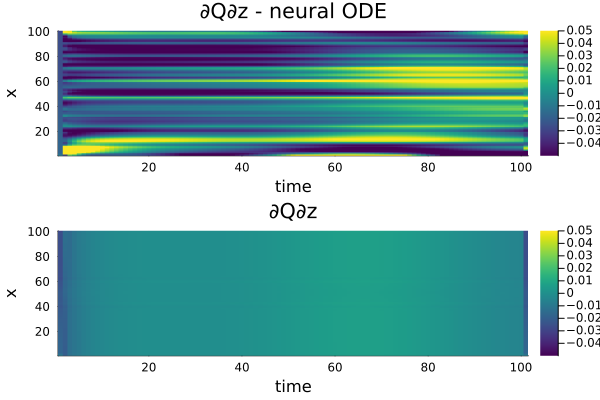

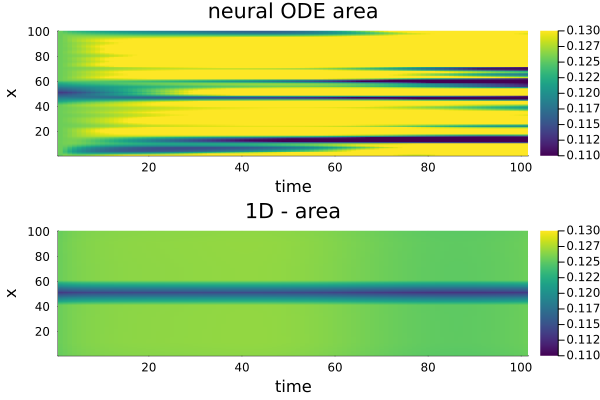

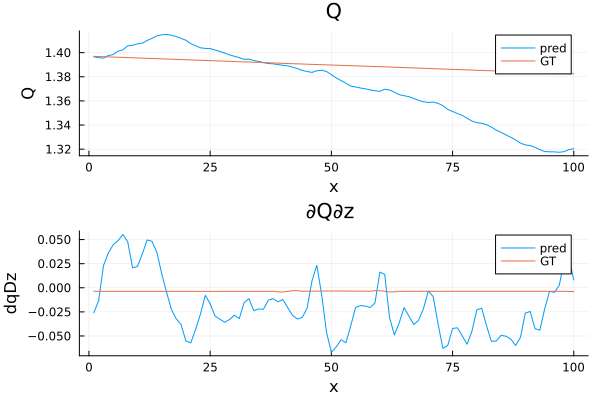

waveform batch: 2/3
Using ADAM optimizer
Sum of params:93.849625
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 1676.4451125203316
Iteration: 2 || Loss: 1668.1294401561229
Iteration: 3 || Loss: 1660.6845167604383
Iteration: 4 || Loss: 1654.0992298081767
Iteration: 5 || Loss: 1648.3256346847133
Iteration: 6 || Loss: 1648.3256346847133
saving ADAM checkpoint...
Sum of params:93.70033
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 1648.3256346847133
Iteration: 2 || Loss: 1598.5806202518465
Iteration: 3 || Loss: 1593.0298841146284
Iteration: 4 || Loss: 1584.253585217878
Iteration: 5 || Loss: 1524.7120905688773
Iteration: 6 || Loss: 1468.476399707011
Iteration: 7 || Loss: 1415.8211861092557
Iteration: 8 || Loss: 1405.4820217007377
Iteration: 9 || Loss: 1305.4043517645791
Iteration: 10 || Loss: 1298.05428871634
Iteration: 11 || Loss: 1285.3223493055725
saving BFGS checkpoint...
saved trained params to ptrained_BFGS.jld2
Sum of params:92.56

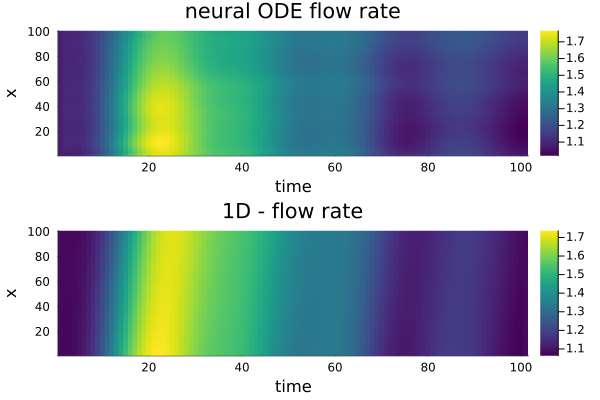

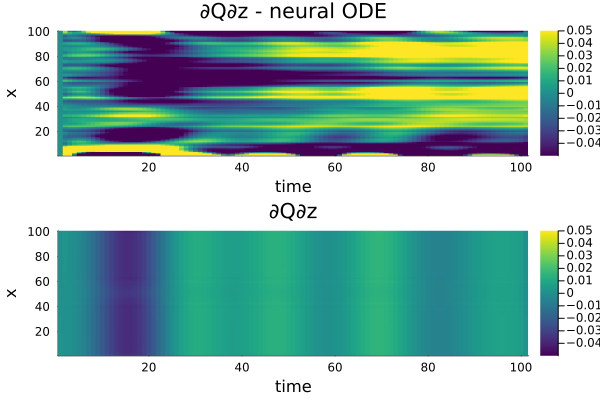

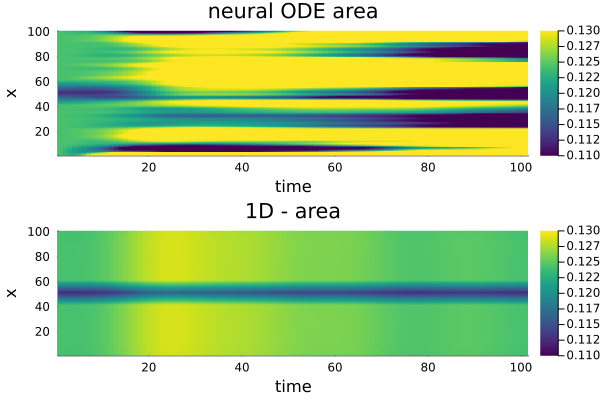

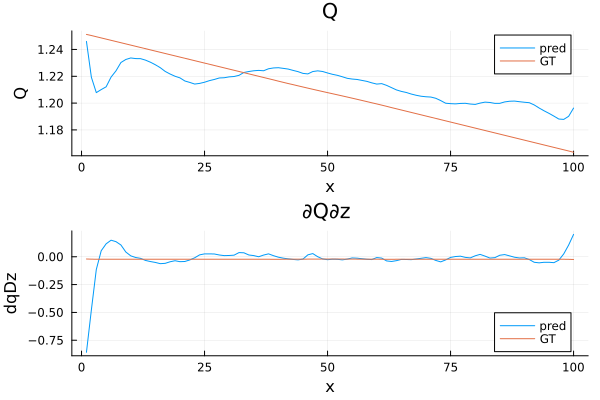

waveform batch: 3/3
Using ADAM optimizer
Sum of params:92.56507
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 4622.2199568576025
Iteration: 2 || Loss: 4612.2147436274645
Iteration: 3 || Loss: 4602.896037310963
Iteration: 4 || Loss: 4594.232360004927
Iteration: 5 || Loss: 4586.116508351074
Iteration: 6 || Loss: 4586.116508351074
saving ADAM checkpoint...
Sum of params:92.3689
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 4586.116508351074
Iteration: 2 || Loss: 4292.148682025203
Iteration: 3 || Loss: 4252.6958704380795
Iteration: 4 || Loss: 4101.785346061392
Iteration: 5 || Loss: 3883.1722542589823
Iteration: 6 || Loss: 3828.9154833672706
Iteration: 7 || Loss: 3806.880301349038
Iteration: 8 || Loss: 3638.4548349481506
Iteration: 9 || Loss: 3622.624543968997
Iteration: 10 || Loss: 3583.6021869514507
Iteration: 11 || Loss: 3226.382953000111
saving BFGS checkpoint...
saved trained params to ptrained_BFGS.jld2
Sum of params:93.77646
Epoc

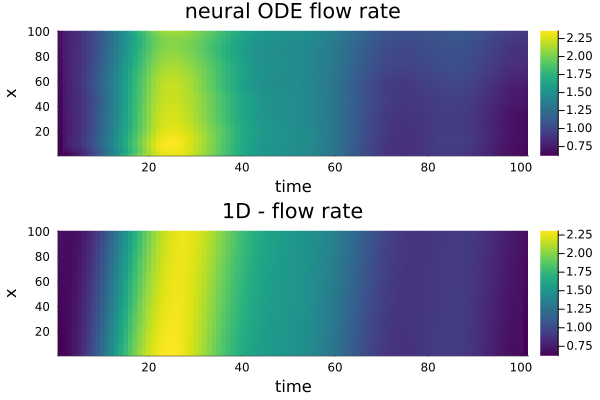

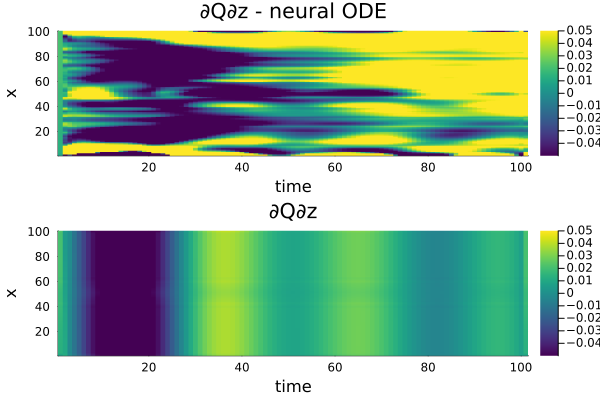

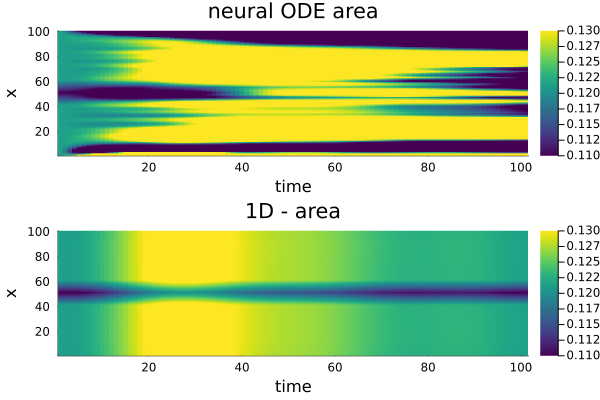

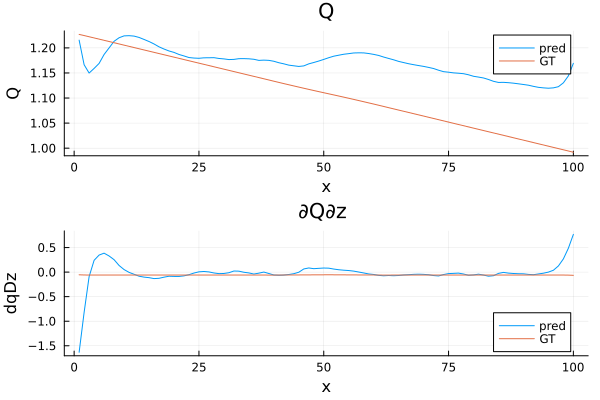

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Testing -interpolation:
waveform batch: 1/1
Test loss - interpolation:1086.616447723796


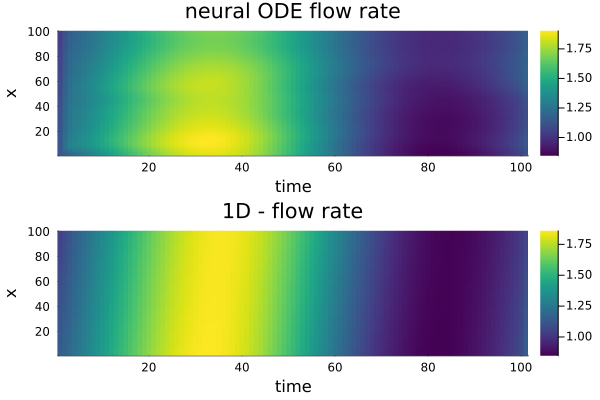

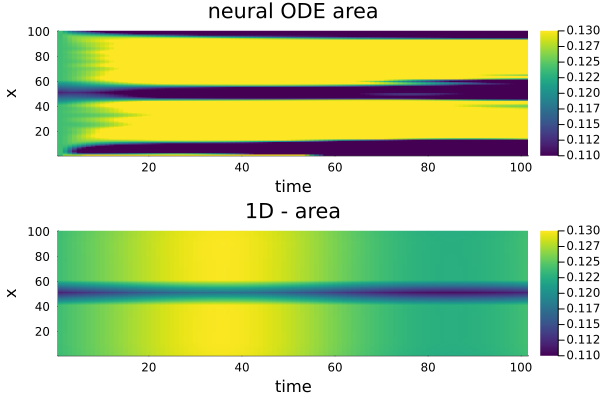

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Testing - extrapolation:
waveform batch: 1/2
Test loss - extrapolation:2936.8935915879974


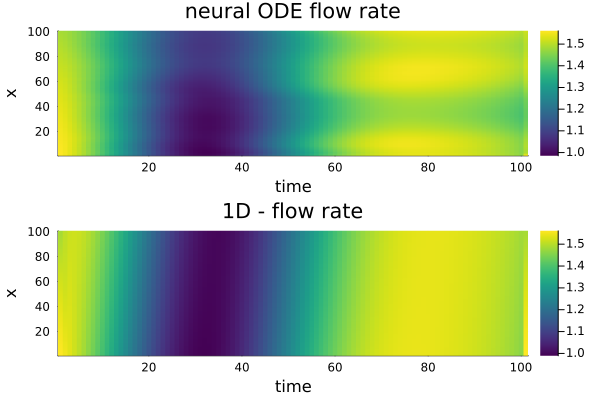

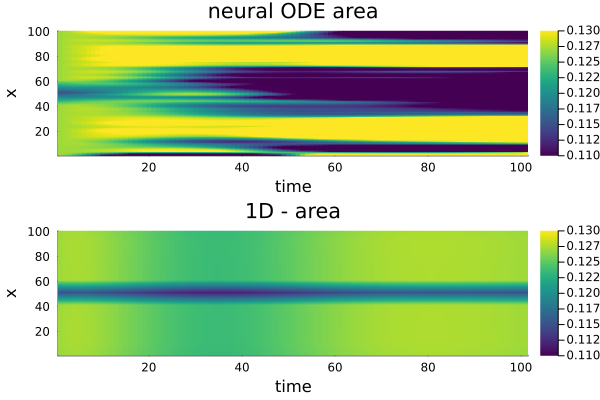

waveform batch: 2/2
Test loss - extrapolation:1542.3784579025892


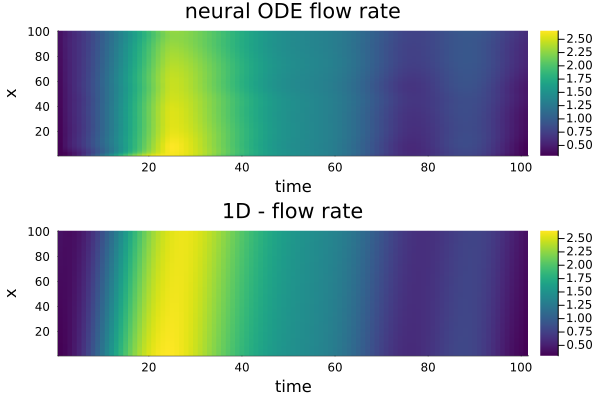

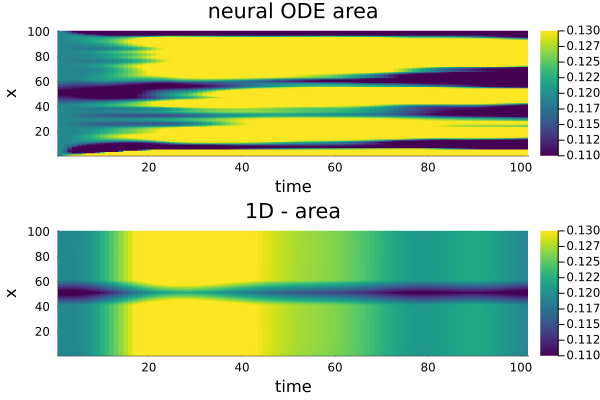

Epoch 2 mean train loss:169.20850076515603
Epoch 2 mean test loss - interpolation:181.10274128729932
Epoch 2 mean test loss - extrapolation:373.27267079088216
Start training epoch 3
Changing learning rate to:1.0e-5
waveform batch: 1/3
Using ADAM optimizer
Sum of params:93.77646
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 487.9642353193969
Iteration: 2 || Loss: 487.09726578344373
Iteration: 3 || Loss: 486.23873883331527
Iteration: 4 || Loss: 485.389275285008
Iteration: 5 || Loss: 484.5493373692276
Iteration: 6 || Loss: 484.5493373692276
saving ADAM checkpoint...
Sum of params:93.77605
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 484.5493373692276
Iteration: 2 || Loss: 447.7012051051437
Iteration: 3 || Loss: 389.1002481446118
Iteration: 4 || Loss: 330.1973497184986
Iteration: 5 || Loss: 299.57545295544156
Iteration: 6 || Loss: 283.0228571200164
Iteration: 7 || Loss: 268.3451520647949
Iteration: 8 || Loss: 259.9430287590454
Iterati

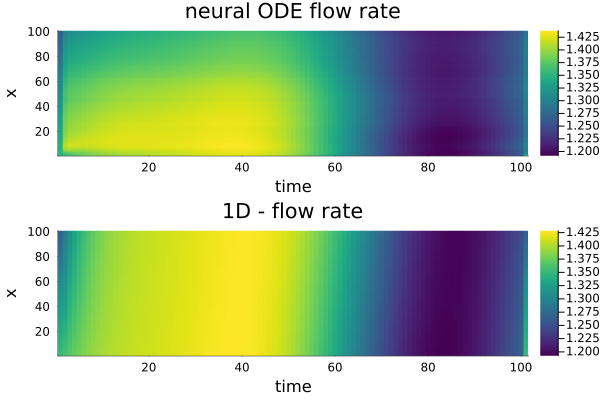

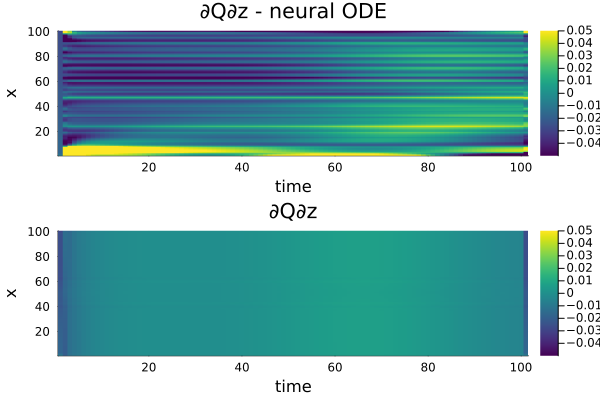

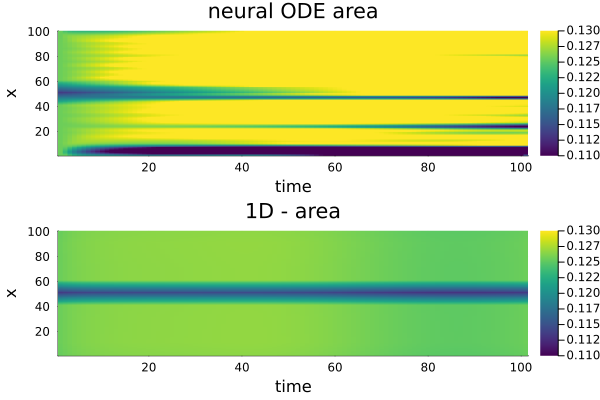

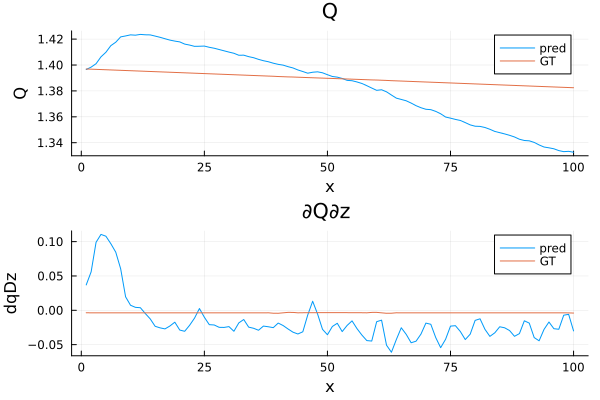

waveform batch: 2/3
Using ADAM optimizer
Sum of params:93.85737
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 1014.4306018692662
Iteration: 2 || Loss: 1014.1104249713037
Iteration: 3 || Loss: 1013.7983177857202
Iteration: 4 || Loss: 1013.4934898821946
Iteration: 5 || Loss: 1013.1967766114184
Iteration: 6 || Loss: 1013.1967766114184
saving ADAM checkpoint...
Sum of params:93.83845
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 1013.1967766114184
Iteration: 2 || Loss: 1008.2937798479719
Iteration: 3 || Loss: 997.4943675391066
Iteration: 4 || Loss: 970.9732703707704
Iteration: 5 || Loss: 946.286067269263
Iteration: 6 || Loss: 934.5336907582235
Iteration: 7 || Loss: 887.6203416920363
Iteration: 8 || Loss: 843.3986088184718
Iteration: 9 || Loss: 830.320961448285
Iteration: 10 || Loss: 772.4978040591789
Iteration: 11 || Loss: 714.412504507912
saving BFGS checkpoint...
saved trained params to ptrained_BFGS.jld2
Sum of params:92.555
Epoch 3

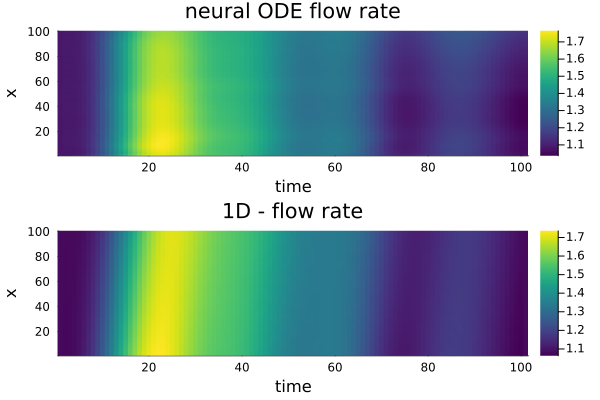

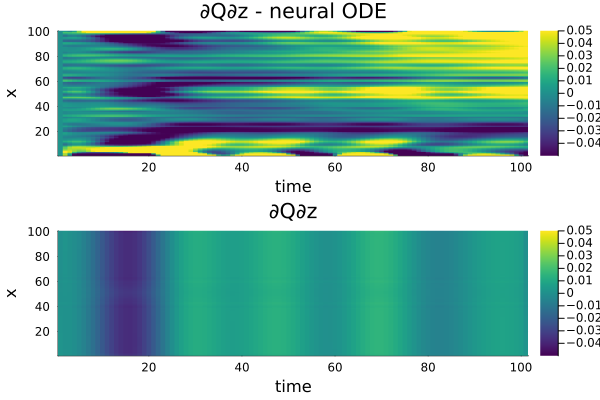

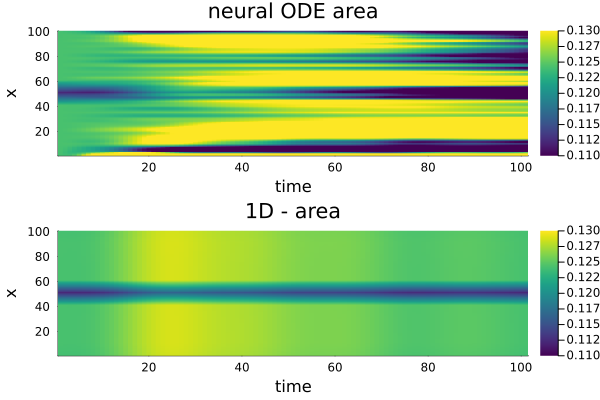

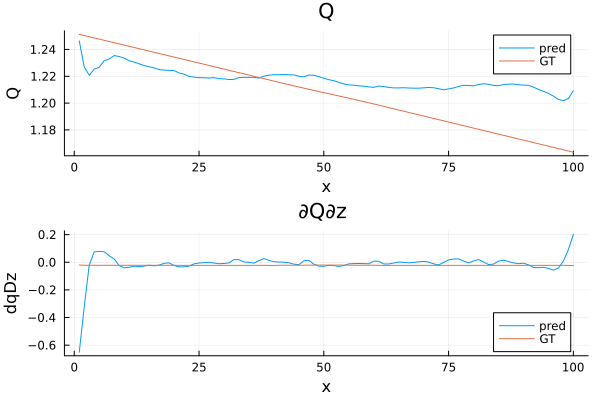

waveform batch: 3/3
Using ADAM optimizer
Sum of params:92.555
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 2957.860214521376
Iteration: 2 || Loss: 2957.047059225657
Iteration: 3 || Loss: 2956.2370486768095
Iteration: 4 || Loss: 2955.4359243207073
Iteration: 5 || Loss: 2954.640876593069
Iteration: 6 || Loss: 2954.640876593069
saving ADAM checkpoint...
Sum of params:92.54314
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 2954.640876593069
Iteration: 2 || Loss: 2894.844053668448
Iteration: 3 || Loss: 2852.73035148916
Iteration: 4 || Loss: 2623.5668113254233
Iteration: 5 || Loss: 2605.4527238074747
Iteration: 6 || Loss: 2566.1102603412146
Iteration: 7 || Loss: 2547.6340722058458
Iteration: 8 || Loss: 2377.049508552937
Iteration: 9 || Loss: 2353.030482310821
Iteration: 10 || Loss: 2272.6040910804413
Iteration: 11 || Loss: 2176.1078551815217
saving BFGS checkpoint...
saved trained params to ptrained_BFGS.jld2
Sum of params:95.28184
Epoch

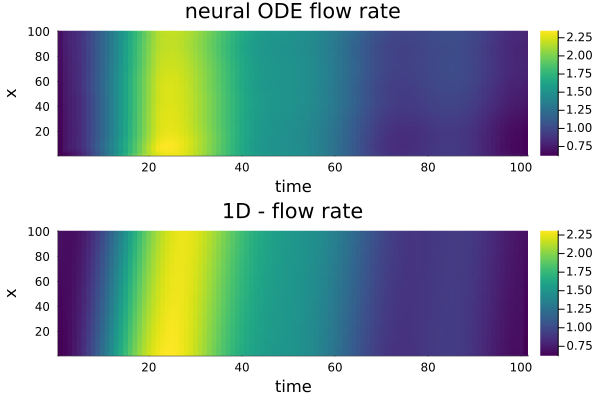

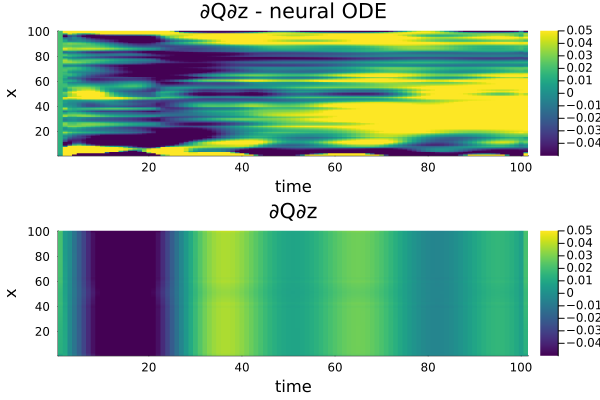

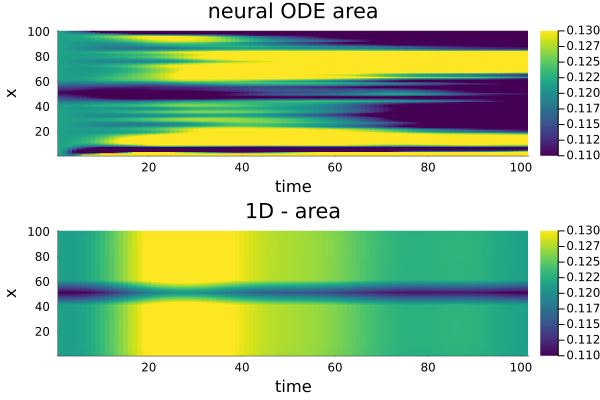

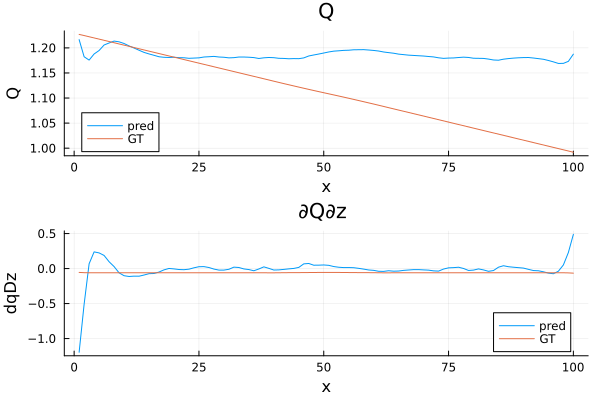

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Testing -interpolation:
waveform batch: 1/1
Test loss - interpolation:728.5410574143325


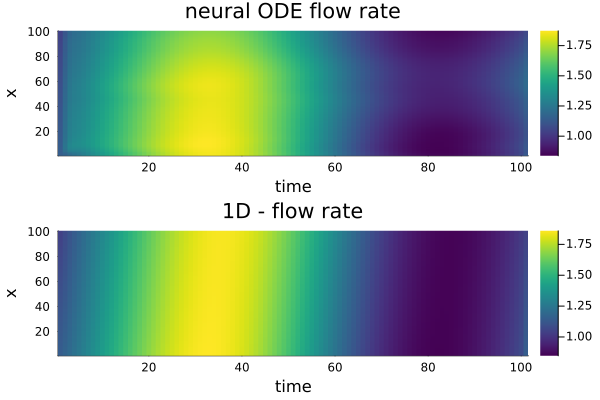

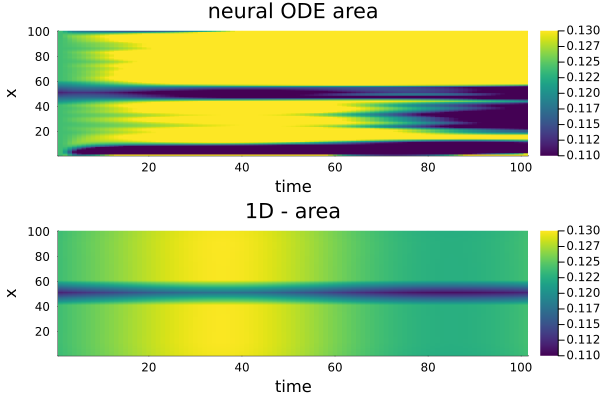

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Testing - extrapolation:
waveform batch: 1/2
Test loss - extrapolation:2147.665963055127


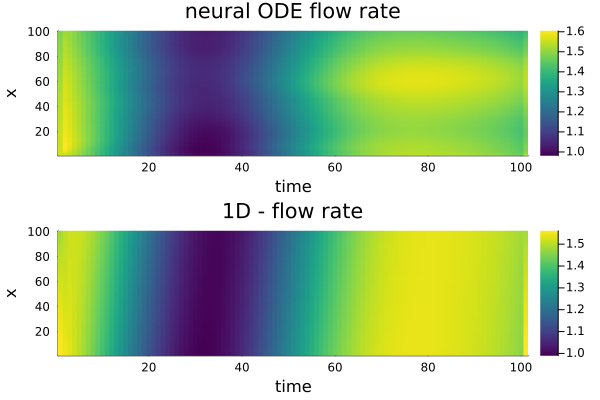

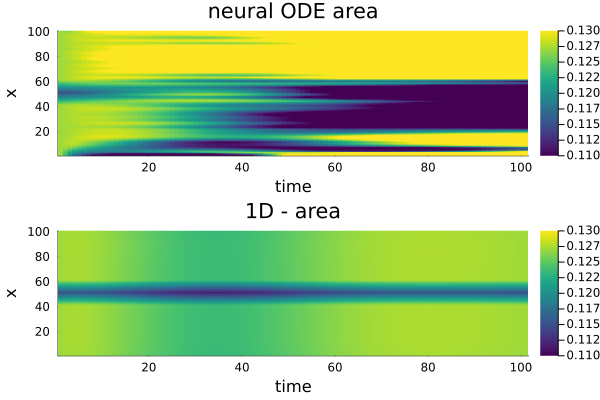

waveform batch: 2/2
Test loss - extrapolation:1222.4338329446798


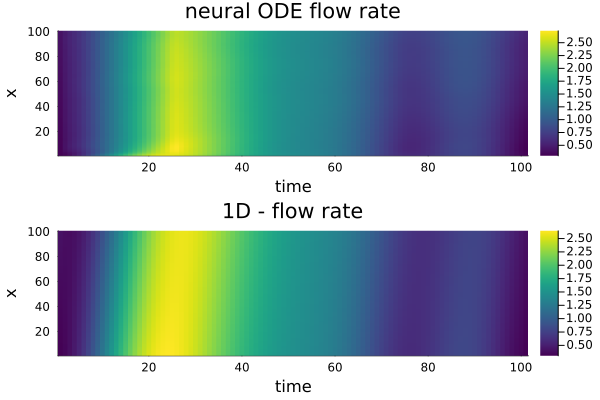

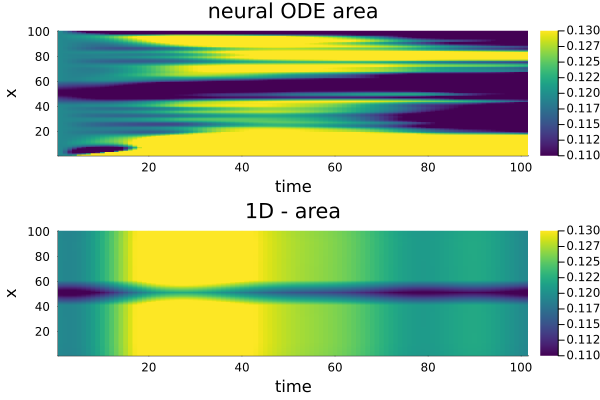

Epoch 3 mean train loss:107.59979506266113
Epoch 3 mean test loss - interpolation:121.42350956905541
Epoch 3 mean test loss - extrapolation:280.84164966665054
Start training epoch 4
waveform batch: 1/3
Using ADAM optimizer
Sum of params:95.28184
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 452.9241690724746
Iteration: 2 || Loss: 451.4663704779315
Iteration: 3 || Loss: 450.013108219702
Iteration: 4 || Loss: 448.57369778868343
Iteration: 5 || Loss: 447.14215011025215
Iteration: 6 || Loss: 447.14215011025215
saving ADAM checkpoint...
Sum of params:95.27507
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 447.14215011025215
Iteration: 2 || Loss: 329.3177739681938
Iteration: 3 || Loss: 310.2568794236682
Iteration: 4 || Loss: 236.46412130227563
Iteration: 5 || Loss: 194.27518801493974
Iteration: 6 || Loss: 192.5520115200201
Iteration: 7 || Loss: 173.72264906811066
Iteration: 8 || Loss: 172.58057906766732
Iteration: 9 || Loss: 170.379187254

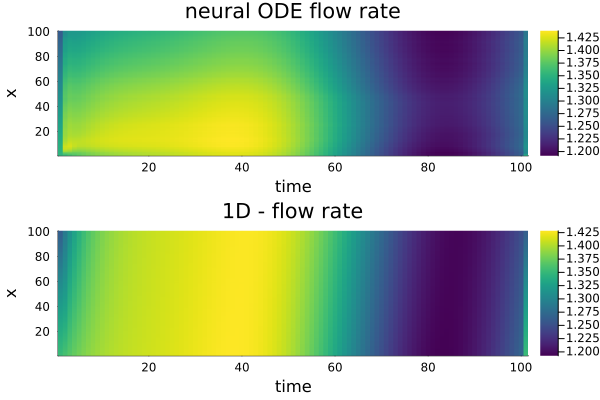

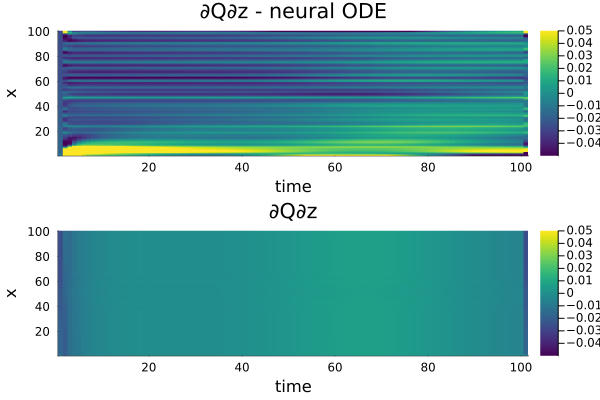

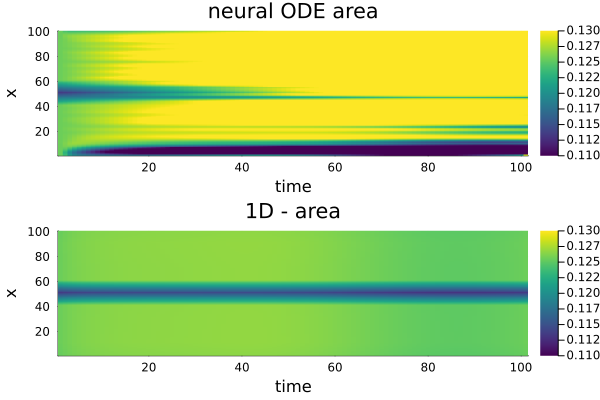

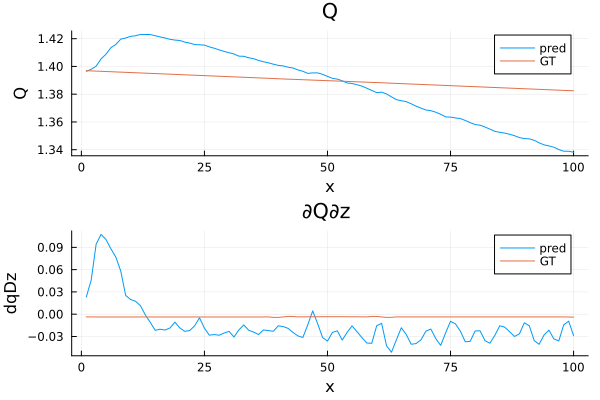

waveform batch: 2/3
Using ADAM optimizer
Sum of params:95.14418
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 668.013269161726
Iteration: 2 || Loss: 667.7284882864194
Iteration: 3 || Loss: 667.4507755260919
Iteration: 4 || Loss: 667.1803236294354
Iteration: 5 || Loss: 666.916824123191
Iteration: 6 || Loss: 666.916824123191
saving ADAM checkpoint...
Sum of params:95.127426
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 666.916824123191
Iteration: 2 || Loss: 665.098585812728
Iteration: 3 || Loss: 652.1696029938449
Iteration: 4 || Loss: 644.220893017391
Iteration: 5 || Loss: 640.2547190435604
Iteration: 6 || Loss: 621.3594439669354
Iteration: 7 || Loss: 594.928673560421
Iteration: 8 || Loss: 575.8589679360895
Iteration: 9 || Loss: 568.7537029023154
Iteration: 10 || Loss: 541.3253087709626
Iteration: 11 || Loss: 511.88359058670994
saving BFGS checkpoint...
saved trained params to ptrained_BFGS.jld2
Sum of params:94.53282
Epoch 4 loss:51

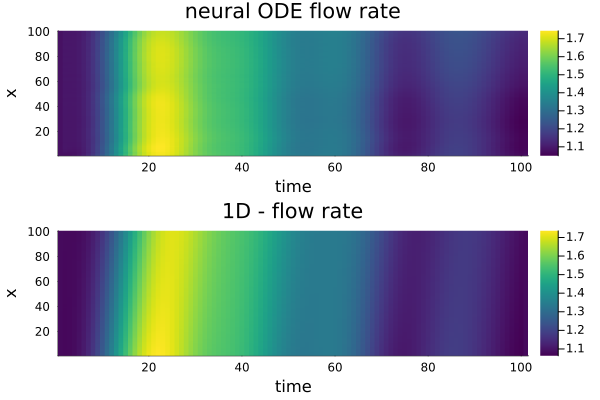

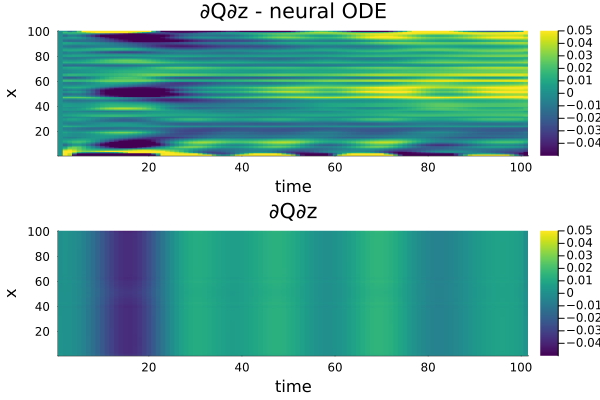

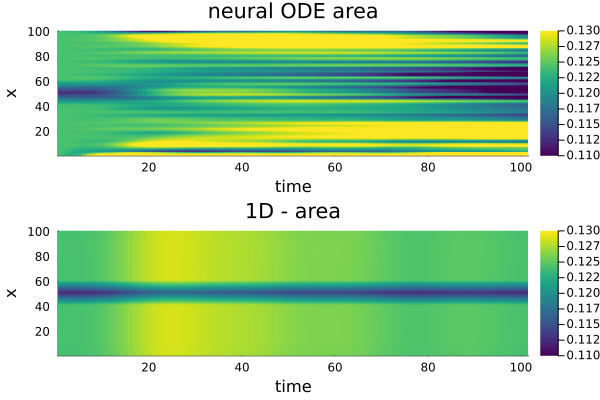

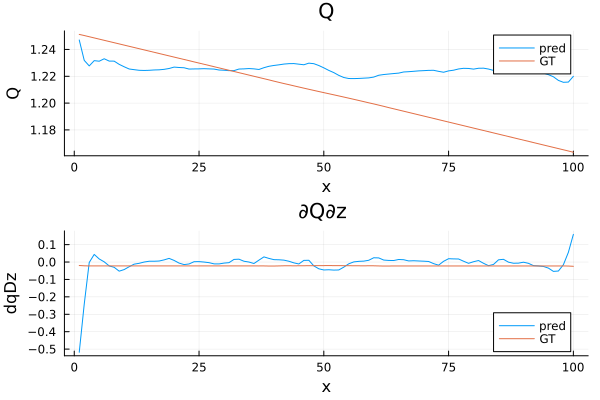

waveform batch: 3/3
Using ADAM optimizer
Sum of params:94.53282
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 2294.303335562236
Iteration: 2 || Loss: 2293.4352215758245
Iteration: 3 || Loss: 2292.57495806876
Iteration: 4 || Loss: 2291.72332835971
Iteration: 5 || Loss: 2290.8791890671823
Iteration: 6 || Loss: 2290.8791890671823
saving ADAM checkpoint...
Sum of params:94.53023
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 2290.8791890671823
Iteration: 2 || Loss: 2261.474744632879
Iteration: 3 || Loss: 2227.6246845497194
Iteration: 4 || Loss: 2164.114450810598
Iteration: 5 || Loss: 2107.563689685417
Iteration: 6 || Loss: 2076.2895204281167
Iteration: 7 || Loss: 2025.045610882715
Iteration: 8 || Loss: 1947.9416154772653
Iteration: 9 || Loss: 1920.350252213428
Iteration: 10 || Loss: 1799.9686628506186
Iteration: 11 || Loss: 1777.1059152998375
saving BFGS checkpoint...
saved trained params to ptrained_BFGS.jld2
Sum of params:97.38588
Epo

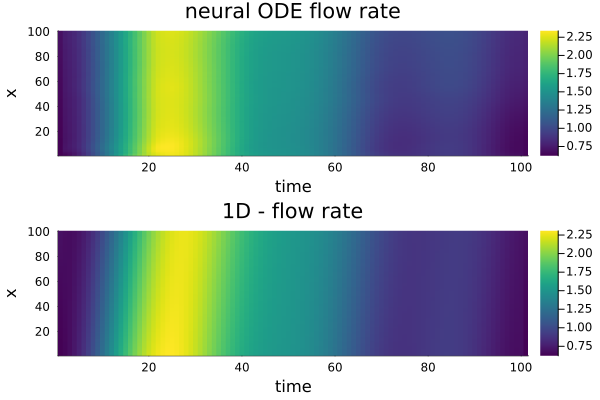

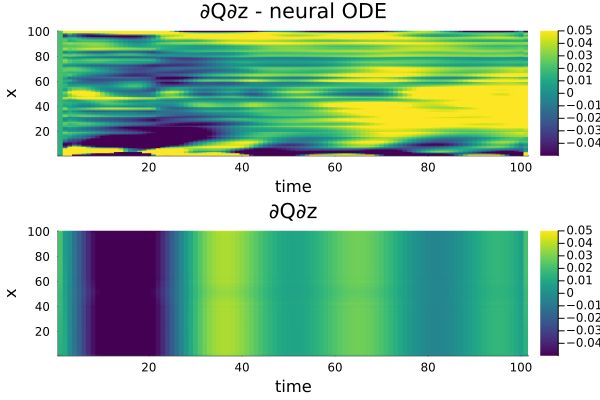

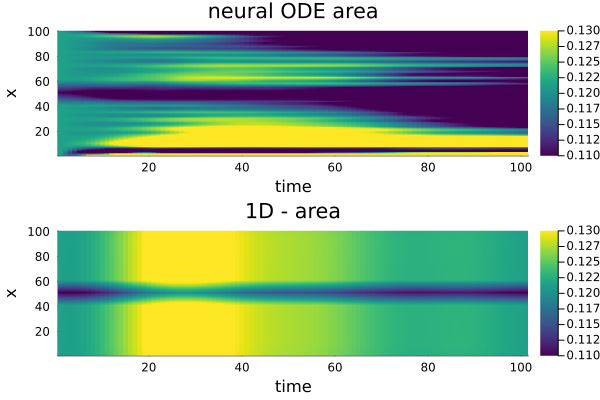

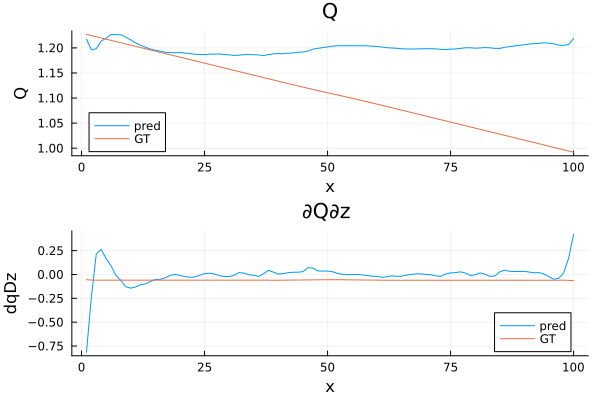

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Testing -interpolation:
waveform batch: 1/1
Test loss - interpolation:606.5092997555886


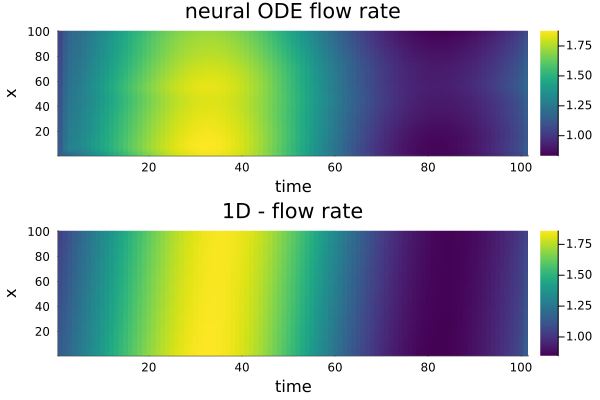

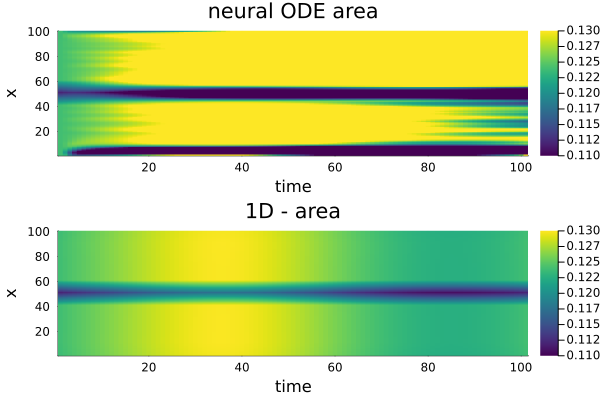

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Testing - extrapolation:
waveform batch: 1/2
Test loss - extrapolation:1740.5186862499215


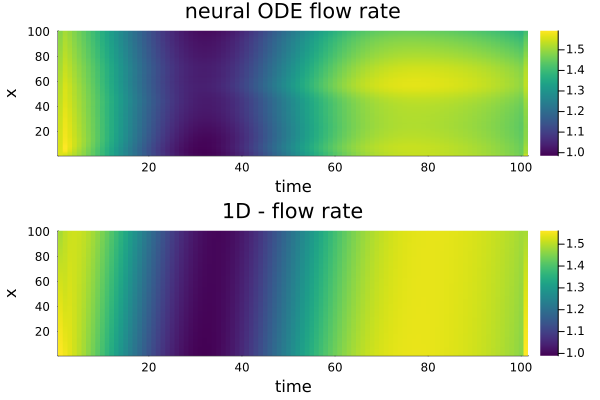

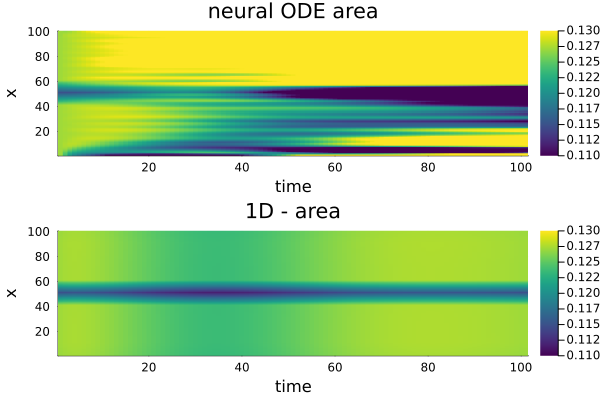

waveform batch: 2/2
Test loss - extrapolation:987.8852964522216


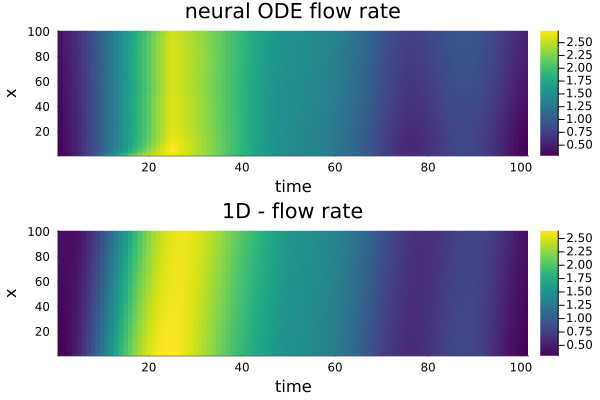

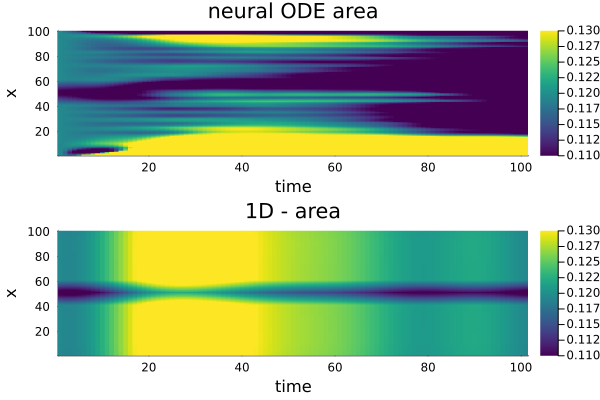

Epoch 4 mean train loss:84.65383762650414
Epoch 4 mean test loss - interpolation:101.0848832925981
Epoch 4 mean test loss - extrapolation:227.36699855851194
Start training epoch 5
waveform batch: 1/3
Using ADAM optimizer
Sum of params:97.38588
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 334.2796770538399
Iteration: 2 || Loss: 332.8111441398297
Iteration: 3 || Loss: 331.3502503317007
Iteration: 4 || Loss: 329.9006375181766
Iteration: 5 || Loss: 328.46073132623115
Iteration: 6 || Loss: 328.46073132623115
saving ADAM checkpoint...
Sum of params:97.3815
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 328.46073132623115
Iteration: 2 || Loss: 204.43618250005596
Iteration: 3 || Loss: 197.82851953871224
Iteration: 4 || Loss: 176.42044569896683
Iteration: 5 || Loss: 170.35508767139274
Iteration: 6 || Loss: 166.6256056603033
Iteration: 7 || Loss: 159.77043687070818
Iteration: 8 || Loss: 158.10096737682028
Iteration: 9 || Loss: 155.9488945461

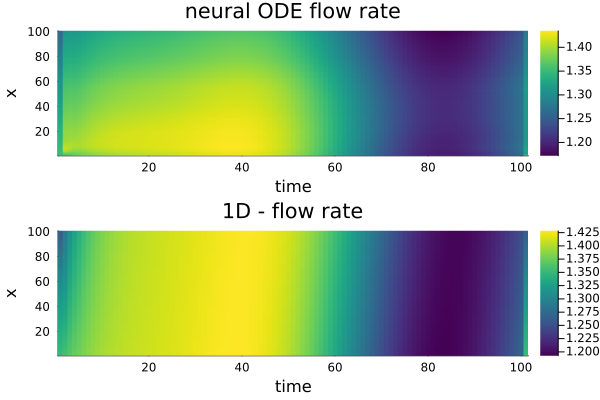

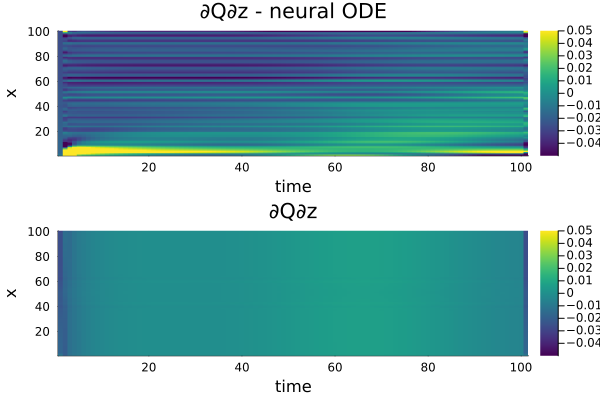

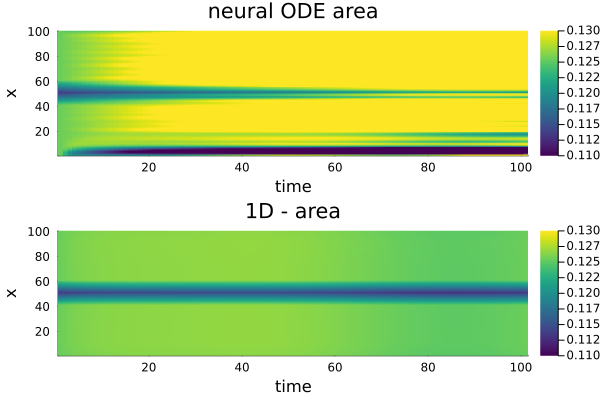

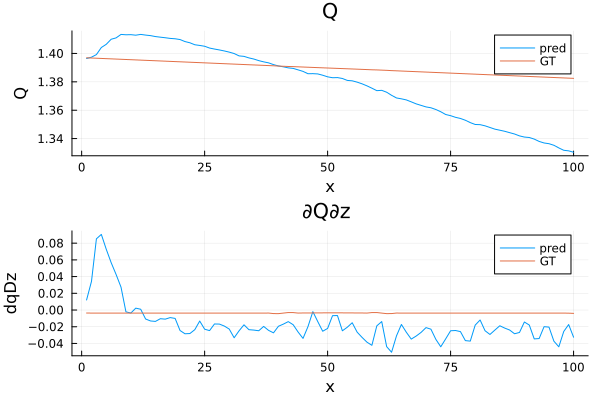

waveform batch: 2/3
Using ADAM optimizer
Sum of params:97.27288
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 575.8879173600619
Iteration: 2 || Loss: 575.7203246370185
Iteration: 3 || Loss: 575.561035453961
Iteration: 4 || Loss: 575.4070032867559
Iteration: 5 || Loss: 575.2554322496322
Iteration: 6 || Loss: 575.2554322496322
saving ADAM checkpoint...
Sum of params:97.26913
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 575.2554322496322
Iteration: 2 || Loss: 572.295842770099
Iteration: 3 || Loss: 566.7645805142598
Iteration: 4 || Loss: 561.3785061111033
Iteration: 5 || Loss: 557.208343234565
Iteration: 6 || Loss: 546.8495200394573
Iteration: 7 || Loss: 520.9686059620102
Iteration: 8 || Loss: 498.20862827486155
Iteration: 9 || Loss: 483.263171382839
Iteration: 10 || Loss: 445.8746684534031
Iteration: 11 || Loss: 427.4032807013084
saving BFGS checkpoint...
saved trained params to ptrained_BFGS.jld2
Sum of params:96.94594
Epoch 5 loss:

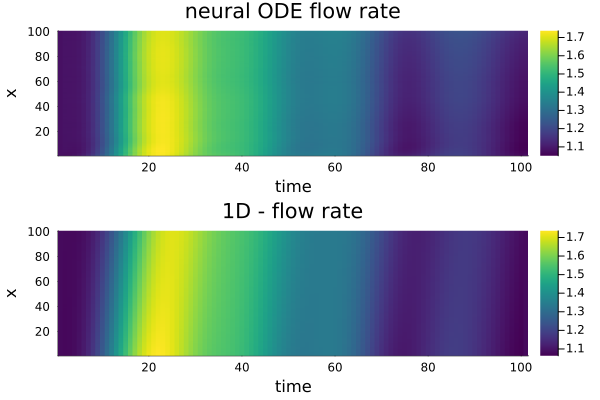

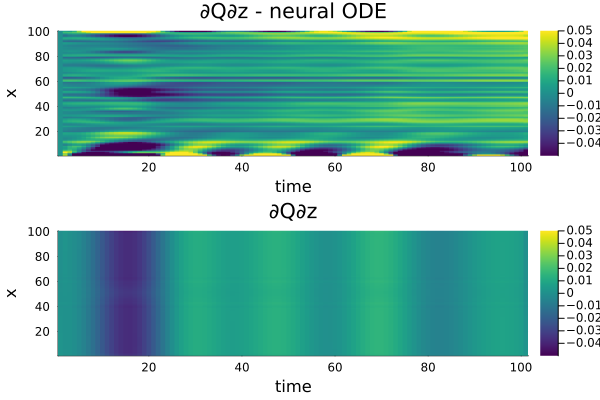

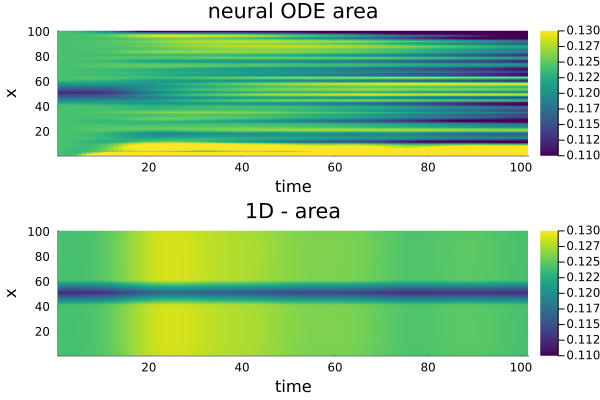

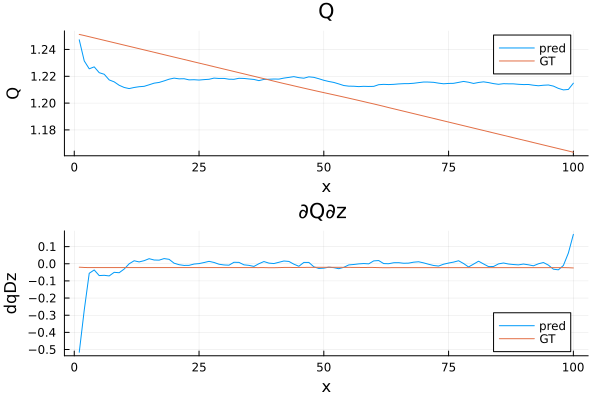

waveform batch: 3/3
Using ADAM optimizer
Sum of params:96.94594
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 1976.4725391728314
Iteration: 2 || Loss: 1976.0626085818403
Iteration: 3 || Loss: 1975.662436349292
Iteration: 4 || Loss: 1975.2713006072331
Iteration: 5 || Loss: 1974.889217632048
Iteration: 6 || Loss: 1974.889217632048
saving ADAM checkpoint...
Sum of params:96.949455
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 1974.889217632048
Iteration: 2 || Loss: 1971.0768923667076
Iteration: 3 || Loss: 1962.2436943665246
Iteration: 4 || Loss: 1832.395115979207
Iteration: 5 || Loss: 1802.1426544037895
Iteration: 6 || Loss: 1690.2507343208827
Iteration: 7 || Loss: 1633.2094791146794
Iteration: 8 || Loss: 1608.9240638083
Iteration: 9 || Loss: 1581.217146126105
Iteration: 10 || Loss: 1563.6770909105915
Iteration: 11 || Loss: 1537.7728337632368
saving BFGS checkpoint...
saved trained params to ptrained_BFGS.jld2
Sum of params:100.347534

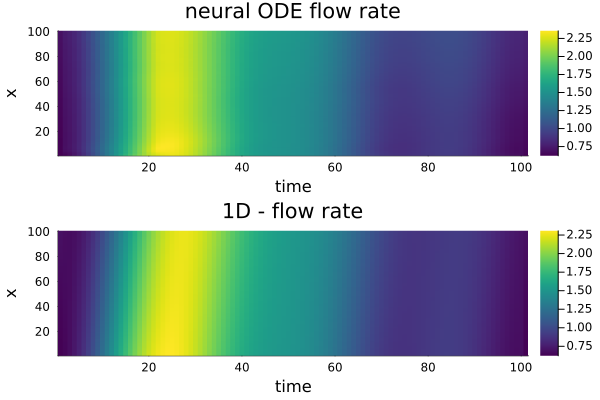

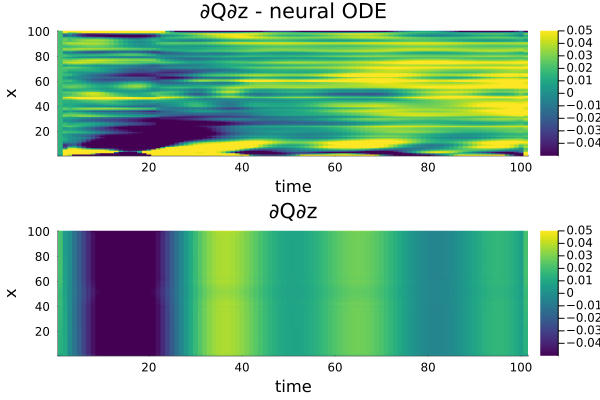

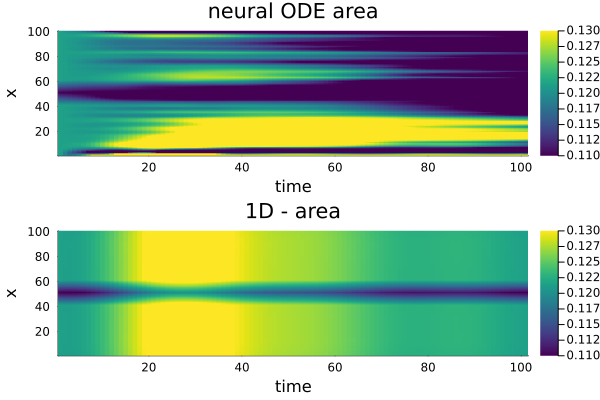

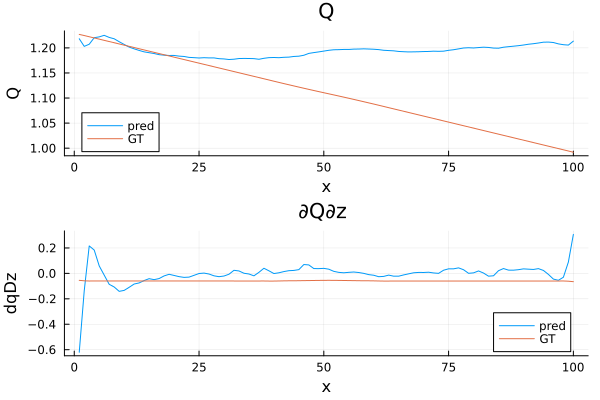

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Testing -interpolation:
waveform batch: 1/1
Test loss - interpolation:522.53567105339


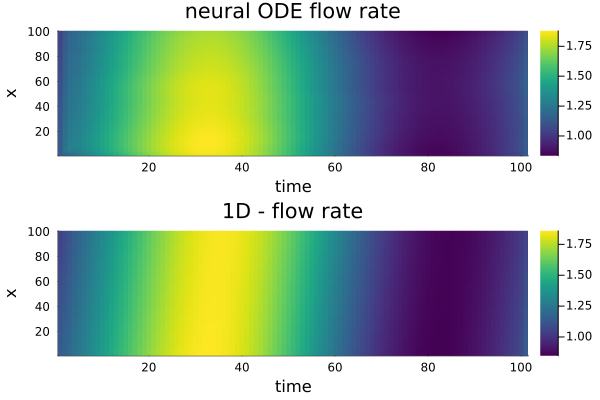

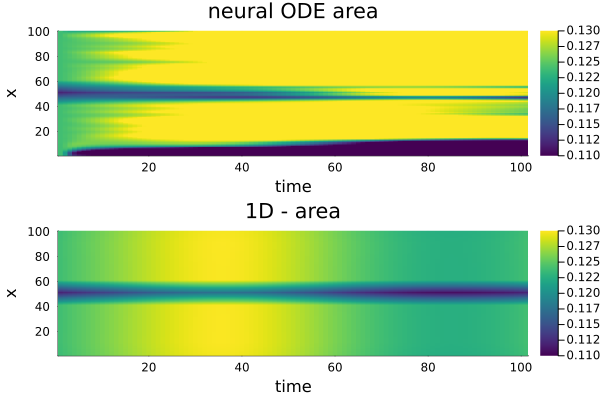

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Testing - extrapolation:
waveform batch: 1/2
Test loss - extrapolation:1543.944719611228


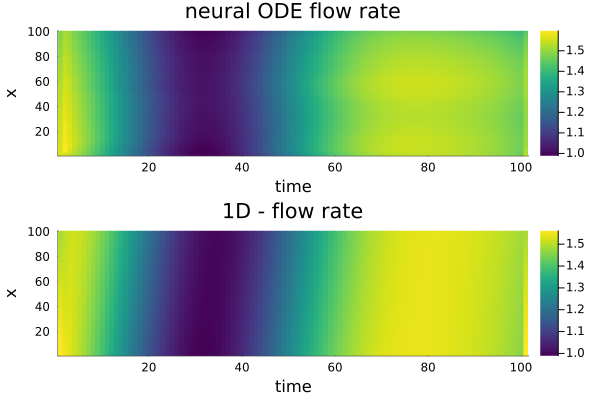

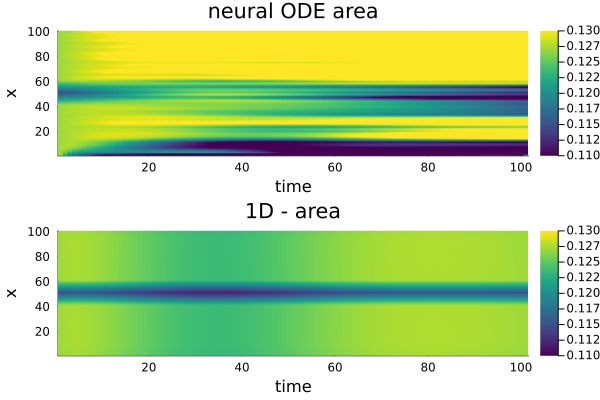

waveform batch: 2/2
Test loss - extrapolation:923.2743057769317


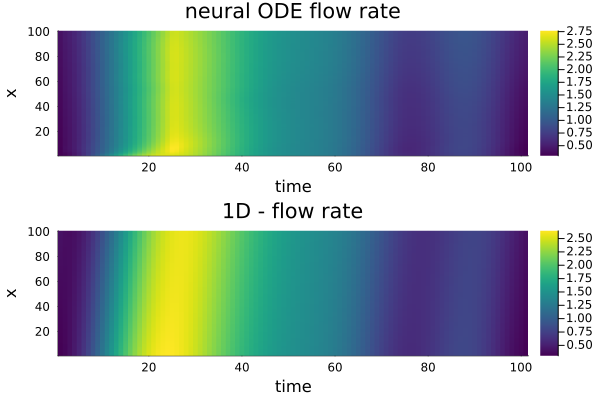

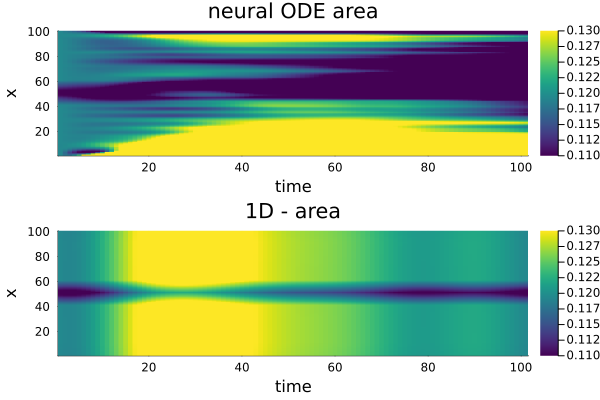

Epoch 5 mean train loss:73.0021467958051
Epoch 5 mean test loss - interpolation:87.08927850889835
Epoch 5 mean test loss - extrapolation:205.60158544901333
Start training epoch 6
Changing learning rate to:1.0000000000000002e-6
waveform batch: 1/3
Using ADAM optimizer
Sum of params:100.347534
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 211.2600493645295
Iteration: 2 || Loss: 211.15160310095953
Iteration: 3 || Loss: 211.04368575626984
Iteration: 4 || Loss: 210.93570050042067
Iteration: 5 || Loss: 210.82754432875223
Iteration: 6 || Loss: 210.82754432875223
saving ADAM checkpoint...
Sum of params:100.346825
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 210.82754432875223
Iteration: 2 || Loss: 157.2087799266086
Iteration: 3 || Loss: 151.4600124308081
Iteration: 4 || Loss: 148.82496934481998
Iteration: 5 || Loss: 147.24211875899428
Iteration: 6 || Loss: 143.4816465378268
Iteration: 7 || Loss: 141.3557807699659
Iteration: 8 || Loss: 140

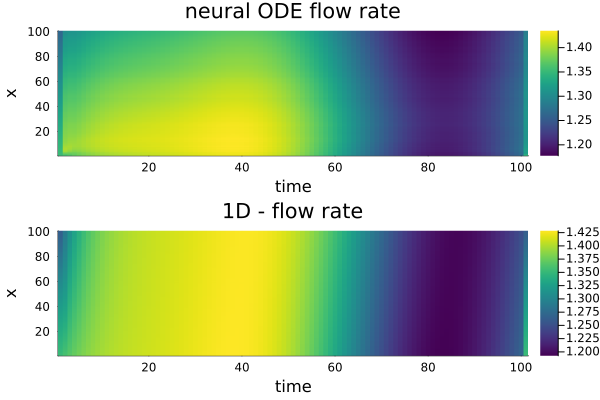

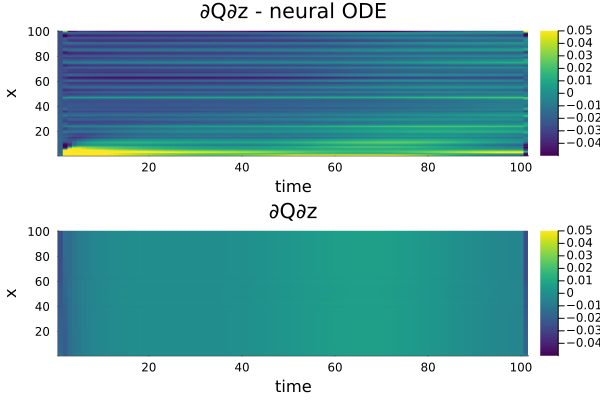

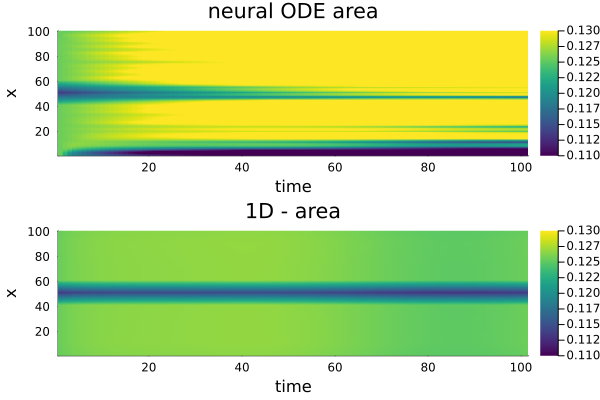

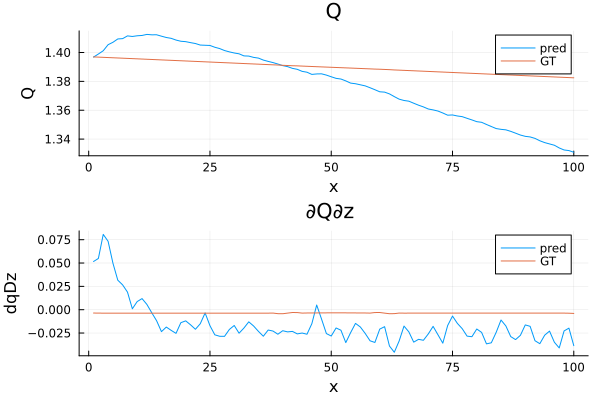

waveform batch: 2/3
Using ADAM optimizer
Sum of params:100.28302
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 507.2660700610287
Iteration: 2 || Loss: 507.24679981762216
Iteration: 3 || Loss: 507.2257487852981
Iteration: 4 || Loss: 507.2049030304125
Iteration: 5 || Loss: 507.1855295742079
Iteration: 6 || Loss: 507.1855295742079
saving ADAM checkpoint...
Sum of params:100.28189
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 507.1855295742079
Iteration: 2 || Loss: 505.7683629178258
Iteration: 3 || Loss: 491.58194013339033
Iteration: 4 || Loss: 484.08498038453945
Iteration: 5 || Loss: 482.9863484735162
Iteration: 6 || Loss: 463.00991465039544
Iteration: 7 || Loss: 440.13955183649017
Iteration: 8 || Loss: 396.7084448696145
Iteration: 9 || Loss: 379.5418610811659
Iteration: 10 || Loss: 364.3446898516346
Iteration: 11 || Loss: 360.8066572687511
saving BFGS checkpoint...
saved trained params to ptrained_BFGS.jld2
Sum of params:100.77182
Ep

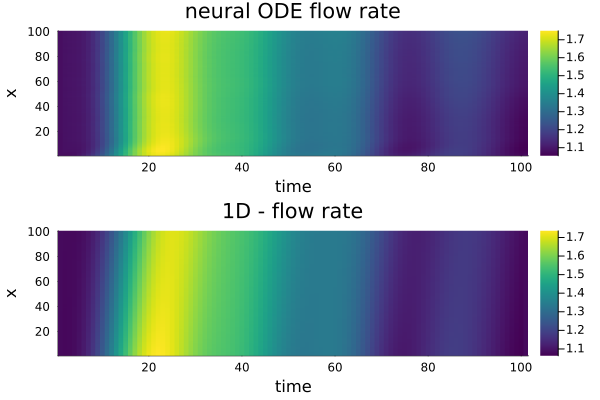

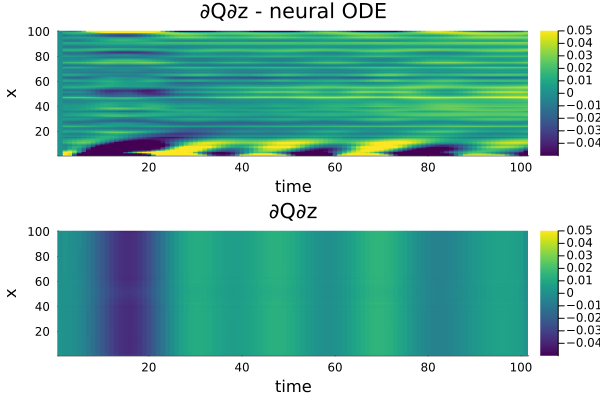

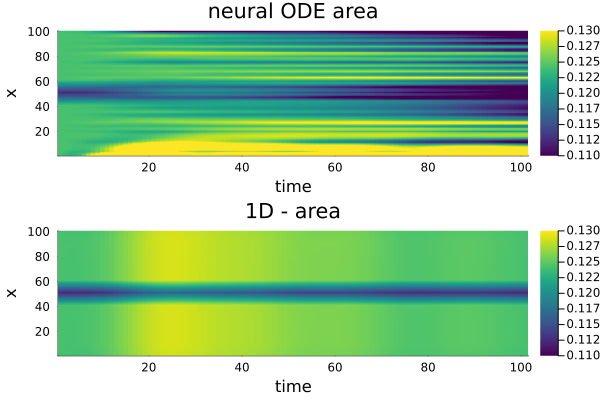

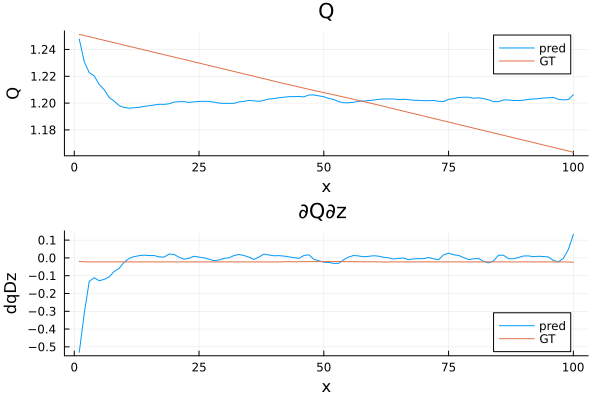

waveform batch: 3/3
Using ADAM optimizer
Sum of params:100.77182
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 1741.6822602293157
Iteration: 2 || Loss: 1741.6301127555957
Iteration: 3 || Loss: 1741.5804663116594
Iteration: 4 || Loss: 1741.5291987223163
Iteration: 5 || Loss: 1741.4785719627466
Iteration: 6 || Loss: 1741.4785719627466
saving ADAM checkpoint...
Sum of params:100.77164
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 1741.4785719627466
Iteration: 2 || Loss: 1733.0553955541138
Iteration: 3 || Loss: 1697.9366374290353
Iteration: 4 || Loss: 1580.9103465016428
Iteration: 5 || Loss: 1550.8944428382026
Iteration: 6 || Loss: 1535.720604239093
Iteration: 7 || Loss: 1498.5646445258474
Iteration: 8 || Loss: 1479.3836146294373
Iteration: 9 || Loss: 1461.4337550022071
Iteration: 10 || Loss: 1448.4495612683997
Iteration: 11 || Loss: 1429.1227215076042
saving BFGS checkpoint...
saved trained params to ptrained_BFGS.jld2
Sum of params:1

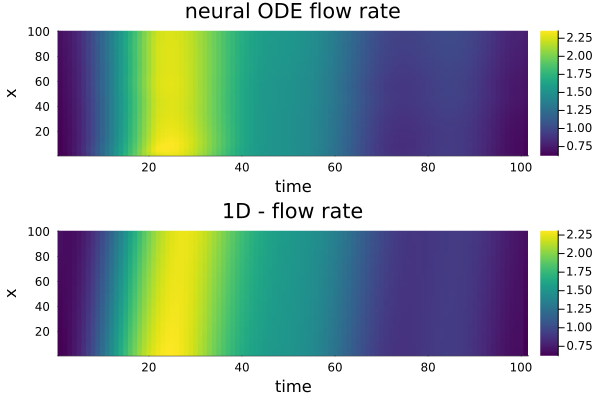

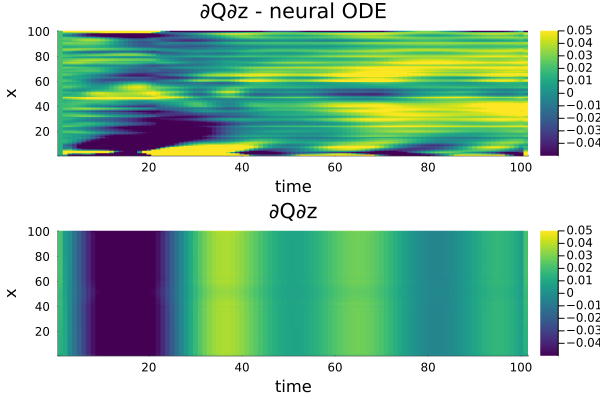

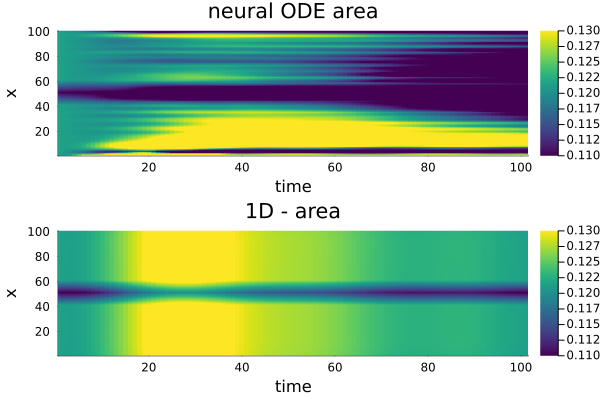

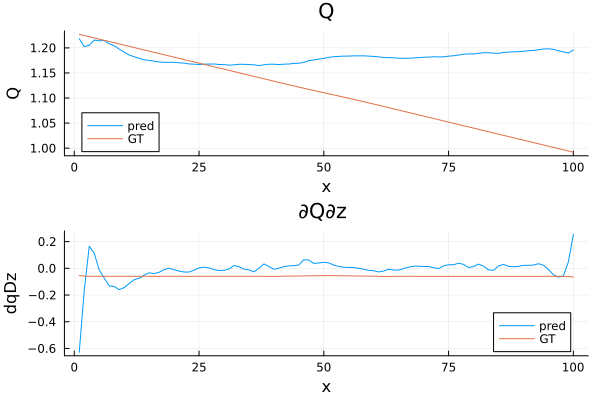

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Testing -interpolation:
waveform batch: 1/1
Test loss - interpolation:470.8549559045269


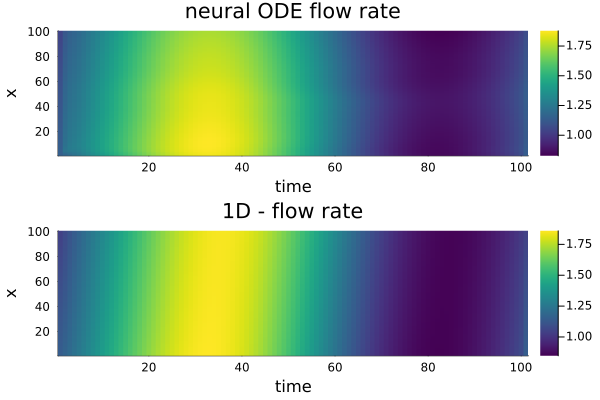

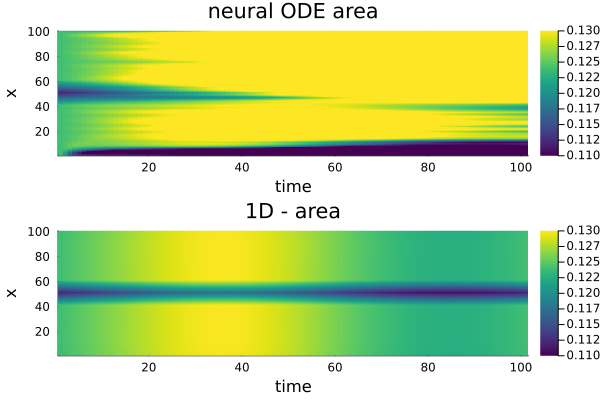

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Testing - extrapolation:
waveform batch: 1/2
Test loss - extrapolation:1464.4436395760144


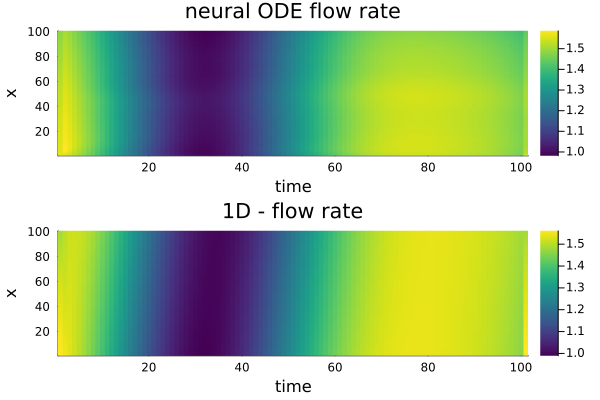

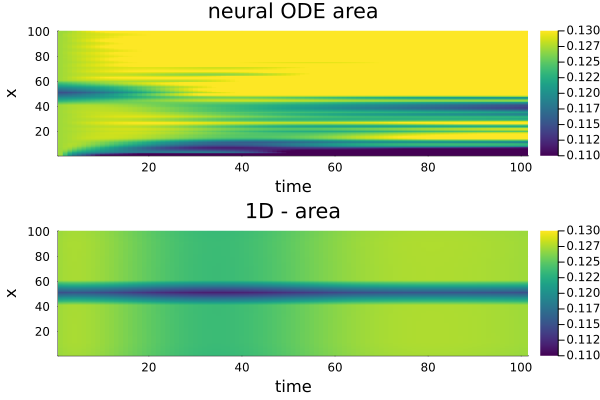

waveform batch: 2/2
Test loss - extrapolation:914.7946620214527


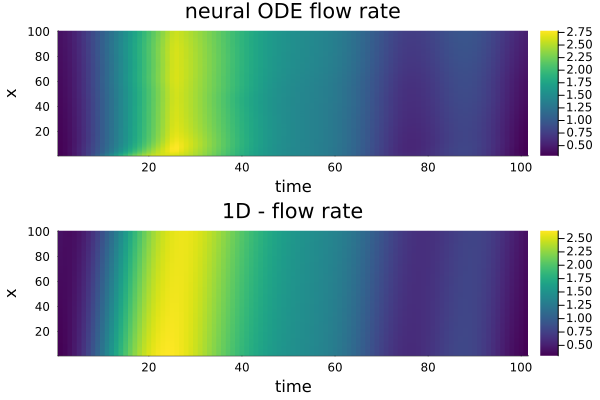

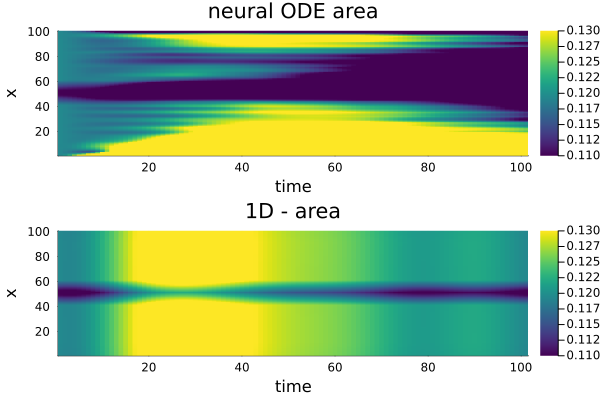

Epoch 6 mean train loss:66.36839729485548
Epoch 6 mean test loss - interpolation:78.47582598408782
Epoch 6 mean test loss - extrapolation:198.26985846645562
Start training epoch 7
waveform batch: 1/3
Using ADAM optimizer
Sum of params:102.358505
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 166.05100075152663
Iteration: 2 || Loss: 165.9994238701595
Iteration: 3 || Loss: 165.9502184163089
Iteration: 4 || Loss: 165.90096205840675
Iteration: 5 || Loss: 165.85129101345174
Iteration: 6 || Loss: 165.85129101345174
saving ADAM checkpoint...
Sum of params:102.358246
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 165.85129101345174
Iteration: 2 || Loss: 150.05693899393904
Iteration: 3 || Loss: 146.562120654749
Iteration: 4 || Loss: 137.4215533011615
Iteration: 5 || Loss: 129.31345955026987
Iteration: 6 || Loss: 128.3248754801159
Iteration: 7 || Loss: 124.893385761307
Iteration: 8 || Loss: 124.10237164946214
Iteration: 9 || Loss: 122.66779678

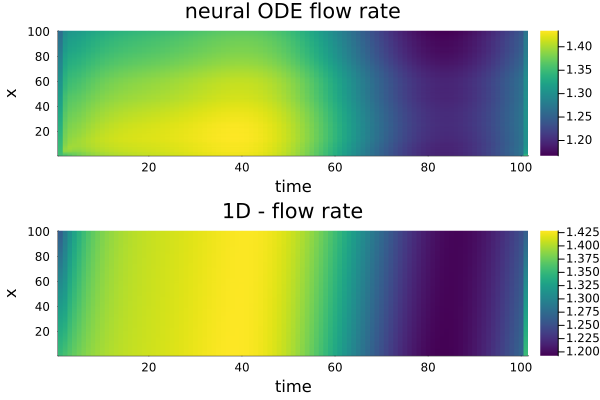

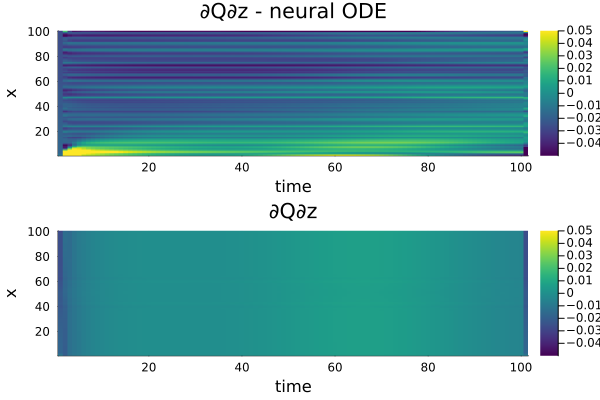

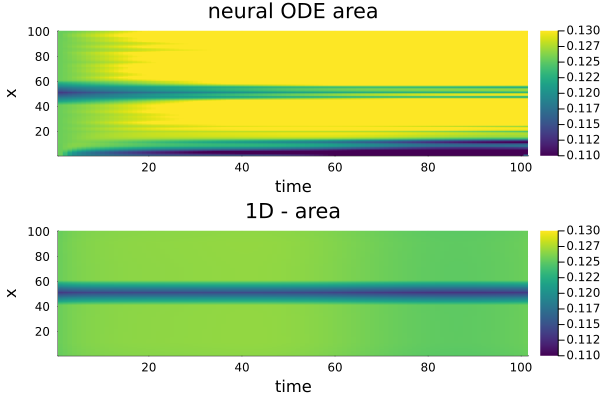

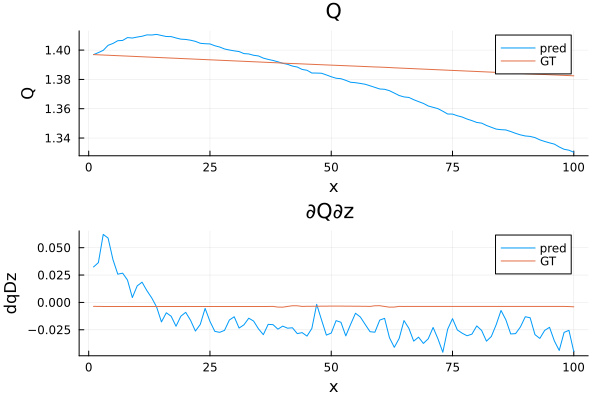

waveform batch: 2/3
Using ADAM optimizer
Sum of params:102.382416
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 424.21756837487214
Iteration: 2 || Loss: 424.2038466562786
Iteration: 3 || Loss: 424.1900615512059
Iteration: 4 || Loss: 424.1770489943852
Iteration: 5 || Loss: 424.163735784375
Iteration: 6 || Loss: 424.163735784375
saving ADAM checkpoint...
Sum of params:102.38128
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 424.163735784375
Iteration: 2 || Loss: 423.2273809869693
Iteration: 3 || Loss: 422.0885862886505
Iteration: 4 || Loss: 408.02571410414674
Iteration: 5 || Loss: 401.63053514514155
Iteration: 6 || Loss: 383.3513244076634
Iteration: 7 || Loss: 367.6684601788906
Iteration: 8 || Loss: 352.30340673189255
Iteration: 9 || Loss: 346.9877940463709
Iteration: 10 || Loss: 344.85271117011916
Iteration: 11 || Loss: 342.1994756611919
saving BFGS checkpoint...
saved trained params to ptrained_BFGS.jld2
Sum of params:102.64645
Epoc

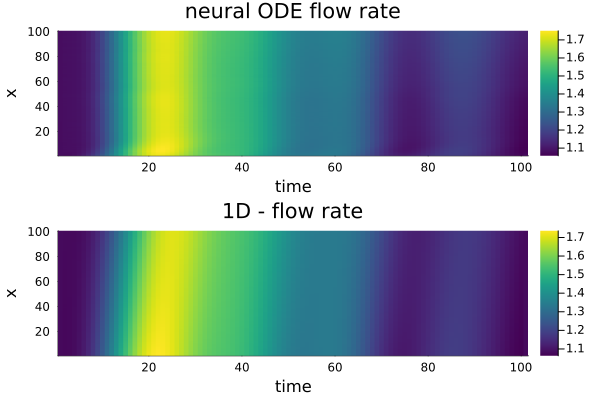

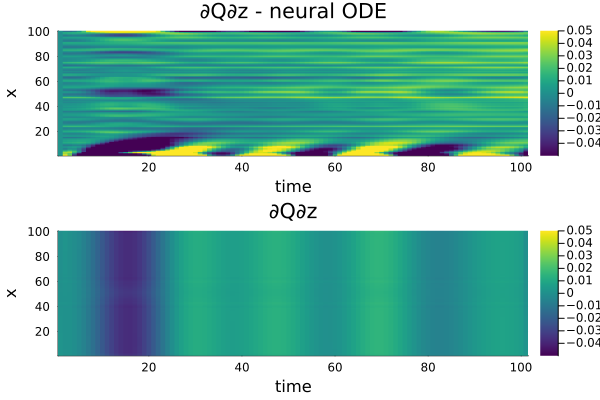

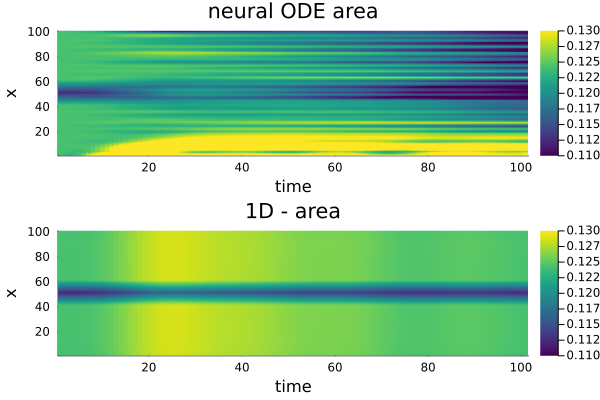

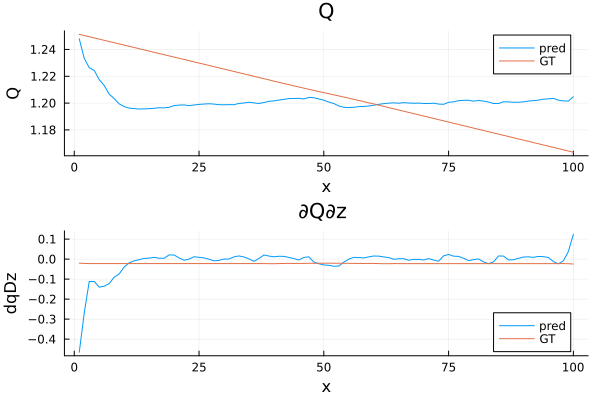

waveform batch: 3/3
Using ADAM optimizer
Sum of params:102.64645
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 1560.7032943845504
Iteration: 2 || Loss: 1560.662018039958
Iteration: 3 || Loss: 1560.6202286874948
Iteration: 4 || Loss: 1560.5783771260797
Iteration: 5 || Loss: 1560.5364340219678
Iteration: 6 || Loss: 1560.5364340219678
saving ADAM checkpoint...
Sum of params:102.64608
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 1560.5364340219678
Iteration: 2 || Loss: 1555.0954270203479
Iteration: 3 || Loss: 1543.0553165991637
Iteration: 4 || Loss: 1448.4622210753164
Iteration: 5 || Loss: 1415.4348421277007
Iteration: 6 || Loss: 1404.1254505489642
Iteration: 7 || Loss: 1373.4770438493058
Iteration: 8 || Loss: 1367.9220749377769
Iteration: 9 || Loss: 1349.752034166853
Iteration: 10 || Loss: 1338.0308742488694
Iteration: 11 || Loss: 1315.1540373075702
saving BFGS checkpoint...
saved trained params to ptrained_BFGS.jld2
Sum of params:10

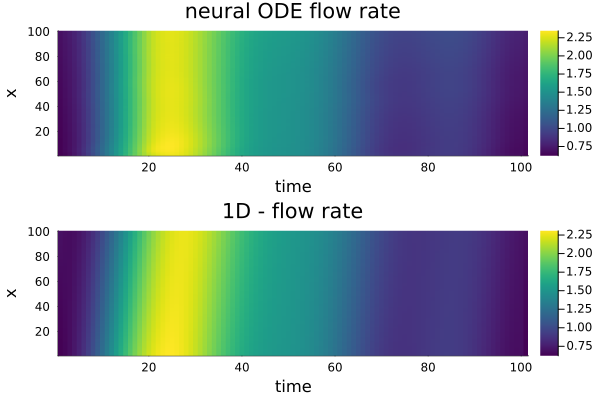

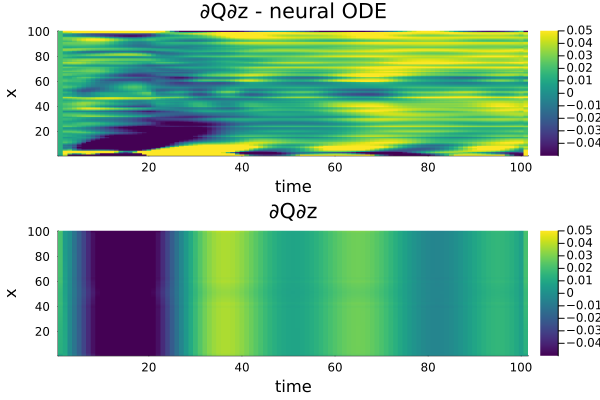

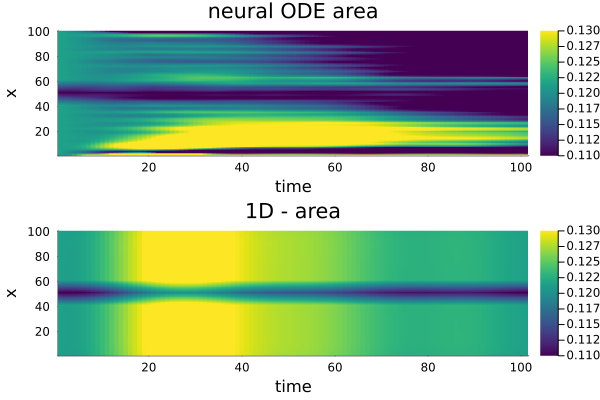

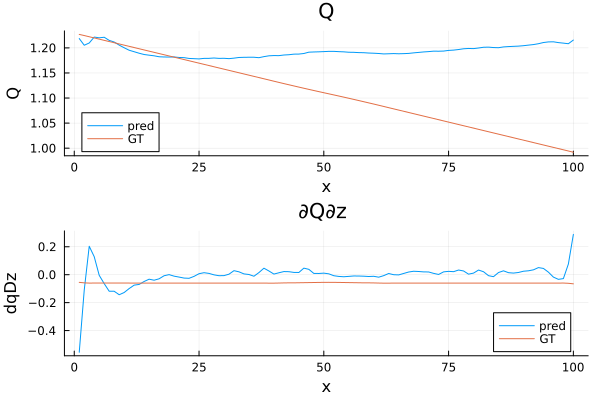

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Testing -interpolation:
waveform batch: 1/1
Test loss - interpolation:461.1240986116311


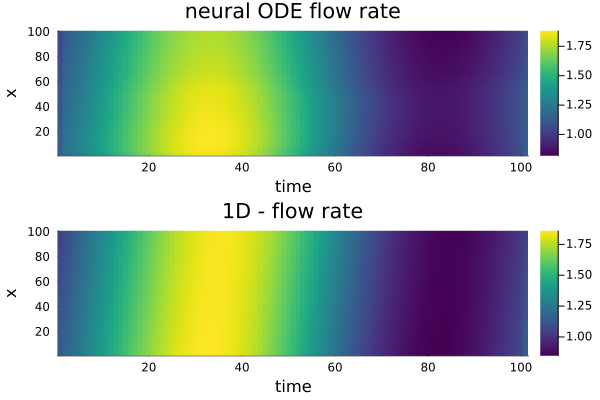

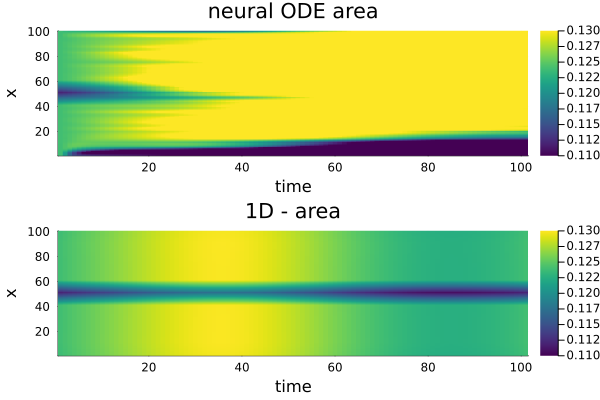

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Testing - extrapolation:
waveform batch: 1/2
Test loss - extrapolation:1308.0761023067557


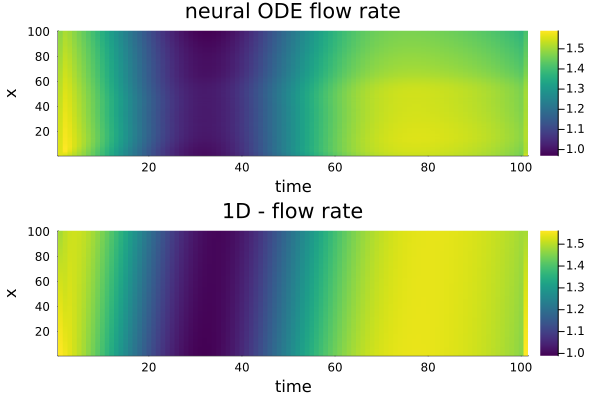

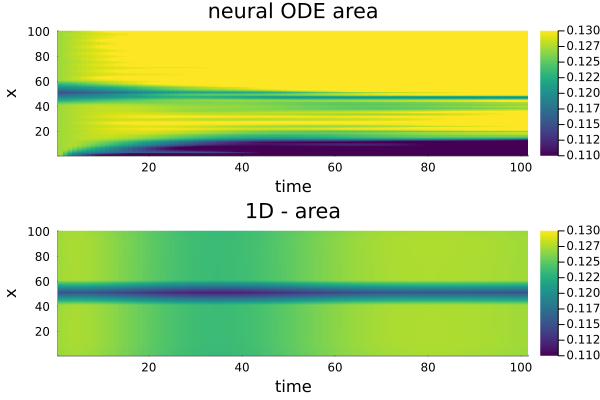

waveform batch: 2/2
Test loss - extrapolation:770.5512220770488


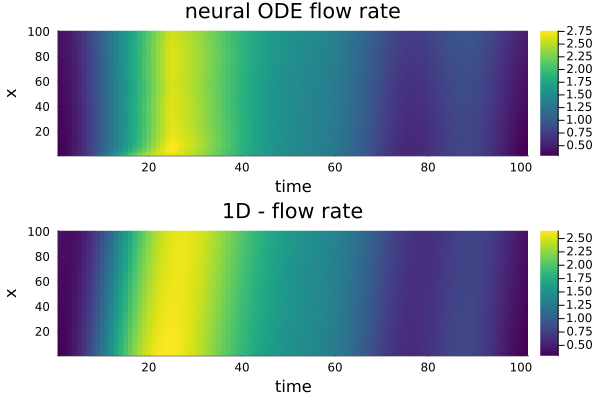

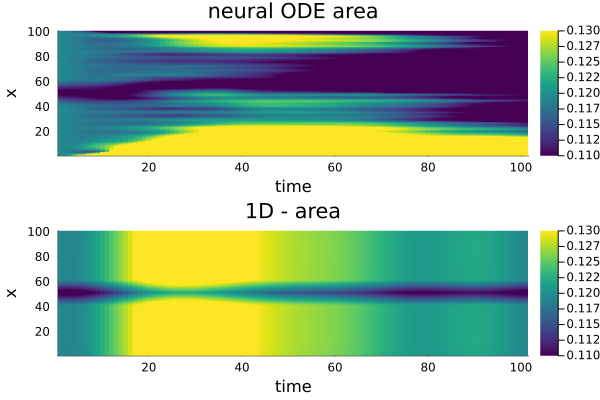

Epoch 7 mean train loss:61.22947554579991
Epoch 7 mean test loss - interpolation:76.85401643527184
Epoch 7 mean test loss - extrapolation:173.21894369865038
Start training epoch 8
waveform batch: 1/3
Using ADAM optimizer
Sum of params:104.65897
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 224.6105629234555
Iteration: 2 || Loss: 224.53824290095355
Iteration: 3 || Loss: 224.46847906421223
Iteration: 4 || Loss: 224.39511860768062
Iteration: 5 || Loss: 224.32521009800183
Iteration: 6 || Loss: 224.32521009800183
saving ADAM checkpoint...
Sum of params:104.65889
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 224.32521009800183
Iteration: 2 || Loss: 191.0470815278009
Iteration: 3 || Loss: 187.04622419012253
Iteration: 4 || Loss: 148.5254171531568
Iteration: 5 || Loss: 133.13653485481586
Iteration: 6 || Loss: 131.63401662809704
Iteration: 7 || Loss: 126.87737984513515
Iteration: 8 || Loss: 126.08412254775058
Iteration: 9 || Loss: 123.02477

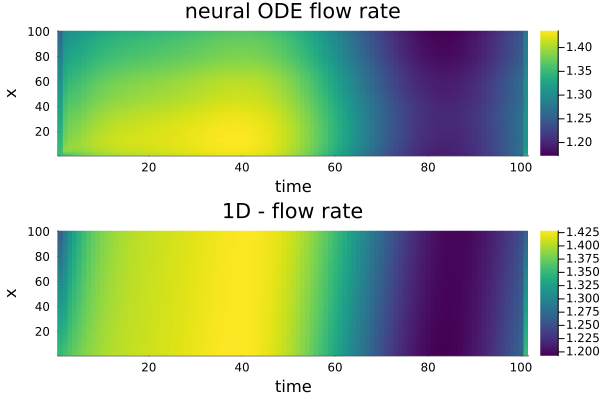

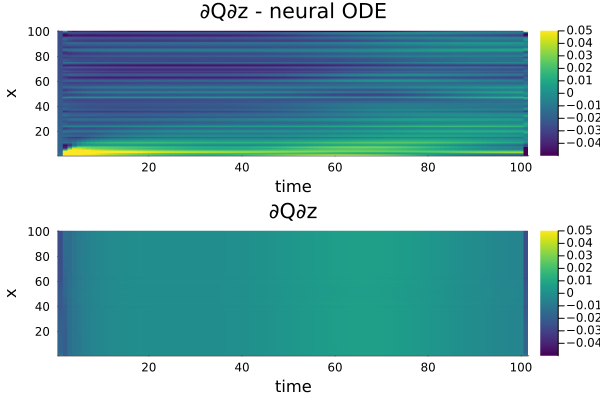

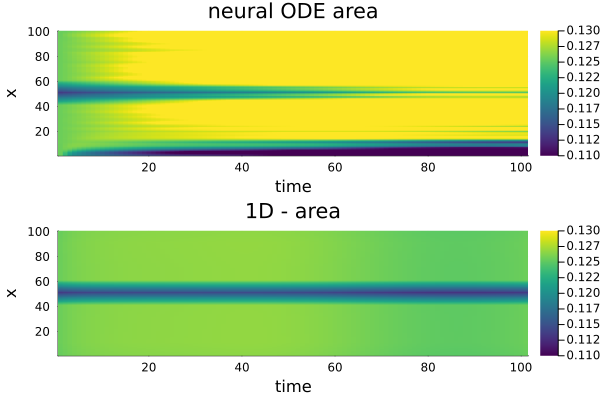

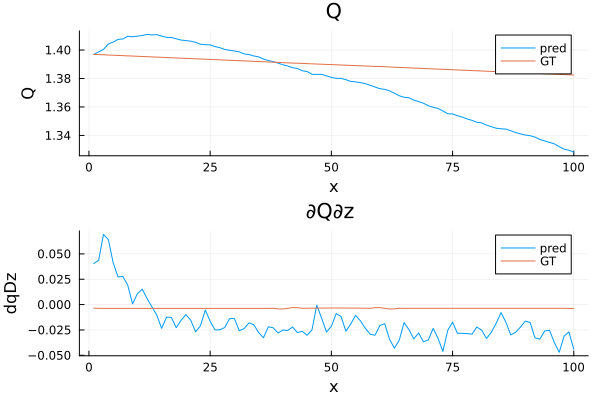

waveform batch: 2/3
Using ADAM optimizer
Sum of params:104.781624
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 441.2169428262724
Iteration: 2 || Loss: 441.1964978110467
Iteration: 3 || Loss: 441.1756189537178
Iteration: 4 || Loss: 441.15531349725734
Iteration: 5 || Loss: 441.1358594268946
Iteration: 6 || Loss: 441.1358594268946
saving ADAM checkpoint...
Sum of params:104.78048
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 441.1358594268946
Iteration: 2 || Loss: 439.9920586660929
Iteration: 3 || Loss: 437.27466899866647
Iteration: 4 || Loss: 415.569042784663
Iteration: 5 || Loss: 402.46319513012656
Iteration: 6 || Loss: 383.2317877769658
Iteration: 7 || Loss: 360.6785570738829
Iteration: 8 || Loss: 344.40042655684135
Iteration: 9 || Loss: 340.30946986988954
Iteration: 10 || Loss: 337.8206966651899
Iteration: 11 || Loss: 336.41057071296876
saving BFGS checkpoint...
saved trained params to ptrained_BFGS.jld2
Sum of params:105.04692
E

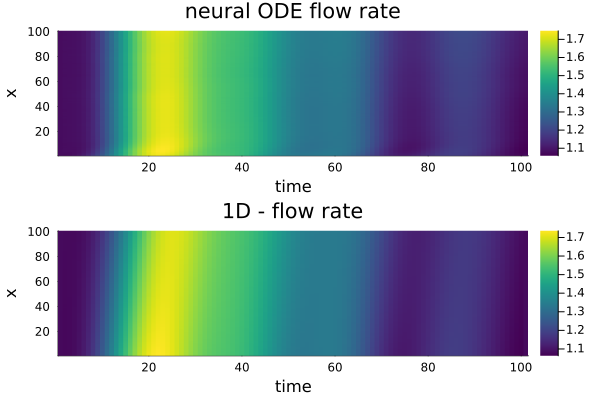

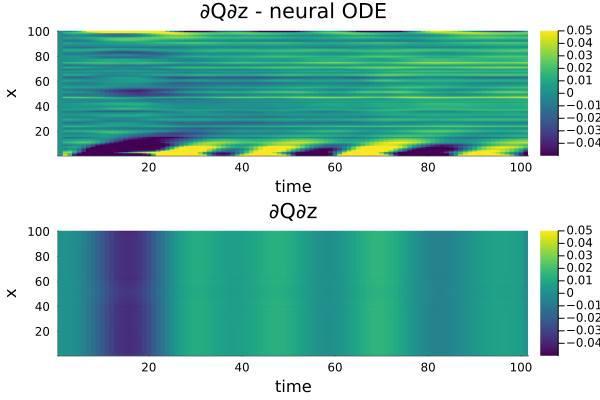

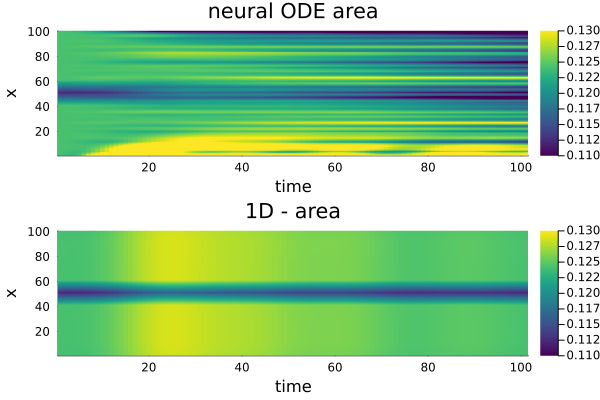

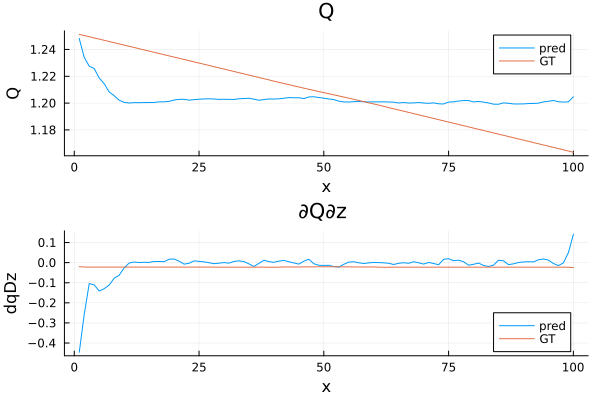

waveform batch: 3/3
Using ADAM optimizer
Sum of params:105.04692
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 1360.6100989296071
Iteration: 2 || Loss: 1360.5820904558068
Iteration: 3 || Loss: 1360.5543605291557
Iteration: 4 || Loss: 1360.5265754817563
Iteration: 5 || Loss: 1360.4992242874466
Iteration: 6 || Loss: 1360.4992242874466
saving ADAM checkpoint...
Sum of params:105.04572
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 1360.4992242874466
Iteration: 2 || Loss: 1358.2526933780034
Iteration: 3 || Loss: 1352.0595514308345
Iteration: 4 || Loss: 1301.9229418857008
Iteration: 5 || Loss: 1289.889696284019
Iteration: 6 || Loss: 1262.5173406385925
Iteration: 7 || Loss: 1249.5999258537556
Iteration: 8 || Loss: 1235.347299576598
Iteration: 9 || Loss: 1225.2490264372398
Iteration: 10 || Loss: 1205.8751166037882
Iteration: 11 || Loss: 1183.2620215051688
saving BFGS checkpoint...
saved trained params to ptrained_BFGS.jld2
Sum of params:10

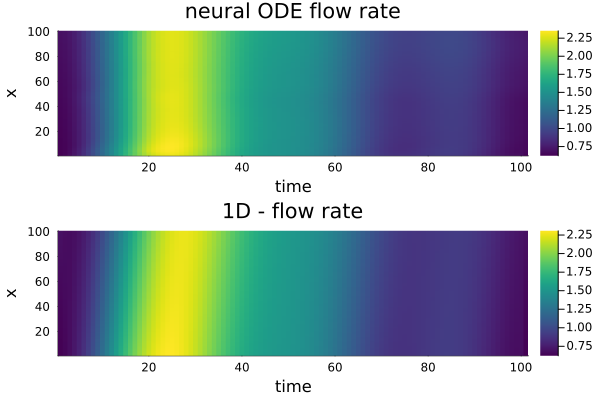

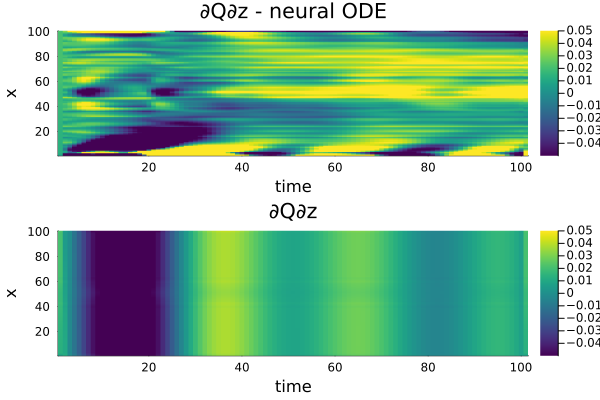

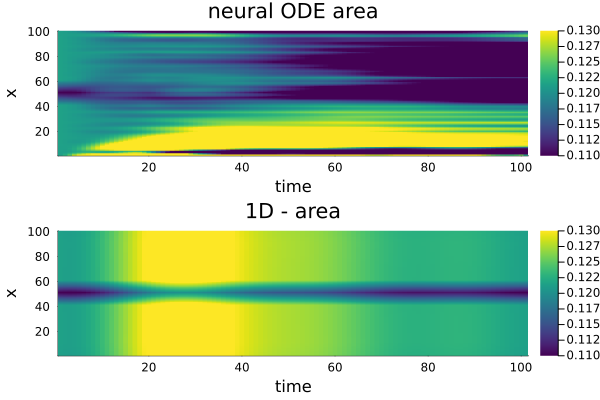

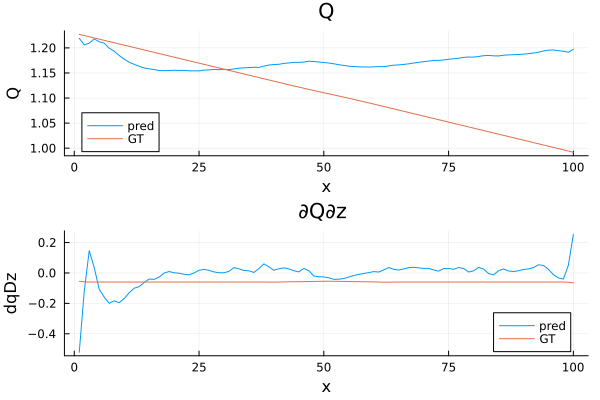

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Testing -interpolation:
waveform batch: 1/1
Test loss - interpolation:427.21680837152155


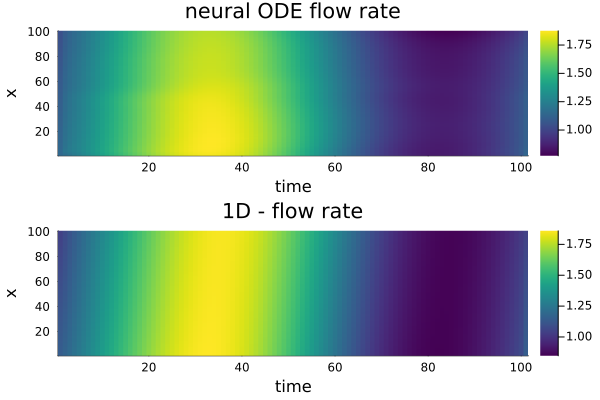

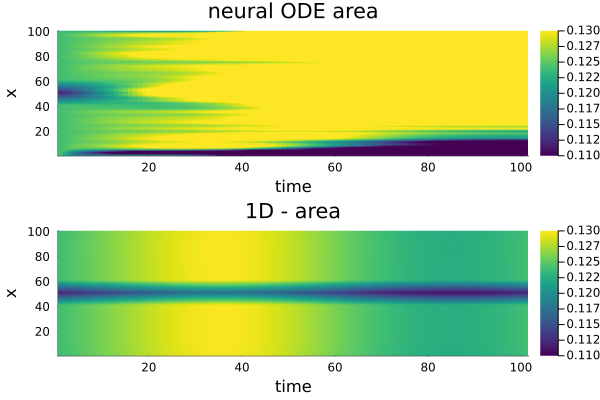

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Testing - extrapolation:
waveform batch: 1/2
Test loss - extrapolation:1261.3106965444651


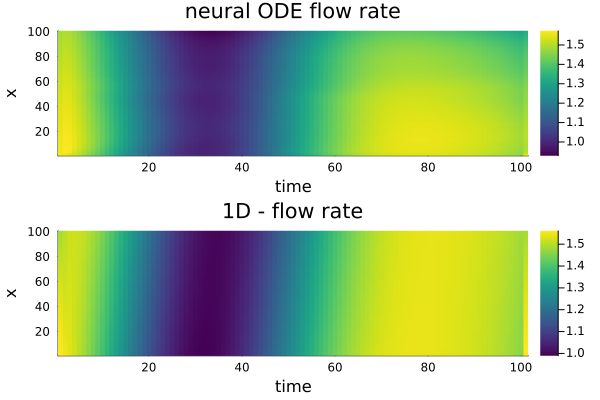

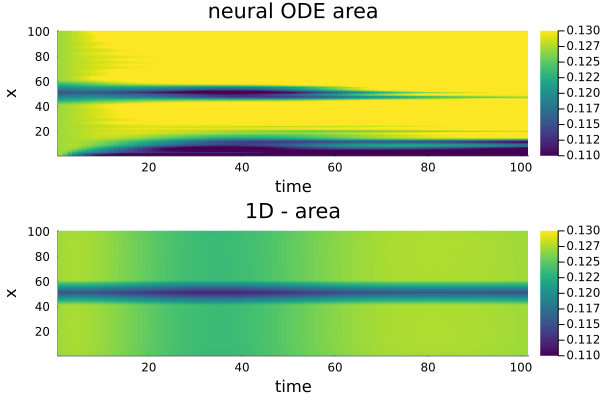

waveform batch: 2/2
Test loss - extrapolation:769.4021233769803


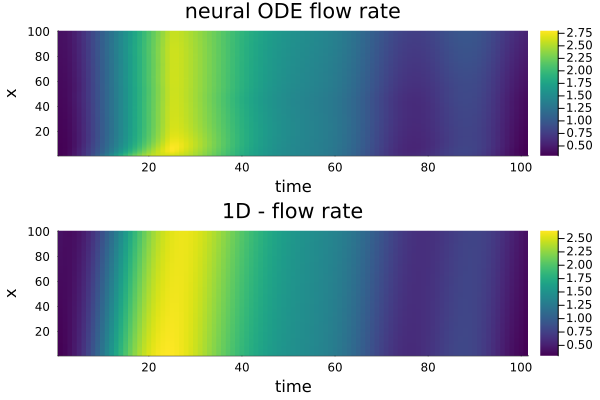

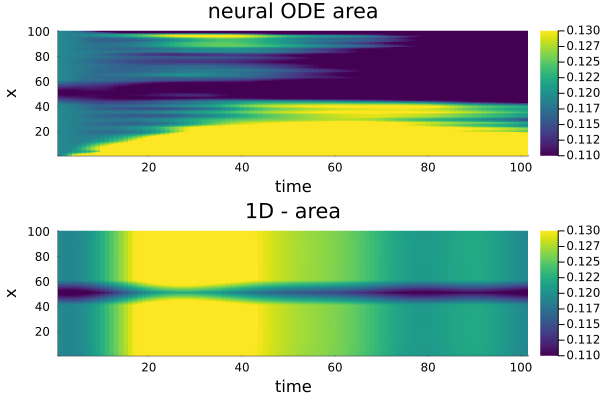

Epoch 8 mean train loss:56.51403996153748
Epoch 8 mean test loss - interpolation:71.20280139525359
Epoch 8 mean test loss - extrapolation:169.2260683267871
Start training epoch 9
Changing learning rate to:1.0000000000000002e-7
waveform batch: 1/3
Using ADAM optimizer
Sum of params:107.77388
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 373.5708388870799
Iteration: 2 || Loss: 373.5580592337391
Iteration: 3 || Loss: 373.5394891580718
Iteration: 4 || Loss: 373.52535269980854
Iteration: 5 || Loss: 373.5082592741123
Iteration: 6 || Loss: 373.5082592741123
saving ADAM checkpoint...
Sum of params:107.77396
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 373.5082592741123
Iteration: 2 || Loss: 262.8147389207226
Iteration: 3 || Loss: 198.71478050020272
Iteration: 4 || Loss: 158.78942589162924
Iteration: 5 || Loss: 152.08921605282433
Iteration: 6 || Loss: 125.39639738512464
Iteration: 7 || Loss: 124.91810403058354
Iteration: 8 || Loss: 114.370

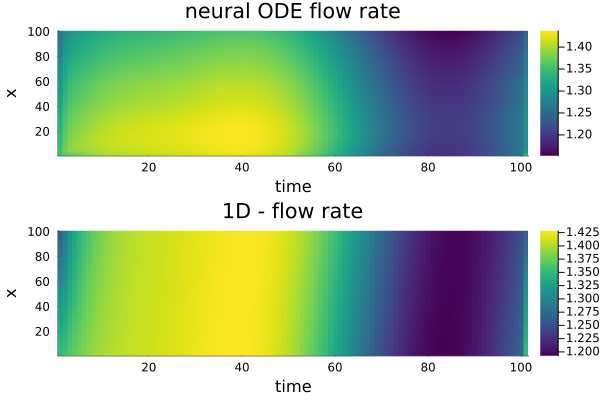

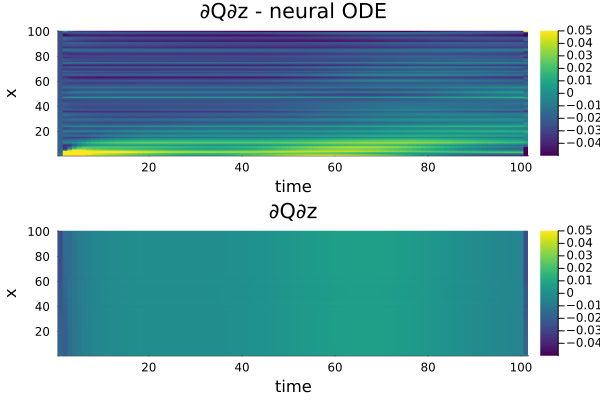

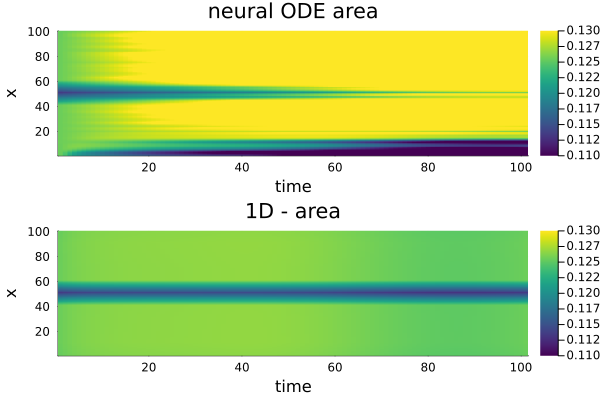

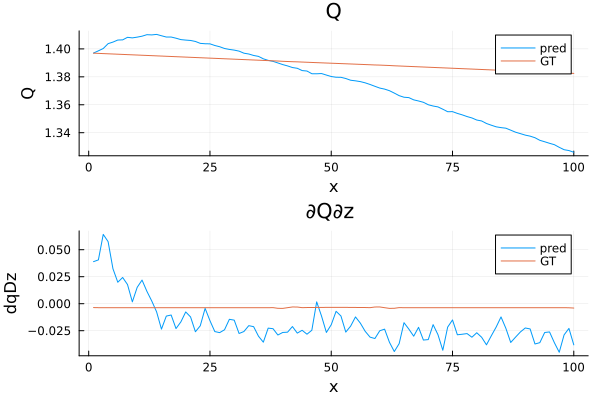

waveform batch: 2/3
Using ADAM optimizer
Sum of params:107.9398
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 386.6000329240837
Iteration: 2 || Loss: 386.59638672033964
Iteration: 3 || Loss: 386.59276767734355
Iteration: 4 || Loss: 386.5885923639378
Iteration: 5 || Loss: 386.5850993592764
Iteration: 6 || Loss: 386.5850993592764
saving ADAM checkpoint...
Sum of params:107.93968
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 386.5850993592764
Iteration: 2 || Loss: 382.11721828628066
Iteration: 3 || Loss: 379.476196709177
Iteration: 4 || Loss: 368.59512364884796
Iteration: 5 || Loss: 354.11232249413644
Iteration: 6 || Loss: 347.91229944293724
Iteration: 7 || Loss: 334.5201732458541
Iteration: 8 || Loss: 330.7720507340784
Iteration: 9 || Loss: 328.55125166547504
Iteration: 10 || Loss: 326.45349368555367
Iteration: 11 || Loss: 326.0214479584171
saving BFGS checkpoint...
saved trained params to ptrained_BFGS.jld2
Sum of params:108.10686
E

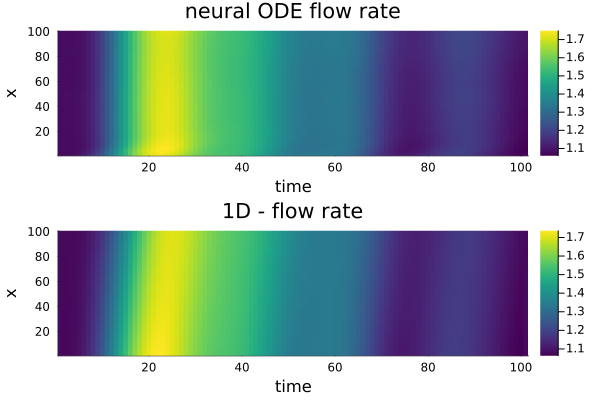

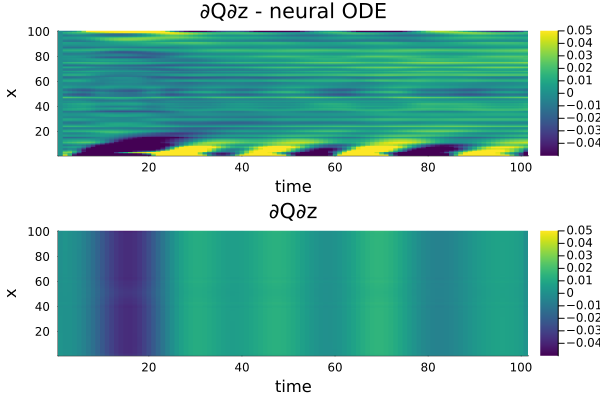

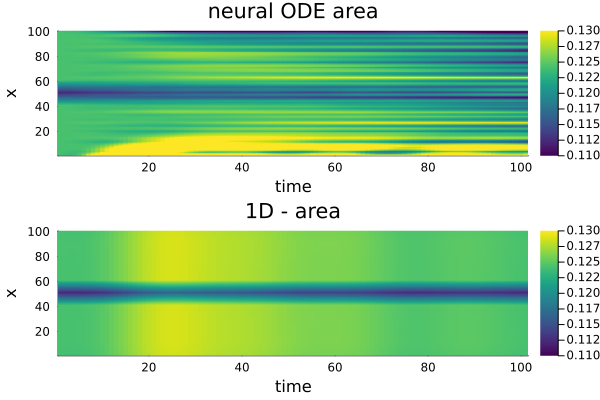

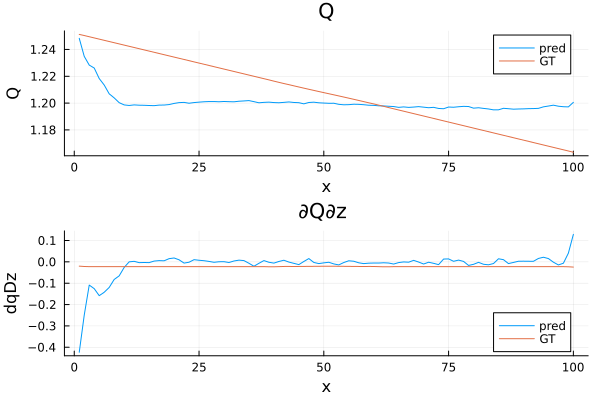

waveform batch: 3/3
Using ADAM optimizer
Sum of params:108.10686
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 1221.0746212755525
Iteration: 2 || Loss: 1221.0718730169551
Iteration: 3 || Loss: 1221.06942287168
Iteration: 4 || Loss: 1221.0667946004703
Iteration: 5 || Loss: 1221.0641255029714
Iteration: 6 || Loss: 1221.0641255029714
saving ADAM checkpoint...
Sum of params:108.10672
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 1221.0641255029714
Iteration: 2 || Loss: 1211.4116806870065
Iteration: 3 || Loss: 1208.6966098093858
Iteration: 4 || Loss: 1173.7582088455115
Iteration: 5 || Loss: 1154.1407335378824
Iteration: 6 || Loss: 1150.0193189168315
Iteration: 7 || Loss: 1132.7187197411981
Iteration: 8 || Loss: 1131.4617149135095
Iteration: 9 || Loss: 1122.354399369298
Iteration: 10 || Loss: 1120.3818974621372
Iteration: 11 || Loss: 1106.6532019451
saving BFGS checkpoint...
saved trained params to ptrained_BFGS.jld2
Sum of params:109.44

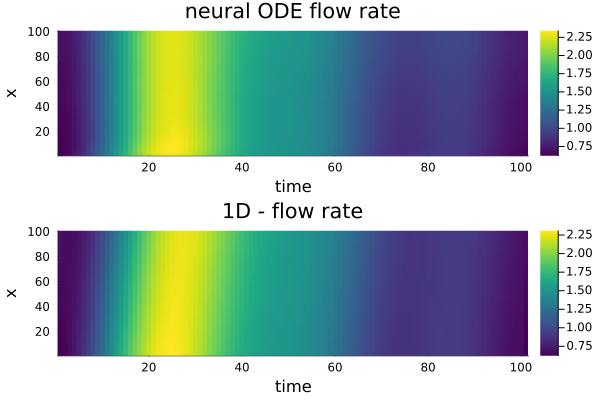

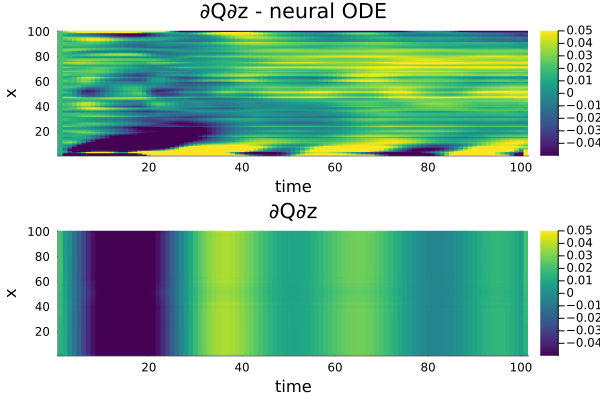

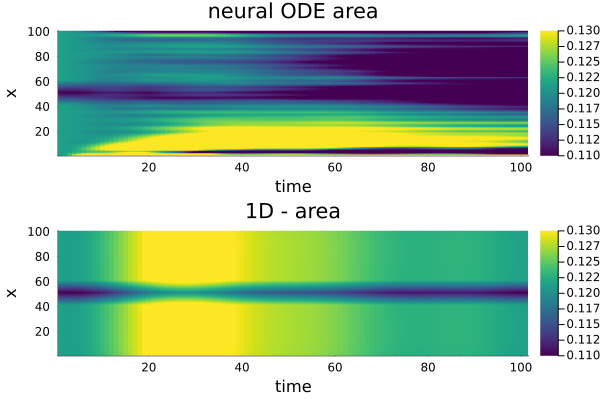

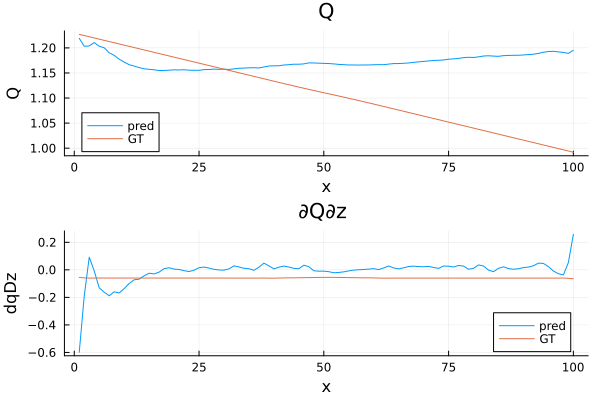

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Testing -interpolation:
waveform batch: 1/1
Test loss - interpolation:389.51089780622505


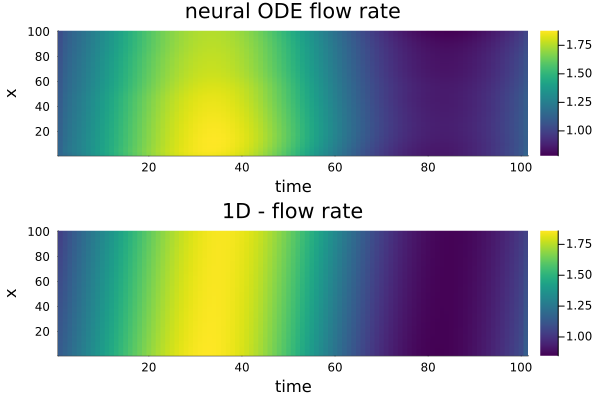

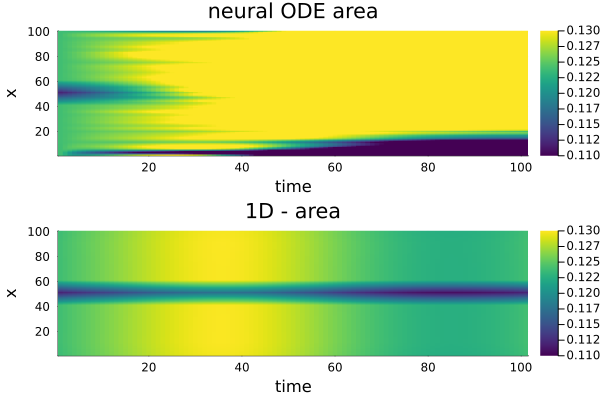

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Testing - extrapolation:
waveform batch: 1/2
Test loss - extrapolation:1145.233265428745


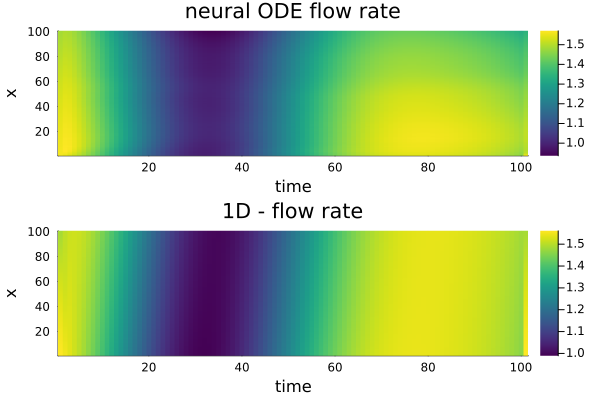

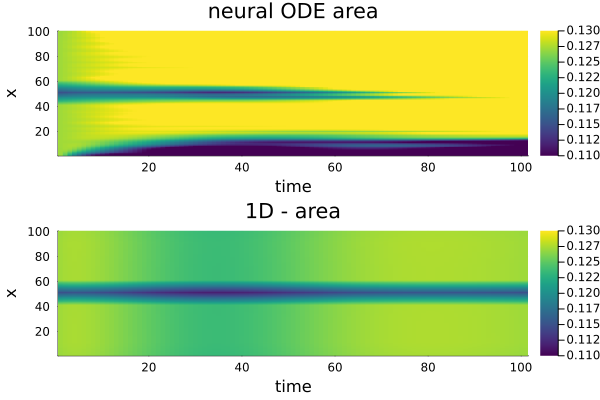

waveform batch: 2/2
Test loss - extrapolation:682.9565241224507


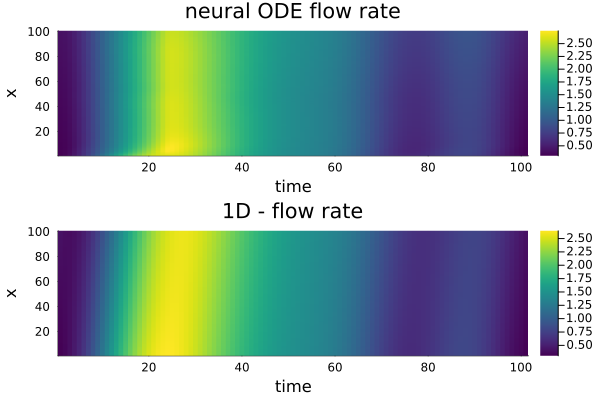

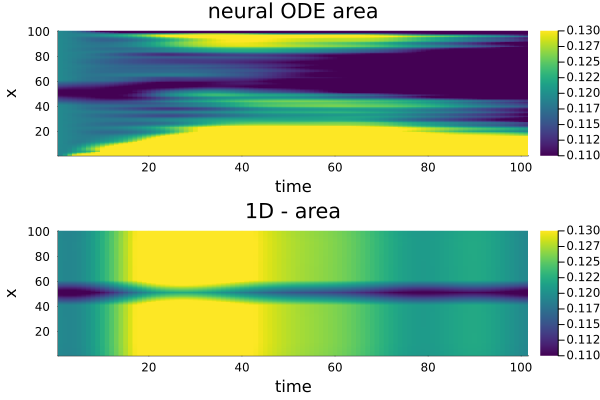

Epoch 9 mean train loss:53.21081324510287
Epoch 9 mean test loss - interpolation:64.91848296770418
Epoch 9 mean test loss - extrapolation:152.3491491292663
Start training epoch 10
waveform batch: 1/3
Using ADAM optimizer
Sum of params:109.44711
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 312.77055288687444
Iteration: 2 || Loss: 312.75712939101635
Iteration: 3 || Loss: 312.7440995153763
Iteration: 4 || Loss: 312.7318467108006
Iteration: 5 || Loss: 312.7192361243029
Iteration: 6 || Loss: 312.7192361243029
saving ADAM checkpoint...
Sum of params:109.44718
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 312.7192361243029
Iteration: 2 || Loss: 248.23114062076039
Iteration: 3 || Loss: 207.16377939665614
Iteration: 4 || Loss: 155.18553695453758
Iteration: 5 || Loss: 142.87976884062223
Iteration: 6 || Loss: 113.6708669934641
Iteration: 7 || Loss: 113.08734113441349
Iteration: 8 || Loss: 108.51813622931797
Iteration: 9 || Loss: 106.54495040

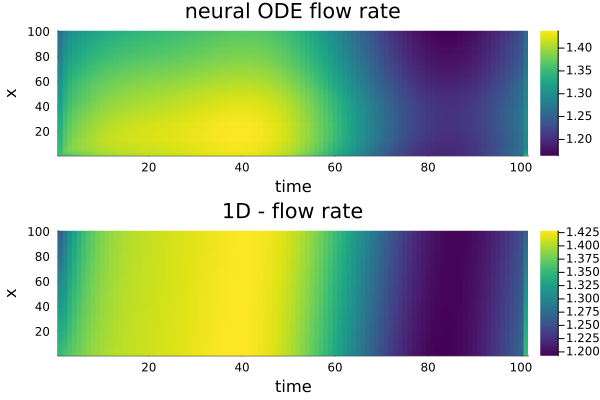

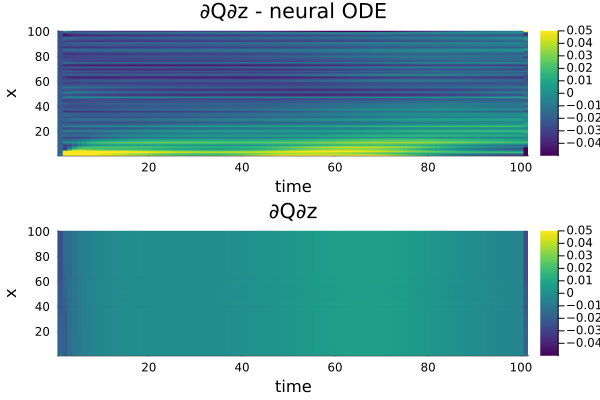

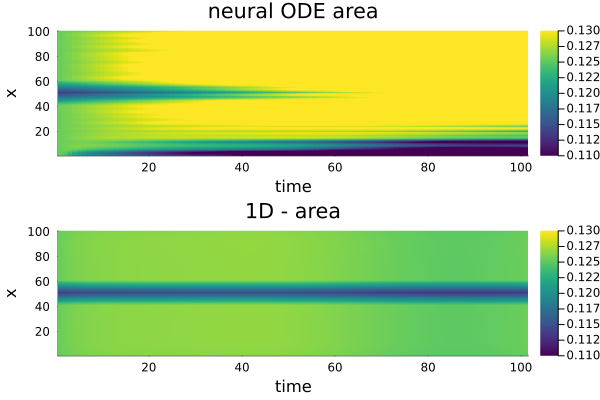

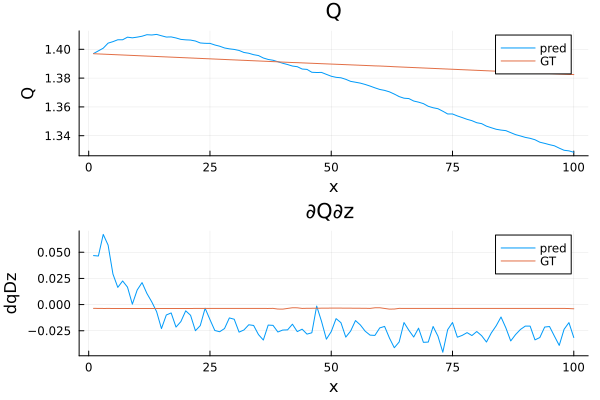

waveform batch: 2/3
Using ADAM optimizer
Sum of params:109.55722
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 353.3723897857057
Iteration: 2 || Loss: 353.36980077731477
Iteration: 3 || Loss: 353.3673798274608
Iteration: 4 || Loss: 353.36471298025265
Iteration: 5 || Loss: 353.3613065617424
Iteration: 6 || Loss: 353.3613065617424
saving ADAM checkpoint...
Sum of params:109.557144
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 353.3613065617424
Iteration: 2 || Loss: 351.3046621634312
Iteration: 3 || Loss: 349.60520526287416
Iteration: 4 || Loss: 335.0422544386932
Iteration: 5 || Loss: 332.0718218468471
Iteration: 6 || Loss: 323.2966491760978
Iteration: 7 || Loss: 321.6797014201
Iteration: 8 || Loss: 319.44388975547156
Iteration: 9 || Loss: 318.84336694432807
Iteration: 10 || Loss: 317.0580646471595
Iteration: 11 || Loss: 316.25077645302565
saving BFGS checkpoint...
saved trained params to ptrained_BFGS.jld2
Sum of params:109.57911
Epo

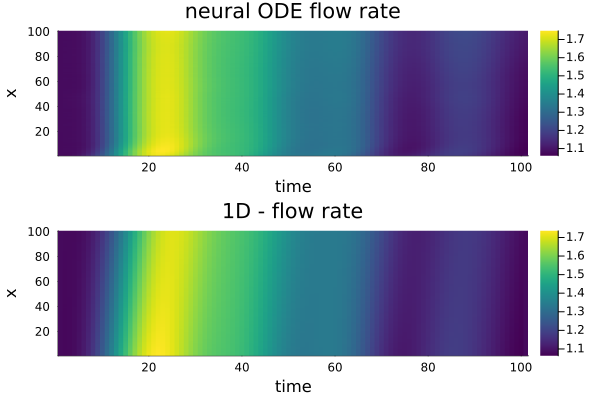

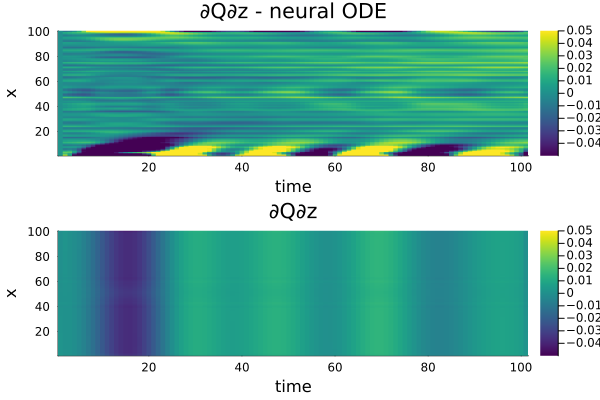

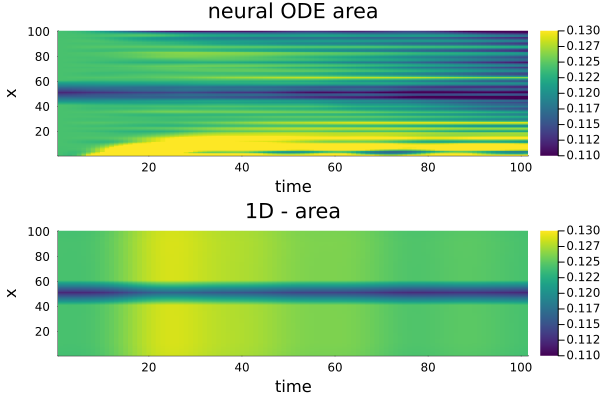

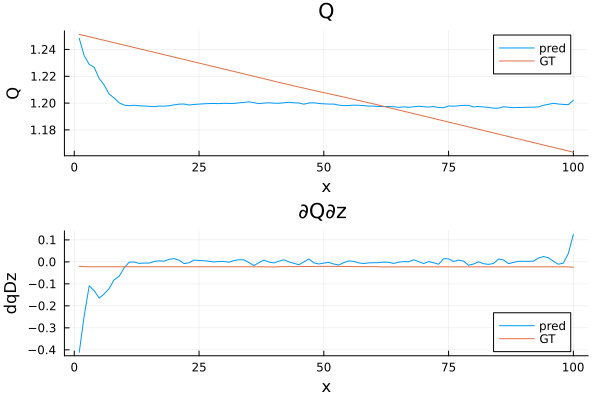

waveform batch: 3/3
Using ADAM optimizer
Sum of params:109.57911
Max iters:5
Choosing ADAM Optimizer.
Iteration: 1 || Loss: 1148.7253346087414
Iteration: 2 || Loss: 1148.722571506375
Iteration: 3 || Loss: 1148.7187103936678
Iteration: 4 || Loss: 1148.7160878683958
Iteration: 5 || Loss: 1148.7127115433864
Iteration: 6 || Loss: 1148.7127115433864
saving ADAM checkpoint...
Sum of params:109.57898
Switching to BFGS optimizer
Max iters:10
Choosing BFGS Optimizer.
Iteration: 1 || Loss: 1148.7127115433864
Iteration: 2 || Loss: 1145.8941651637772
Iteration: 3 || Loss: 1141.0346247063192
Iteration: 4 || Loss: 1112.7883171530243
Iteration: 5 || Loss: 1097.9997429045713
Iteration: 6 || Loss: 1091.3820797526714
Iteration: 7 || Loss: 1083.5686557698548
Iteration: 8 || Loss: 1073.7389911945736
Iteration: 9 || Loss: 1069.2709898869612
Iteration: 10 || Loss: 1054.8276402609977
Iteration: 11 || Loss: 1021.7402912897707
saving BFGS checkpoint...
saved trained params to ptrained_BFGS.jld2
Sum of params:1

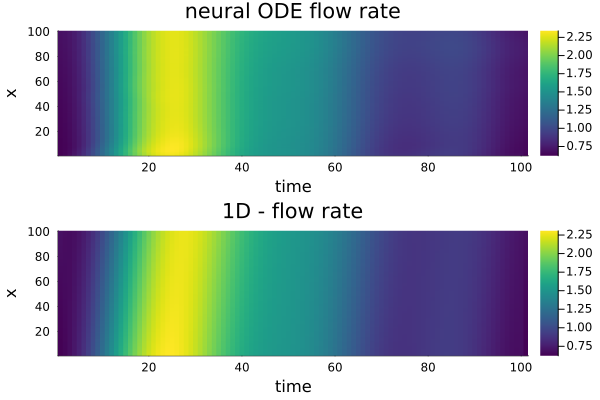

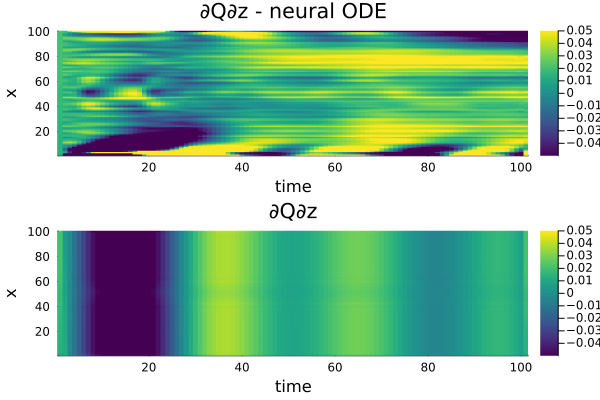

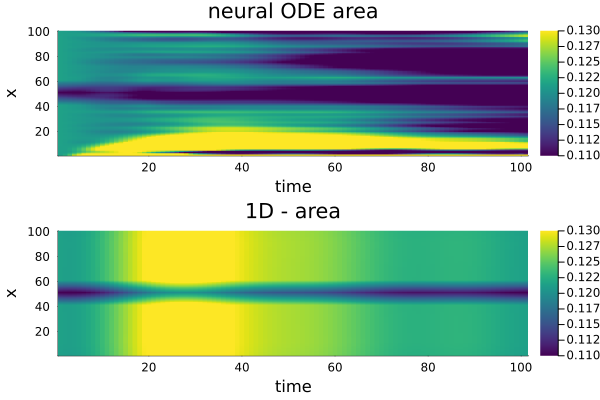

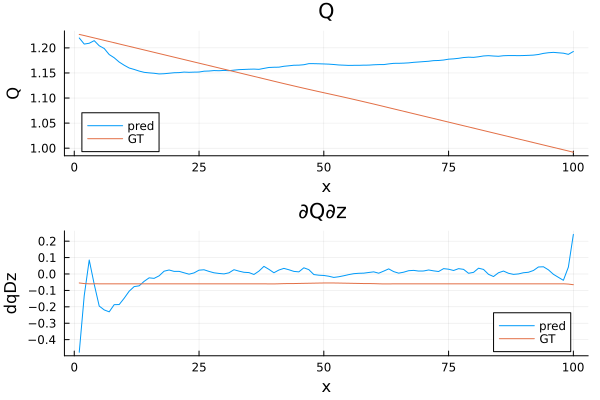

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Testing -interpolation:
waveform batch: 1/1
Test loss - interpolation:416.34379452119515


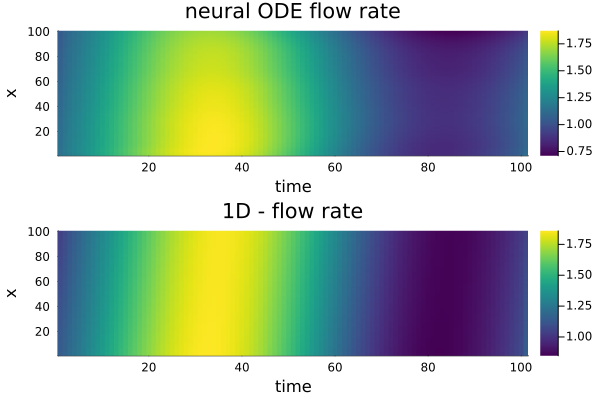

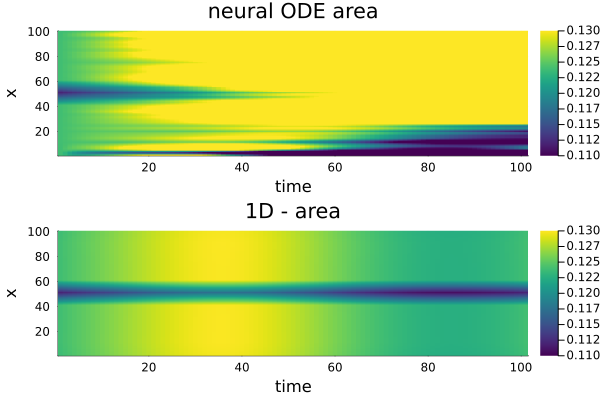

%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Testing - extrapolation:
waveform batch: 1/2
Test loss - extrapolation:1196.4058623194433


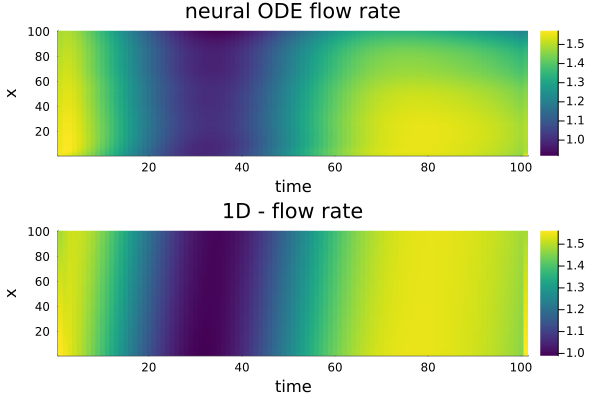

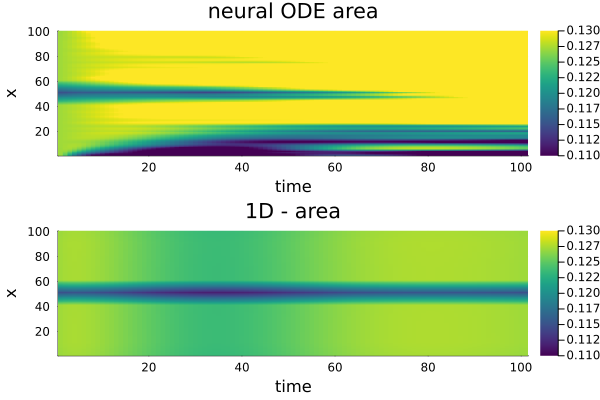

waveform batch: 2/2
Test loss - extrapolation:663.0755192827781


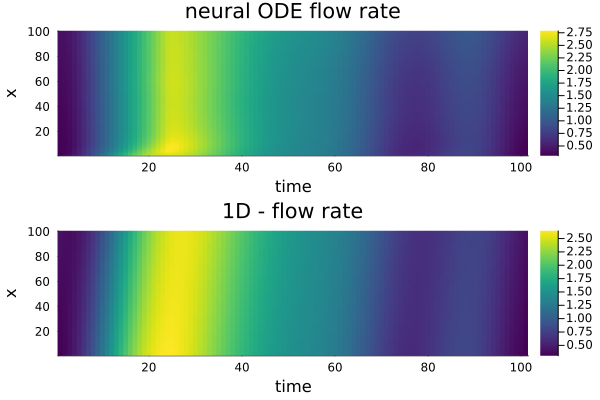

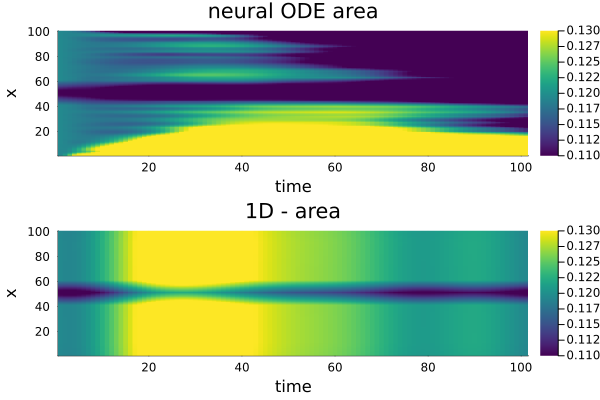

Epoch 10 mean train loss:49.71661009659485
Epoch 10 mean test loss - interpolation:69.3906324201992
Epoch 10 mean test loss - extrapolation:154.95678180018513


In [55]:
n_epochs = 10

#set batch size
batch_size = 10
println("Batch size:", batch_size)
#training batches
batch_iterations = Int(ceil(size(ytrain2,3)/batch_size))
#testing batches
test_batch_iterations = Int(ceil(size(ytest2,3)/batch_size));
ex_batch_iterations = Int(ceil(size(yex2,3)/batch_size));


list_loss_train = []
list_loss_epoch = []
list_loss_test = []
list_loss_epoch_test = []
list_loss_ex = []
list_loss_epoch_ex = []
# epochs loop
alpha = 0.0
learning_rate = 1e-4
for j in 1:n_epochs
    println("Start training epoch ",j)
    loss_tot = 0.0
    loss_tot_test = 0.0
    loss_tot_ex = 0.0
    # Change learning rate for ADAM optimizer, BFGS doesn't use it
    if j % 3 == 0 && learning_rate > 1e-6
        global learning_rate = learning_rate*0.1
        println("Changing learning rate to:",learning_rate)
    end
    
#     if j!=1 && alpha < 1.0
#        alpha = alpha+0.1 
#     end
        # loop over different waveforms
        for i in 1:batch_iterations

            println("waveform batch: ",i, "/",batch_iterations)



            flush(stdout)
            #reorder ytrain, atrain and dAdz to [space, batch_size, time]
            # batch size should be second column
            if i!=batch_iterations
                ytrain = permutedims(ytrain2[:,:,batch_size*(i-1)+1:batch_size*i],(2,3,1))
                atrain = permutedims(Atrain[:,:,batch_size*(i-1)+1:batch_size*i],(2,3,1))
                #define boundary condition for the current batch
                bctrain = bc_flow[:,batch_size*(i-1)+1:batch_size*i]

                #reorder pressure values as well
                prestrain = permutedims(ptrain[:,:,batch_size*(i-1)+1:batch_size*i],(2,3,1))
            else
                ytrain = permutedims(ytrain2[:,:,batch_size*(i-1)+1:end],(2,3,1))
                atrain = permutedims(Atrain[:,:,batch_size*(i-1)+1:end],(2,3,1))

                    #define boundary condition for the current batch
                bctrain = bc_flow[:,batch_size*(i-1)+1:end]

                    #reorder pressure values as well
                prestrain = permutedims(ptrain[:,:,batch_size*(i-1)+1:end],(2,3,1))
            end

            #define function for interpolating area to the actual time location for the ODE
            interp_func(t) = interpolate_variables(t, atrain)
            p_interp_func(t) = interpolate_variables(t, prestrain)
            
        
            #define optimization problem
            prob = ODEProblem((u, p, t, S) -> learn_1DBlood(u, p, t, S, p_interp_func), ytrain[:,:,1], tspan, p);
            
            optf = Optimization.OptimizationFunction((x,p)->loss(x,ytrain[:,:,:],prob, bctrain,atrain),adtype) ;

            println("Using $optimizer_choice1 optimizer")
            println("Sum of params:", sum(uinit))



            uinit = train_loop(uinit,adtype,optf,train_maxiters,learning_rate,optimizer_choice1)
            println("Sum of params:", sum(uinit))

            if !isnothing(optimizer_choice2)
                println("Switching to $optimizer_choice2 optimizer")

                uinit = train_loop(uinit,adtype,optf,train_maxiters*2,learning_rate,optimizer_choice2)

                println("Sum of params:", sum(uinit))

            end
        
            #calculate final loss and push it to the list
            prob = ODEProblem((u, p, t, S) -> learn_1DBlood(u, p, t, S,p_interp_func), ytrain[:,:,1], tspan, p);
            l, pred = loss(uinit,ytrain[:,:,:],prob,bctrain,atrain)
            loss_tot = loss_tot + l

            push!(list_loss_train, l)
            println("Epoch ", j, " loss:", l)
        
        
            # Initialize the resulting matrix
            pred_matrix = zero(ytrain)
            pred_S_matrix = zero(atrain)
        
            # Restructure the matrices into the result matrix
            for i in 1:Int(length(pred)/2)
                pred_matrix[:, :, i] = pred[2*i-1]
                pred_S_matrix[:,:,i] = pred[2*i]
            end

            println("MSE loss S", sum(abs2,pred_S_matrix-atrain))
         
            # plot solution for comparison
            plot1 = heatmap(pred_matrix[:,1,:], color=:viridis, title = "neural ODE flow rate")
            xlabel!("time")
            ylabel!("x")

            plot2 = heatmap(ytrain[:,1,:], title="1D - flow rate", color=:viridis)
            xlabel!("time")
            ylabel!("x")
        
            display(plot(plot1,plot2,layout = (2, 1)))
            sleep(1)
        
        
            plot5 = heatmap(∂x1 * pred_matrix[:,1,:], color=:viridis, title = "∂Q∂z - neural ODE", clims = (-0.05,0.05))
            xlabel!("time")
            ylabel!("x")

            plot6 = heatmap(∂x1 * ytrain[:,1,:], title="∂Q∂z", color=:viridis, clims = (-0.05,0.05))
            xlabel!("time")
            ylabel!("x")
        
        
            display(plot(plot5,plot6,layout = (2, 1)))
            sleep(1)        
        
    
            plot3 = heatmap(pred_S_matrix[:,1,:], color=:viridis, title = "neural ODE area", clims = (0.11,0.13))
            xlabel!("time")
            ylabel!("x")

            plot4 = heatmap(atrain[:,1,:], title="1D - area", color=:viridis,clims = (0.11,0.13))
            xlabel!("time")
            ylabel!("x")
        
        
            display(plot(plot3,plot4,layout = (2, 1)))
            sleep(1)
        
        
            plot7 = plot([pred_matrix[:,1,10], ytrain[:,1,10]], title = "Q", label = ["pred" "GT"])
            xlabel!("x")
            ylabel!("Q")
            
            dQdz = ∂x1 * ytrain[:,1,:]
            dQdz_pred = ∂x1 * pred_matrix[:,1,:]
        
#             println("size dQdz_pred:", size(dQdz_pred))
#             println("dQdz difference:", dQdz_pred[:,10] - dQdz[:,10])
            plot8 = plot([dQdz_pred[:,10], dQdz[:,10]], title = "∂Q∂z ", label = ["pred" "GT"])
            xlabel!("x")
            ylabel!("dqDz")
        
            display(plot(plot7, plot8, layout = (2, 1)))
            sleep(1) 
            
        end
    
    
        #testing loop
        println("%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%")
        println("Testing -interpolation:")

        for i in 1:test_batch_iterations

            println("waveform batch: ",i, "/",test_batch_iterations)

            #reorder ytrain to (spatial location, batch_size, time)
            if i!=test_batch_iterations
                ytest = permutedims(ytest2[:,:,batch_size*(i-1)+1:batch_size*i],(2,3,1))
                atest = permutedims(Atest[:,:,batch_size*(i-1)+1:batch_size*i],(2,3,1))
                bctest = bc_flow_test[:,batch_size*(i-1)+1:batch_size*i]
                prestest = permutedims(ptest[:,:,batch_size*(i-1)+1:batch_size*i],(2,3,1))
            else
                ytest = permutedims(ytest2[:,:,batch_size*(i-1)+1:end],(2,3,1))
                atest = permutedims(Atest[:,:,batch_size*(i-1)+1:end],(2,3,1))
                bctest = bc_flow_test[:,batch_size*(i-1)+1:end]
                prestest = permutedims(ptest[:,:,batch_size*(i-1)+1:end],(2,3,1))
            end
            

            #define function for interpolating area and dA/dz to the actual spatial location for the ODE
            interp_func(t) = interpolate_variables(t, atest)
            p_interp_func(t) = interpolate_variables(t, prestest)

            #calculate final loss and push it to the list
            prob = ODEProblem((u, p, t, S) -> learn_1DBlood(u, p, t, S, p_interp_func), ytest[:,:,1], tspan, p);
            l, pred = loss(uinit,ytest[:,:,:],prob,bctest,atest)
            loss_tot_test = loss_tot_test + l

            push!(list_loss_test, l)
            println("Test loss - interpolation:",l )
        
            # Initialize the resulting matrix
            pred_matrix = zero(ytest)
            pred_S_matrix = zero(atest)
        
            # Restructure the matrices into the result matrix
            # Restructure the matrices into the result matrix
            for i in 1:Int(length(pred)/2)
                pred_matrix[:, :, i] = pred[2*i-1]
                pred_S_matrix[:,:,i] = pred[2*i]
            end
        

            #plot solution for comparison
            plot1 = heatmap(pred_matrix[:,1,:], color=:viridis, title = "neural ODE flow rate")
            xlabel!("time")
            ylabel!("x")

            plot2 = heatmap(ytest[:,1,:], title="1D - flow rate", color=:viridis)
            xlabel!("time")
            ylabel!("x")
            display(plot(plot1,plot2,layout = (2, 1)))
            sleep(1)
        
        
            plot3 = heatmap(pred_S_matrix[:,1,:], color=:viridis, title = "neural ODE area", clims = (0.11,0.13))
            xlabel!("time")
            ylabel!("x")

            plot4 = heatmap(atest[:,1,:], title="1D - area", color=:viridis,clims = (0.11,0.13))
            xlabel!("time")
            ylabel!("x")
        
        
            display(plot(plot3,plot4,layout = (2, 1)))
            sleep(1)
        end
    
    
        #testing loop - extrapolation
        println("%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%")
        println("Testing - extrapolation:")

        for i in 1:ex_batch_iterations

            println("waveform batch: ",i, "/",ex_batch_iterations)

            #reorder ytrain to (spatial location, batch_size, time)
            if i!=ex_batch_iterations
                yex = permutedims(yex2[:,:,batch_size*(i-1)+1:batch_size*i],(2,3,1))
                aex = permutedims(Aex[:,:,batch_size*(i-1)+1:batch_size*i],(2,3,1))
                bcex = bc_flow_ex[:,batch_size*(i-1)+1:batch_size*i]
                presex = permutedims(pex[:,:,batch_size*(i-1)+1:batch_size*i],(2,3,1))
            else
                yex = permutedims(yex2[:,:,batch_size*(i-1)+1:end],(2,3,1))
                aex = permutedims(Aex[:,:,batch_size*(i-1)+1:end],(2,3,1))
                bcex = bc_flow_ex[:,batch_size*(i-1)+1:end]
                presex = permutedims(pex[:,:,batch_size*(i-1)+1:end],(2,3,1))
            end
            

            #define function for interpolating area and dA/dz to the actual spatial location for the ODE
            interp_func(t) = interpolate_variables(t, aex)
            p_interp_func(t) = interpolate_variables(t, presex)

            #calculate final loss and push it to the list
            prob = ODEProblem((u, p, t, S) -> learn_1DBlood(u, p, t, S, p_interp_func), yex[:,:,1], tspan, p);
            l, pred = loss(uinit,yex[:,:,:],prob,bcex,aex)
            loss_tot_ex = loss_tot_ex + l

            push!(list_loss_ex, l)
            println("Test loss - extrapolation:",l )
        
            # Initialize the resulting matrix
            pred_matrix = zero(yex)
            pred_S_matrix = zero(aex)

            # Restructure the matrices into the result matrix
            for i in 1:Int(length(pred)/2)
                pred_matrix[:, :, i] = pred[2*i-1]
                pred_S_matrix[:,:,i] = pred[2*i]
            end
        

            #plot solution for comparison
            plot1 = heatmap(pred_matrix[:,1,:], color=:viridis, title = "neural ODE flow rate")
            xlabel!("time")
            ylabel!("x")

            plot2 = heatmap(yex[:,1,:], title="1D - flow rate", color=:viridis)
            xlabel!("time")
            ylabel!("x")
            display(plot(plot1,plot2,layout = (2, 1)))
            sleep(1)
        
        
            plot3 = heatmap(pred_S_matrix[:,1,:], color=:viridis, title = "neural ODE area", clims = (0.11,0.13))
            xlabel!("time")
            ylabel!("x")

            plot4 = heatmap(aex[:,1,:], title="1D - area", color=:viridis,clims = (0.11,0.13))
            xlabel!("time")
            ylabel!("x")
        
        
            display(plot(plot3,plot4,layout = (2, 1)))
            sleep(1)
        end



push!(list_loss_epoch, loss_tot/(size(ytrain2,3)))
push!(list_loss_epoch_test, loss_tot_test/(size(ytest2,3)))
push!(list_loss_epoch_ex, loss_tot_ex/(size(yex2,3)))
println("Epoch ", j, " mean train loss:", loss_tot/(size(ytrain2,3)))
println("Epoch ", j, " mean test loss - interpolation:", loss_tot_test/(size(ytest2,3)))
println("Epoch ", j, " mean test loss - extrapolation:", loss_tot_ex/(size(yex2,3)))
    
end


In [ ]:
# plot loss as a function of epochs
p3 = plot([list_loss_epoch,list_loss_epoch_test, list_loss_epoch_ex], yaxis=:log, label = ["train" "interpolation" "extrapolation"])
ylabel!("loss")
xlabel!("epochs")
png("dQdt_1DBlood_loss.png")
display(p3)

In [ ]:
# write loss to CSV file
df = DataFrame([list_loss_epoch,list_loss_epoch_test, list_loss_epoch_ex], ["train", "interpolation", "extrapolation"])
CSV.write("output.csv", df, writeheader=true)